#Skin Lesion Classification with Deep Learning

In this notebook we will train Image Classification models on the provided multi-class dataset

The dataset contains: 


*   Training set: 5000 images
*   Validation set:  images







• Mount Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


 • Tensorboard

In [ ]:
from torch.utils.tensorboard import SummaryWriter

* Check GPU type

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Jan 16 17:55:45 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **Libraries**



In this section we import the packages and libraries for future use

In [ ]:
!pip install opencv-python-headless==4.5.2.52

!pip install git+https://github.com/albumentations-team/albumentations

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 27.4 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.7.0.68
    Uninstalling opencv-python-headless-4.7.0.68:
      Successfully uninstalled opencv-python-headless-4.7.0.68
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/albumentations-team/albumentations to /tmp/pip-req-build-8pu45if7
  Running command git clone --filter=blob:none --quiet https://github.com/albumentations-team/albumentations /tmp/pip-req-build-8pu45if7
  Resolved https://github.com/albumentations-team/albumentations to commit 2a1826d49c9442ae28cf33ddef658c8e24505cf8
  Preparing metadata (setup.py) ... done
  Created wheel for albumentations: filename=albumentations-1.3.0-py3-none-any.whl size=124568 sha256=c3916

In [ ]:
# General
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image, ImageOps 
from skimage import io
from typing import Optional, Sequence
import copy
import time
import logging
import sys
import cv2 as cv
from collections import Counter
# Sci-kit learn
from sklearn.metrics import accuracy_score, balanced_accuracy_score, cohen_kappa_score, confusion_matrix, roc_curve, auc
from sklearn.utils import class_weight

#Pytorch 
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch import Tensor
import torchvision.transforms.functional as TF
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
import albumentations as A

# Some progress bar libraries
from tqdm import tqdm

# **Helper functions**

In this section we define different utils/helper functions that will be usefull for the rest of the notebook

##  *Visualization*

In [ ]:
def imshow(inp, title=None):
    """Imshow for Tensor.
       A Function that uses Matplotlib's PyPlot to show an image stored in a pytorch tensor 
       inputs: inp => image stored in tensor 
               title => title to be displayed with the image 
       returns: None

    """
    inp = inp.numpy().transpose((1, 2, 0))
    #denormalize
    mean = np.array([0.6138, 0.5056, 0.4985])     
    std = np.array([0.1611, 0.1672, 0.1764])

    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [ ]:
def visualize_model(model, loader, device, num_images=6):
    """Imshow for Tensor.
       Function to visualize some images and their predictions with the corresponding ground truth labels
       inputs: model => model  to predict the classes  
               loader => PyTorch dataloader to get the images 
               device => CUDA or CPU
               num_images => the number of images to show
       returns: None

    """
    was_training = model.training
    model.eval()
    images_so_far = 0
    with torch.no_grad():
        for batch in loader:
            inputs = batch["image"].to(device)
            labels = batch["label"].to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                fig = plt.figure(figsize=(5,5))
                #ax = plt.subplot(, 2, images_so_far)
                #ax.axis('off')
                #ax.set_title(f'predicted: {preds[j]}')
                imshow(inputs.cpu().data[j])
                print(f'Actual: {labels[j]}, predicted: {preds[j]}')
                plt.show()

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

## Loss function

Here we define loss functions that are not available in PyTorch's nn module

### Focal Loss

In [ ]:
from torch.autograd import Variable

class FocalLoss(nn.Module):
    def __init__(self, gamma=0, alpha=None, size_average=True):
        super(FocalLoss, self).__init__()
        self.gamma = gamma
        self.alpha = alpha
        if isinstance(alpha,(float,int)): self.alpha = torch.Tensor([alpha,1-alpha])
        if isinstance(alpha,list): self.alpha = torch.Tensor(alpha)
        self.size_average = size_average

    def forward(self, input, target):
        if input.dim()>2:
            input = input.view(input.size(0),input.size(1),-1)  # N,C,H,W => N,C,H*W
            input = input.transpose(1,2)    # N,C,H*W => N,H*W,C
            input = input.contiguous().view(-1,input.size(2))   # N,H*W,C => N*H*W,C
        target = target.view(-1,1)

        logpt = F.log_softmax(input, dim=-1)
        logpt = logpt.gather(1,target)
        logpt = logpt.view(-1)
        pt = Variable(logpt.data.exp())

        if self.alpha is not None:
            if self.alpha.type()!=input.data.type():
                self.alpha = self.alpha.type_as(input.data)
            at = self.alpha.gather(0,target.data.view(-1))
            logpt = logpt * Variable(at)

        loss = -1 * (1-pt)**self.gamma * logpt
        if self.size_average: return loss.mean()
        else: return loss.sum()

## Models

In the following, we create a function that creates an image classification model from torchvision.models and modifies its last layer (the classifier) to have 3 outputs instead of 1000. 

In [ ]:
def make_densenet(pretrained = True, device = 'cpu'):
  """ Function to create a DenseNet model with 3 output neurones"""
  if pretrained:
    weights = models.DenseNet161_Weights.DEFAULT
    model = models.densenet161(weights=weights)
  else:
    model = models.densenet161(weights=None)
  num_ftrs = model.classifier.in_features
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  model.classifier = nn.Linear(num_ftrs, 3)
  model = model.to(device)
  return model

In [ ]:
def make_swin(pretrained=True, device = 'cpu'):
  """ Function to create a SwinTransformer model with 3 output neurones"""
  if pretrained:
    weights = models.Swin_T_Weights.DEFAULT
    model = models.swin_t(weights=weights)
  else:
    model = models.swin_t(weights=None)
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  num_ftrs = model.head.in_features
  model.head = torch.nn.Linear(in_features=num_ftrs, out_features=3, bias=True)
  model = model.to(device)
  return model

In [ ]:
def make_swin_s(pretrained=True, device = 'cpu'):
  """ Function to create a SwinTransformer model with 3 output neurones"""
  if pretrained:
    weights = models.Swin_S_Weights.DEFAULT
    model = models.swin_s(weights=weights)
  else:
    model = models.swin_s(weights=None)
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  num_ftrs = model.head.in_features
  model.head = torch.nn.Linear(in_features=num_ftrs, out_features=3, bias=True)
  model = model.to(device)
  return model

In [ ]:
def make_swin_v2(pretrained=True, device = 'cpu'):
  """ Function to create a SwinTransformer model with 3 output neurones"""
  if pretrained:
    weights = models.Swin_V2_S_Weights.DEFAULT
    model = models.swin_v2_s(weights=weights)
  else:
    model = models.swin_v2_s(weights=None)
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  num_ftrs = model.head.in_features
  model.head = torch.nn.Linear(in_features=num_ftrs, out_features=3, bias=True)
  model = model.to(device)
  return model

In [ ]:
def make_swin_v2_b(pretrained=True, device = 'cpu'):
  """ Function to create a SwinTransformer model with 3 output neurones"""
  if pretrained:
    weights = models.Swin_V2_B_Weights.DEFAULT
    model = models.swin_v2_b(weights=weights)
  else:
    model = models.swin_v2_b(weights=None)
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  num_ftrs = model.head.in_features
  model.head = torch.nn.Linear(in_features=num_ftrs, out_features=3, bias=True)
  model = model.to(device)
  return model

In [ ]:
def make_resnet(pretrained = True, device = 'cpu'):
  """ Function to create a ResNet model with 3 output neurones"""
  if pretrained:
    weights = models.ResNet50_Weights.DEFAULT
    model = models.resnet50(weights=weights)
  else:
    model = models.resnet50(weights=None)
  num_ftrs = model.fc.in_features
  # Here the size of each output sample is set to 3, the number of types of lesions that we have.
  model.fc = nn.Linear(num_ftrs, 3)
  model = model.to(device)
  return model

In [ ]:
def make_efficientnet(pretrained=True, device = 'cpu'):
  """ Function to create a EfficientNet model with 3 output neuron"""
  if pretrained:
    weights = models.EfficientNet_B2_Weights.DEFAULT  # Or Swin_B_Weights
    model = models.efficientnet_b2(weights=weights)
  else:
    model = models.efficientnet_b2(weights=None)
  # Here the size of each output sample is set to 1, as the task we have is binary.
  num_ftrs = model.classifier[1].in_features
  model.classifier[1] = nn.Linear(num_ftrs, 3)
  model = model.to(device)
  return model

In [ ]:
def make_convnext(pretrained=True, device = 'cpu'):
  """ Function to create a ConvNext model with 3 output neurons"""
  if pretrained:
    weights = models.ConvNeXt_Base_Weights.DEFAULT  # Or Swin_B_Weights
    model = models.convnext_base(weights=weights)
  else:
    model = models.convnext_base(weights=None)
  # Here the size of each output sample is set to 1, as the task we have is binary.
  num_ftrs = model.classifier[2].in_features
  model.classifier[2] = nn.Linear(num_ftrs, 3)
  model = model.to(device)
  return model

## Training

In [ ]:
# Training function
def train_model(model, # model to be trained
                dataloaders, # dict of 2 dataloaders one for train another for validation
                criterion, # loss function
                optimizer, # optimization algorithm to be used
                scheduler, # LR scheduler
                checkpoint_path,
                early_stop_patience=10, # Early stop if no improvement in the loss after this much epochs
                num_epochs=25, # maximum number of epochs 
                writer_path= '', # path for tensorboard
                load_checkpoint=None):  
    """ Function to train a model """
    since = time.time()

    best_weights_p = checkpoint_p[:-4] + '_best.pth'

    writers = {
        'train': SummaryWriter(writer_path + '/log'),
        'val': SummaryWriter(writer_path + '/log_val')
    }

    best_model_wts = copy.deepcopy(model.state_dict()) # initialize best weights with initial model weights
    best_loss = 1e8 # as bad as it gets 
    best_kappa = 0.0 # as bad as it gets 
    early_stop_c = 0 # initialize early stopping count
    prev_epoch = -1

    if load_checkpoint is not None:
      checkpoint = torch.load(load_checkpoint)
      optimizer.load_state_dict(checkpoint['optimizer_state'])
      model.load_state_dict(checkpoint['model_state'])
      scheduler.load_state_dict(checkpoint['scheduler_state'])  
      criterion = checkpoint['criterion']
      prev_epoch = checkpoint['epoch']
      best_loss = checkpoint['best_loss']
      best_kappa = checkpoint['best_kappa']
      early_stop_c = checkpoint['early_stop_c']



    for epoch in range(prev_epoch+1, num_epochs): # iterate over the whole dataset (epoch)
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 15)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']: 
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0 # keep track of epoch loss
            running_labels = [] # list to hold labels over all the epoch
            running_preds = [] # list to hold the model predictions over all the epoch

            # Iterate over data.
            for batch in tqdm(dataloaders[phase]): # iterate over each batch in the loader

                inputs = batch["image"].to(DEVICE) # fetch data and move to GPU/cPU
                labels = batch["label"].to(DEVICE) # fetch data and move to GPU/cPU

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history only if in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs) # formward pass
                    _, preds = torch.max(outputs, 1) # assume class with max probability as output
                    loss = criterion(outputs, labels) # calculate the loss of the batch

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward() # backpropagation
                        optimizer.step() # update weights 

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_labels = running_labels + labels.int().cpu().tolist()
                running_preds = running_preds + preds.int().cpu().tolist()


            epoch_loss = running_loss / dataset_sizes[phase] # average loss of the epoch
            epoch_acc = accuracy_score(running_labels, running_preds) # accuracy of the epoch
            epoch_kappa = cohen_kappa_score(running_labels, running_preds) # balanced multiclass accuracy of the epoch

            if phase == 'val':
              scheduler.step(epoch_loss) # Update LR dynamically 
              lr_ = optimizer.param_groups[0]['lr'] # save current learning rate to writer
              writers['train'].add_scalar('info/lr', lr_, epoch)

            # print(f'{phase} Loss: {epoch_loss:.4f}, Acc: {epoch_acc:.4f}, Kappa: {epoch_kappa:.4f}')
            logging.info( '%s epoch %d : loss : %.4f, acc: %.4f, kappa: %.4f' %
                (phase, epoch+1, epoch_loss, epoch_acc, epoch_kappa))
            #print('%s epoch %d : loss : %.4f, acc: %.4f, kappa: %.4f' %(phase, epoch+1, epoch_loss, epoch_acc, epoch_kappa))
            
            # save stats to writer for tracking
            writers[phase].add_scalar('info/loss', epoch_loss, epoch)
            writers[phase].add_scalar('info/acc', epoch_acc, epoch)
            writers[phase].add_scalar('info/kappa', epoch_kappa, epoch)

            # update best parameters
            if phase == 'val':
              if epoch_loss < best_loss: # a new best val loss achieved 
                best_loss = epoch_loss # update the best loss
                early_stop_c = 0 #new minimum found, reset ES counter
              else:
                early_stop_c += 1 # increment ES counter

              if epoch_kappa > best_kappa: # new best bma achieved
                best_kappa = epoch_kappa  # update bma tracker
                best_model_wts = copy.deepcopy(model.state_dict()) # update best weights tracker
                torch.save(best_model_wts, best_weights_p)

        torch.save({
            'model_state': model.state_dict(),
            'criterion': criterion,
            'optimizer_state': optimizer.state_dict(),
            'scheduler_state': scheduler.state_dict(),
            'epoch': epoch,
            'best_loss': best_loss,
            'best_kappa': best_kappa,
            'early_stop_c': early_stop_c
            }, checkpoint_path)

        if early_stop_c > early_stop_patience: # if no val loss minimum was found in the last ES Patience epochs then stop training
            print(f'EARLY STOP AFTER {epoch + 1} EPOCHS')         
            break   

        print()
    # print statistics 
    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best val loss: {best_loss:4f}')
    print(f"Best val Kappa: {best_kappa}")

    # load best model weights
    model.load_state_dict(best_model_wts)
    writers['train'].close()
    writers['val'].close()
    return model

## Testing

In [ ]:
def test_model(model,  # model to be tested
               loader, # test loader
               device, # Cuda or CPU
               criterion): # loss function

    """ Function to test a model's performance on the test set 
        inputs: model => model to be tested
                loader => test loader 
                device => Cuda or CPU
                criterion => objective function

        returns: test loss, test accuracy and test bma
    """           
    since = time.time()

    model.eval()   # Set model to evaluate mode

    running_loss = 0.0
    running_corrects = 0
    running_labels = []
    running_preds = []

    # Iterate over data.
    with torch.no_grad():
        for batch in tqdm(loader):
            inputs = batch["image"].to(DEVICE)
            labels = batch["label"].to(DEVICE)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            loss = criterion(outputs, labels)

            # statistics
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            running_labels = running_labels + labels.int().cpu().tolist()
            running_preds = running_preds + preds.int().cpu().tolist()

        test_loss = running_loss / dataset_sizes['val'] 
        test_kappa = cohen_kappa_score(running_labels, running_preds)
        test_acc = accuracy_score(running_labels, running_preds)
        print(f'Test Loss: {test_loss:.4f} Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')
    
        time_elapsed = time.time() - since
        print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

        model.train()

        return test_loss, test_acc, test_kappa

In [ ]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    cm = confusion_matrix(y_true, y_pred)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

In [ ]:
def plot_roc(labels, preds, flag, model_name):
    '''param : labels  --> True classification label
                preds  --> Predicted classification label
                flag   --> Boolean variable to determine if the ROC curves would be plotted (flag==True) or not (flag==False)
                clf    --> String containing the model's name
      return : roc_auc --> Dictionary of AUC values for each class'''  

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    n_classes = 3
    class_names = ['Melanoma', 'BCC', 'SCC']
    colors = ['#f06e93', '#327ba8', '#f0c96e']
    for i in range(n_classes):
        actuals = (np.array(labels) == i).astype(np.uint8)  # Creating a one-vs-rest array for each class
        fpr[i], tpr[i], _ = roc_curve(actuals, preds[:, i])  # Computing the FPR and TPR
        roc_auc[i] = auc(fpr[i], tpr[i])  # Computing the AUC values for class i

    if(flag == True):  # If flag is True, then display the ROC curves
      for i in range(n_classes):
          plt.plot(fpr[i], tpr[i], color=colors[i], label='ROC curve of class {0} (area = {1:0.2f})'.format(class_names[i], roc_auc[i]))  # roc_auc_score

      plt.plot([0, 1], [0, 1], 'k--')
      plt.xlim([0.0, 1.0])
      plt.ylim([0.0, 1.05])
      plt.xlabel('False Positive Rate')
      plt.ylabel('True Positive Rate')
      plt.title('Receiver Operating Characteristic [ROC] for {0}'.format(model_name))
      plt.legend(loc="lower right")
      plt.show()
    return roc_auc

# **Dataset Definition and Split**

## Sampler

This is a custom sampler to be passed as a parameter to the dataloader. It randomly samples the dataset to have a balanced number of images in each class. In the 'over' case the new number of images in each class will be equal to the number of images in the 'majority' class (benign). The minority classes will be sampled with replacement, in the case of 'mean' the new number of images in each class will be equal to the 'mean' of the numbers of samples in each class. in the case of 'under' the new number of images in each class will be equal to the number of images in the 'minority' class (seborrheic keratosis).

In [ ]:
from typing import Callable
class ImbalancedDatasetSampler(torch.utils.data.sampler.Sampler):
    """Samples elements randomly from a given list of indices for imbalanced dataset
    Arguments:
        indices: a list of indices
        num_samples: number of samples to draw
        callback_get_label: a callback-like function which takes two arguments - dataset and index
    """

    def __init__(self, dataset, indices: list = None, num_samples: int = None, callback_get_label: Callable = None,
                 replacement=True):
        # if indices is not provided, all elements in the dataset will be considered
        self.indices = list(range(len(dataset))) if indices is None else indices

        # define custom callback
        self.callback_get_label = callback_get_label

        # if num_samples is not provided, draw `len(indices)` samples in each iteration
        self.num_samples = len(self.indices) if num_samples is None else num_samples

        self.replacement = replacement

        # distribution of classes in the dataset
        df = pd.DataFrame()
        df["label"] = self._get_labels(dataset)
        df.index = self.indices
        df = df.sort_index()

        label_to_count = df["label"].value_counts()

        weights = 1.0 / label_to_count[df["label"]]

        self.weights = torch.DoubleTensor(weights.to_list())

    def _get_labels(self, dataset):
        if self.callback_get_label:
            return self.callback_get_label(dataset)
        elif isinstance(dataset, torchvision.datasets.MNIST):
            return dataset.train_labels.tolist()
        elif isinstance(dataset, torchvision.datasets.ImageFolder):
            return [x[1] for x in dataset.imgs]
        elif isinstance(dataset, torchvision.datasets.DatasetFolder):
            return dataset.samples[:][1]
        elif isinstance(dataset, torch.utils.data.Subset):
            return dataset.dataset.imgs[:][1]
        elif isinstance(dataset, torch.utils.data.Dataset):
            return dataset.get_labels()
        else:
            raise NotImplementedError

    def __iter__(self):
        return (self.indices[i] for i in
                torch.multinomial(self.weights, self.num_samples, replacement=self.replacement))

    def __len__(self):
        return self.num_samples

## Custom ISIC2017 Dataset

Next, we create a custom Pytorch dataset class for ISIC2017 data

In [ ]:
# Parameters 
# Please change to the corresponding path if not the same in your device
# Image directories
train_img_folder = '/content/drive/MyDrive/CAD_Dataset/Challenge2/train'
val_img_folder = '/content/drive/MyDrive/CAD_Dataset/Challenge2/val'
test_img_folder = '/content/drive/MyDrive/CAD_Dataset/Challenge2/testX'

# CSV paths
train_csv_path = '/content/drive/MyDrive/CAD_Dataset/Challenge2/train.csv'
val_csv_path = '/content/drive/MyDrive/CAD_Dataset/Challenge2/val.csv'
test_csv_path = '/content/drive/MyDrive/CAD_Dataset/Challenge2/test.csv'

In [ ]:
class Challenge2Dataset(Dataset):
    """Challenge 2 dataset"""

    def __init__(self, csv_file, image_folder, img_transform=None, augment = False):
        """
        Args:
            csv_file (string): Path to the csv file with image paths & classification labels.
            image_folder (string): Path to the folder where the PNG images are located
            img_transform (callable, optional): Optional transform to be applied on a sample.
            augment (boolean): Whether to perform data augmentation or not
        """
        self.df = pd.read_csv(csv_file).drop("Unnamed: 0", axis = 1) # pandas dataframe containing the image IDs and classification labels  
        self.image_folder = image_folder # path to the folder containing the original images 
        self.img_transform = img_transform # image transform for the images
        self.augment = augment # whether to perform data augmentation or not
        self.labels = self.df["label"].values.tolist()
        

    def __len__(self):
        return len(self.df) # return the number of images in the dataset

    
    def get_labels(self):
        return self.labels # return the number of images in the dataset


    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
       
        img_id = '/' + self.df.iloc[idx]['image_id'] # obtain image file name start 
        
        img_path = self.image_folder + img_id[0:4] + img_id + '.jpg' # file path of the original image 
        image = Image.open(img_path)  # open the original image as RGB

        label = self.df.iloc[idx]['label'] # get the image's correct class

        # If augment = T perform data augmentation: 
        if self.augment:
          image_np = np.array(image) # albumentations only works with np arrays so convert from PIL 
          aug_transform = A.Compose(
                                      [   
                                          A.SmallestMaxSize(max_size=260),
                                          A.RandomResizedCrop(height=256, width=256, p = 0.7, scale=(0.4, 1.0), ratio=(0.75, 4/3)),
                                          A.Affine(scale=(0.8, 1.2), rotate=(0.0, 90.0), shear=(0.0, 20.0), mode=1, p=0.8),
                                          A.Flip(p=0.9),
                                          A.ColorJitter(brightness=[0.7, 1.3], contrast=[0.7, 1.3], saturation=[0.9, 1.1], hue=0.05, p=0.6),
                                      ]
                                  )
          augmentations = aug_transform(image=image_np) # apply the transform 
          image = Image.fromarray(augmentations["image"]) # convert back to PIL to use torchvision transforms

        # If a transform is provided apply it (Preprocessing)
        if self.img_transform:
            image = self.img_transform(image)

        # return the image, the segmentation label
        return {
            'image': image,
            'label': label,
      }

## Calculating the mean and std

In [ ]:
### RUN ONLY ONCE ########

# # Transforms for preprocessing, we will use the same for all datasets here
# NEW_SIZE = 256
# img_transforms = transforms.Compose([
#                                       transforms.Resize(NEW_SIZE+4),
#                                       transforms.CenterCrop(NEW_SIZE),
#                                       transforms.ToTensor(),
#                                   ]) 
# df = pd.read_csv(train_csv_path)

# mean = torch.zeros((1,3))
# stdv = torch.zeros((1,3))
# for idx, row in tqdm(df.iterrows()):
#   img_id = '/' + row['image_id'] # obtain image file name start 
#   img_path = train_img_folder + img_id[0:4] + img_id + '.jpg' # file path of the original image  # file path of the original image 
#   img = Image.open(img_path)
#   img = img_transforms(img)

#   mean += torch.mean(img, axis = [1,2])
#   stdv += torch.std(img, axis = [1,2])

# mean = mean/len(df)
# stdv = stdv/len(df)
# print(f"mean: {mean}")
# print(f"std: {stdv}")

In [ ]:
MU = [0.6138, 0.5056, 0.4985]
STD = [0.1611, 0.1672, 0.1764]

## Prepare data

In [ ]:
# function to find the number of samples in the balanced trainning loader
def get_samples_count(y, sampling_technique):
        """
          function to find the number of samples in the balanced trainning loader
          inputs: y => list of labels 
                  sampling technique => 'mean' or 'over' or 'under'

          returns: mean_samples = 
                                  mean of the number of samples in each class if 'mean'
                                  #samples in the majority class for each class if 'over'
                                  #samples in the minority class for each class if 'under' 
        """
        unique, counts = np.unique(y, return_counts=True) # number of samples in each class
       
        if sampling_technique == 'mean':
            mean_samples = np.mean(counts)*3 # return the mean of samples from each class 
        elif sampling_technique == 'over':
            mean_samples = np.max(counts)*3 # return the #samples in the majority class for each class 
        elif sampling_technique == 'under':
            mean_samples = np.min(counts)*3 # return the #samples in the minority class for each class
        else:
            raise Exception("Error: Sampling Technique not implemented")
        return int(mean_samples)

In [ ]:
# Parameters
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used

NEW_SIZE = 256

TRAIN_BATCH_SIZE = 16
TEST_BATCH_SIZE = 64
VAL_BATCH_SIZE = 64
NUM_WORKERS = 2

#### Data Transforms

In [ ]:
# Transforms for preprocessing, we will use the same for all datasets here
img_transforms = transforms.Compose([
                                      transforms.Resize(NEW_SIZE+4),
                                      transforms.CenterCrop(NEW_SIZE),
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean= MU, std=STD)
                                  ]) 

#### Datasets 

In [ ]:
# Training dataset, will contain 3000 images after augmentation
dataset_train = Challenge2Dataset(csv_file=train_csv_path,
                             image_folder= train_img_folder,
                             img_transform = img_transforms,
                             augment = True) # apply data augmentation to the training set

In [ ]:
# Validation dataset, will contain 300 images from the augmented test set
dataset_val = Challenge2Dataset(csv_file=val_csv_path, 
                            image_folder= val_img_folder, 
                            img_transform = img_transforms,
                            augment=False)


#### Data Loaders

In [ ]:
# use sklearn to obtain class weights to give more importance to minority classes
y = dataset_train.get_labels()
class_weights= class_weight.compute_class_weight(class_weight = 'balanced', classes= np.unique(y), y= np.array(y))
class_weights =  torch.tensor(class_weights).float().to(DEVICE)

In [ ]:
class_weights

tensor([0.6244, 0.8500, 4.5053], device='cuda:0')

In [ ]:
# Balanced training dataloader
mean_samples = get_samples_count(dataset_train.get_labels(), 'mean') # perform undersampling 
data_sampler = ImbalancedDatasetSampler(dataset_train, indices=None, num_samples=mean_samples, replacement = True)
train_loader_balanced = DataLoader(dataset_train, sampler=data_sampler, num_workers=NUM_WORKERS,
                             batch_size=TRAIN_BATCH_SIZE)

In [ ]:
mean_samples

5082

In [ ]:
val_loader_shuff = DataLoader(dataset_val, batch_size=8, num_workers=NUM_WORKERS, shuffle=True) # used just for visualization

In [ ]:
# dataloaders with the original number of samples in the dataset
train_loader = DataLoader(dataset_train, batch_size=TRAIN_BATCH_SIZE, num_workers=NUM_WORKERS, shuffle=True)
val_loader = DataLoader(dataset_val, batch_size=VAL_BATCH_SIZE, num_workers=NUM_WORKERS)


In [ ]:
dataloaders = {"train": train_loader,
              "val": val_loader}

dataloaders_balanced = {"train": train_loader_balanced,
                        "val": val_loader}

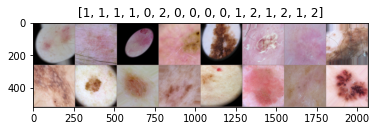

In [ ]:
# Get a batch of training data
batch = next(iter(train_loader_balanced))
inputs = batch["image"]
classes = batch["label"]

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[x.item() for x in classes])

# Training & Evaluation

## 1. ResNet

### Train

#### With Focal Loss

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/ResNet/resnet_fl.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/ResNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-6

In [ ]:
resnet = make_resnet(True, DEVICE)

criterion =  FocalLoss(alpha = class_weights, gamma = 2.0, size_average= True)

optimizer = optim.Adam(resnet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model:resnet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6')

Model:resnet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_fl.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [33:28<00:00,  6.31s/it]

train epoch 1 : loss : 0.3286, acc: 0.6734, kappa: 0.4689



100%|██████████| 20/20 [08:24<00:00, 25.24s/it]

val epoch 1 : loss : 0.2485, acc: 0.6598, kappa: 0.4851



Epoch 2/100
---------------


100%|██████████| 318/318 [02:17<00:00,  2.31it/s]

train epoch 2 : loss : 0.2606, acc: 0.7334, kappa: 0.5646



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 2 : loss : 0.2083, acc: 0.7976, kappa: 0.6587



Epoch 3/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.34it/s]

train epoch 3 : loss : 0.2241, acc: 0.7753, kappa: 0.6265



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 3 : loss : 0.1887, acc: 0.7843, kappa: 0.6486



Epoch 4/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.35it/s]

train epoch 4 : loss : 0.2009, acc: 0.7950, kappa: 0.6574



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 4 : loss : 0.1653, acc: 0.8409, kappa: 0.7303



Epoch 5/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.35it/s]

train epoch 5 : loss : 0.1893, acc: 0.8056, kappa: 0.6738



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 5 : loss : 0.1657, acc: 0.8701, kappa: 0.7725



Epoch 6/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.34it/s]

train epoch 6 : loss : 0.1670, acc: 0.8304, kappa: 0.7127



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 6 : loss : 0.1756, acc: 0.8858, kappa: 0.7978



Epoch 7/100
---------------


100%|██████████| 318/318 [02:14<00:00,  2.37it/s]

train epoch 7 : loss : 0.1754, acc: 0.8229, kappa: 0.6998



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 7 : loss : 0.1730, acc: 0.8551, kappa: 0.7520



Epoch 8/100
---------------


100%|██████████| 318/318 [02:16<00:00,  2.34it/s]

train epoch 8 : loss : 0.1464, acc: 0.8440, kappa: 0.7340



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 8 : loss : 0.1470, acc: 0.8953, kappa: 0.8167



Epoch 9/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.35it/s]

train epoch 9 : loss : 0.1279, acc: 0.8585, kappa: 0.7564



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 9 : loss : 0.1822, acc: 0.8827, kappa: 0.7930



Epoch 10/100
---------------


100%|██████████| 318/318 [02:14<00:00,  2.37it/s]

train epoch 10 : loss : 0.1318, acc: 0.8522, kappa: 0.7464



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 10 : loss : 0.1681, acc: 0.8803, kappa: 0.7847



Epoch 11/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.39it/s]

train epoch 11 : loss : 0.1255, acc: 0.8625, kappa: 0.7646



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 11 : loss : 0.1794, acc: 0.8866, kappa: 0.7995



Epoch 12/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 12 : loss : 0.1245, acc: 0.8701, kappa: 0.7762



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 12 : loss : 0.1332, acc: 0.8386, kappa: 0.7264



Epoch 13/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 13 : loss : 0.1281, acc: 0.8676, kappa: 0.7717



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 13 : loss : 0.1242, acc: 0.8921, kappa: 0.8121



Epoch 14/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 14 : loss : 0.1201, acc: 0.8735, kappa: 0.7815



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 14 : loss : 0.1130, acc: 0.8874, kappa: 0.8049



Epoch 15/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.37it/s]

train epoch 15 : loss : 0.1015, acc: 0.8918, kappa: 0.8112



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 15 : loss : 0.1443, acc: 0.8654, kappa: 0.7704



Epoch 16/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 16 : loss : 0.0908, acc: 0.9050, kappa: 0.8337



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 16 : loss : 0.1612, acc: 0.8717, kappa: 0.7776



Epoch 17/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 17 : loss : 0.0911, acc: 0.9028, kappa: 0.8303



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 17 : loss : 0.1323, acc: 0.9008, kappa: 0.8239



Epoch 18/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 18 : loss : 0.0810, acc: 0.9087, kappa: 0.8402



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 18 : loss : 0.1475, acc: 0.8764, kappa: 0.7840



Epoch 19/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 19 : loss : 0.0963, acc: 0.8977, kappa: 0.8217



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 19 : loss : 0.1560, acc: 0.8717, kappa: 0.7775



Epoch 20/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 20 : loss : 0.0828, acc: 0.9089, kappa: 0.8409



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 20 : loss : 0.1661, acc: 0.8984, kappa: 0.8174



Epoch 21/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 21 : loss : 0.0927, acc: 0.9069, kappa: 0.8377



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 21 : loss : 0.1998, acc: 0.8740, kappa: 0.7804



Epoch 22/100
---------------


  9%|▉         | 28/318 [00:14<02:01,  2.38it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_fl.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 22/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]


train epoch 22 : loss : 0.0899, acc: 0.9122, kappa: 0.8461


100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 22 : loss : 0.1479, acc: 0.8976, kappa: 0.8199



Epoch 23/100
---------------


100%|██████████| 318/318 [02:15<00:00,  2.35it/s]

train epoch 23 : loss : 0.0663, acc: 0.9292, kappa: 0.8751



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 23 : loss : 0.1316, acc: 0.9055, kappa: 0.8332



Epoch 24/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 24 : loss : 0.0587, acc: 0.9355, kappa: 0.8863



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 24 : loss : 0.1181, acc: 0.9126, kappa: 0.8457



Epoch 25/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 25 : loss : 0.0495, acc: 0.9486, kappa: 0.9091



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 25 : loss : 0.1159, acc: 0.9142, kappa: 0.8485



Epoch 26/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 26 : loss : 0.0447, acc: 0.9484, kappa: 0.9085



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 26 : loss : 0.1246, acc: 0.9244, kappa: 0.8657



Epoch 27/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 27 : loss : 0.0432, acc: 0.9536, kappa: 0.9174



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 27 : loss : 0.1162, acc: 0.9205, kappa: 0.8590


EARLY STOP AFTER 27 EPOCHS
Training complete in 16m 39s
Best val loss: 0.113030
Best val Kappa: 0.8657339700103959


##### Test

In [ ]:
resnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_fl_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(resnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

Test Loss: 0.1246 Acc: 0.9244, kappa: 0.8657
Testing complete in 0m 28s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1246, acc: 0.9244, kappa: 0.8657


Show some results

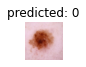

Actual: 0, predicted: 0


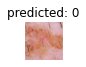

Actual: 0, predicted: 0


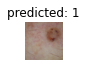

Actual: 0, predicted: 1


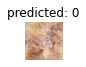

Actual: 0, predicted: 0


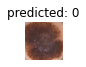

Actual: 0, predicted: 0


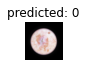

Actual: 0, predicted: 0


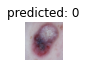

Actual: 0, predicted: 0


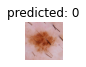

Actual: 0, predicted: 0


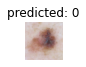

Actual: 0, predicted: 0


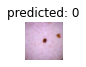

Actual: 0, predicted: 0


In [ ]:
visualize_model(resnet, val_loader, DEVICE, num_images=10)

#### With Weighted cross entropy

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/ResNet/resnet_wce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/ResNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
resnet = make_resnet(True, DEVICE)

criterion = nn.CrossEntropyLoss(weight=class_weights)

optimizer = optim.Adam(resnet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model: ResNet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model: ResNet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_wce.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [31:58<00:00,  6.03s/it]

train epoch 1 : loss : 0.8040, acc: 0.7127, kappa: 0.5120



100%|██████████| 20/20 [08:00<00:00, 24.04s/it]

val epoch 1 : loss : 0.5888, acc: 0.7228, kappa: 0.5514



Epoch 2/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 2 : loss : 0.6362, acc: 0.7645, kappa: 0.6041



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 2 : loss : 0.4628, acc: 0.8189, kappa: 0.6939



Epoch 3/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 3 : loss : 0.5703, acc: 0.7975, kappa: 0.6562



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 3 : loss : 0.4012, acc: 0.8433, kappa: 0.7258



Epoch 4/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 4 : loss : 0.5372, acc: 0.8139, kappa: 0.6826



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 4 : loss : 0.3858, acc: 0.8591, kappa: 0.7556



Epoch 5/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 5 : loss : 0.4739, acc: 0.8249, kappa: 0.7003



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 5 : loss : 0.6053, acc: 0.7661, kappa: 0.6268



Epoch 6/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 6 : loss : 0.4446, acc: 0.8434, kappa: 0.7295



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 6 : loss : 0.5345, acc: 0.7709, kappa: 0.6271



Epoch 7/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 7 : loss : 0.4162, acc: 0.8524, kappa: 0.7452



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 7 : loss : 0.3625, acc: 0.8528, kappa: 0.7443



Epoch 8/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 8 : loss : 0.3954, acc: 0.8593, kappa: 0.7569



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 8 : loss : 0.3823, acc: 0.8591, kappa: 0.7569



Epoch 9/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 9 : loss : 0.3669, acc: 0.8695, kappa: 0.7736



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 9 : loss : 0.3869, acc: 0.8512, kappa: 0.7496



Epoch 10/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 10 : loss : 0.3529, acc: 0.8689, kappa: 0.7728



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 10 : loss : 0.3120, acc: 0.8858, kappa: 0.8010



Epoch 11/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 11 : loss : 0.3264, acc: 0.8804, kappa: 0.7925



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 11 : loss : 0.2618, acc: 0.9142, kappa: 0.8475



Epoch 12/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 12 : loss : 0.3223, acc: 0.8859, kappa: 0.8020



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 12 : loss : 0.2499, acc: 0.9055, kappa: 0.8293



Epoch 13/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 13 : loss : 0.2921, acc: 0.8989, kappa: 0.8227



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 13 : loss : 0.3857, acc: 0.8661, kappa: 0.7705



Epoch 14/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 14 : loss : 0.3012, acc: 0.8896, kappa: 0.8074



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 14 : loss : 0.2459, acc: 0.9071, kappa: 0.8353



Epoch 15/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 15 : loss : 0.2674, acc: 0.8998, kappa: 0.8252



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 15 : loss : 0.2809, acc: 0.9071, kappa: 0.8359



Epoch 16/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 16 : loss : 0.2598, acc: 0.9095, kappa: 0.8411



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 16 : loss : 0.2913, acc: 0.9063, kappa: 0.8355



Epoch 17/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 17 : loss : 0.2646, acc: 0.9059, kappa: 0.8350



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 17 : loss : 0.3296, acc: 0.8937, kappa: 0.8134



Epoch 18/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 18 : loss : 0.2479, acc: 0.9105, kappa: 0.8427



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 18 : loss : 0.2743, acc: 0.8945, kappa: 0.8150



Epoch 19/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 19 : loss : 0.2411, acc: 0.9154, kappa: 0.8512



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 19 : loss : 0.2729, acc: 0.9094, kappa: 0.8422



Epoch 20/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 20 : loss : 0.2275, acc: 0.9189, kappa: 0.8577



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 20 : loss : 0.2828, acc: 0.9189, kappa: 0.8559



Epoch 21/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 21 : loss : 0.2071, acc: 0.9290, kappa: 0.8747



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 21 : loss : 0.2696, acc: 0.9165, kappa: 0.8527



Epoch 22/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 22 : loss : 0.1850, acc: 0.9301, kappa: 0.8764



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 22 : loss : 0.2640, acc: 0.9220, kappa: 0.8631



Epoch 23/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 23 : loss : 0.1371, acc: 0.9506, kappa: 0.9123



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 23 : loss : 0.2301, acc: 0.9307, kappa: 0.8780



Epoch 24/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 24 : loss : 0.1191, acc: 0.9589, kappa: 0.9268



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 24 : loss : 0.2224, acc: 0.9283, kappa: 0.8739



Epoch 25/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 25 : loss : 0.1111, acc: 0.9569, kappa: 0.9233



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 25 : loss : 0.1996, acc: 0.9354, kappa: 0.8858



Epoch 26/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 26 : loss : 0.1105, acc: 0.9587, kappa: 0.9265



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 26 : loss : 0.2111, acc: 0.9386, kappa: 0.8912



Epoch 27/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 27 : loss : 0.0940, acc: 0.9665, kappa: 0.9402



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 27 : loss : 0.2238, acc: 0.9315, kappa: 0.8792



Epoch 28/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 28 : loss : 0.1071, acc: 0.9640, kappa: 0.9358



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 28 : loss : 0.2284, acc: 0.9346, kappa: 0.8849



Epoch 29/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.50it/s]

train epoch 29 : loss : 0.0852, acc: 0.9673, kappa: 0.9417



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 29 : loss : 0.1935, acc: 0.9433, kappa: 0.8993



Epoch 30/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 30 : loss : 0.0878, acc: 0.9705, kappa: 0.9473



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 30 : loss : 0.2050, acc: 0.9354, kappa: 0.8858



Epoch 31/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 31 : loss : 0.0918, acc: 0.9660, kappa: 0.9392



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 31 : loss : 0.2144, acc: 0.9386, kappa: 0.8913



Epoch 32/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 32 : loss : 0.0798, acc: 0.9742, kappa: 0.9538



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 32 : loss : 0.2147, acc: 0.9370, kappa: 0.8887



Epoch 33/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 33 : loss : 0.0892, acc: 0.9669, kappa: 0.9410



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 33 : loss : 0.1983, acc: 0.9378, kappa: 0.8899



Epoch 34/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 34 : loss : 0.0854, acc: 0.9719, kappa: 0.9496



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 34 : loss : 0.1956, acc: 0.9441, kappa: 0.9005



Epoch 35/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 35 : loss : 0.0731, acc: 0.9768, kappa: 0.9584



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 35 : loss : 0.1955, acc: 0.9402, kappa: 0.8936



Epoch 36/100
---------------


 97%|█████████▋| 307/318 [02:01<00:04,  2.49it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_wce.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 37/100
---------------


100%|██████████| 318/318 [22:37<00:00,  4.27s/it]


train epoch 37 : loss : 0.0797, acc: 0.9734, kappa: 0.9524


100%|██████████| 20/20 [05:39<00:00, 16.97s/it]

val epoch 37 : loss : 0.1976, acc: 0.9457, kappa: 0.9031



Epoch 38/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.39it/s]

train epoch 38 : loss : 0.0698, acc: 0.9758, kappa: 0.9567



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 38 : loss : 0.2006, acc: 0.9378, kappa: 0.8893



Epoch 39/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 39 : loss : 0.0628, acc: 0.9768, kappa: 0.9585



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 39 : loss : 0.1924, acc: 0.9433, kappa: 0.8989



Epoch 40/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 40 : loss : 0.0736, acc: 0.9764, kappa: 0.9577



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 40 : loss : 0.1946, acc: 0.9425, kappa: 0.8975



Epoch 41/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 41 : loss : 0.0636, acc: 0.9776, kappa: 0.9598



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 41 : loss : 0.2037, acc: 0.9409, kappa: 0.8950



Epoch 42/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 42 : loss : 0.0762, acc: 0.9748, kappa: 0.9549



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 42 : loss : 0.1866, acc: 0.9417, kappa: 0.8963



Epoch 43/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 43 : loss : 0.0585, acc: 0.9784, kappa: 0.9613



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 43 : loss : 0.1871, acc: 0.9425, kappa: 0.8975



Epoch 44/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 44 : loss : 0.0625, acc: 0.9754, kappa: 0.9560



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 44 : loss : 0.1933, acc: 0.9409, kappa: 0.8951



Epoch 45/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 45 : loss : 0.0703, acc: 0.9787, kappa: 0.9619



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 45 : loss : 0.1916, acc: 0.9441, kappa: 0.9006



Epoch 46/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 46 : loss : 0.0621, acc: 0.9789, kappa: 0.9623



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 46 : loss : 0.1910, acc: 0.9409, kappa: 0.8951



Epoch 47/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 47 : loss : 0.0625, acc: 0.9764, kappa: 0.9577



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 47 : loss : 0.1866, acc: 0.9425, kappa: 0.8974



Epoch 48/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 48 : loss : 0.0640, acc: 0.9778, kappa: 0.9602



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 48 : loss : 0.1958, acc: 0.9433, kappa: 0.8989



Epoch 49/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 49 : loss : 0.0599, acc: 0.9760, kappa: 0.9571



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 49 : loss : 0.1932, acc: 0.9433, kappa: 0.8990



Epoch 50/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 50 : loss : 0.0652, acc: 0.9782, kappa: 0.9609



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 50 : loss : 0.1942, acc: 0.9433, kappa: 0.8992



Epoch 51/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 51 : loss : 0.0720, acc: 0.9746, kappa: 0.9545



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 51 : loss : 0.1962, acc: 0.9449, kappa: 0.9020



Epoch 52/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 52 : loss : 0.0659, acc: 0.9776, kappa: 0.9599



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 52 : loss : 0.1872, acc: 0.9449, kappa: 0.9015



Epoch 53/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 53 : loss : 0.0683, acc: 0.9784, kappa: 0.9612



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 53 : loss : 0.1865, acc: 0.9465, kappa: 0.9043



Epoch 54/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 54 : loss : 0.0621, acc: 0.9778, kappa: 0.9602



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 54 : loss : 0.1964, acc: 0.9417, kappa: 0.8963



Epoch 55/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 55 : loss : 0.0639, acc: 0.9789, kappa: 0.9623



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 55 : loss : 0.1856, acc: 0.9449, kappa: 0.9015



Epoch 56/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 56 : loss : 0.0684, acc: 0.9778, kappa: 0.9601



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 56 : loss : 0.1949, acc: 0.9433, kappa: 0.8994



Epoch 57/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 57 : loss : 0.0665, acc: 0.9784, kappa: 0.9612



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 57 : loss : 0.1880, acc: 0.9449, kappa: 0.9018



Epoch 58/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 58 : loss : 0.0715, acc: 0.9742, kappa: 0.9537



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 58 : loss : 0.1899, acc: 0.9425, kappa: 0.8974



Epoch 59/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 59 : loss : 0.0559, acc: 0.9791, kappa: 0.9626



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 59 : loss : 0.2017, acc: 0.9402, kappa: 0.8934



Epoch 60/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 60 : loss : 0.0654, acc: 0.9786, kappa: 0.9616



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 60 : loss : 0.1889, acc: 0.9472, kappa: 0.9059



Epoch 61/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 61 : loss : 0.0601, acc: 0.9778, kappa: 0.9602



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 61 : loss : 0.1966, acc: 0.9472, kappa: 0.9059



Epoch 62/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 62 : loss : 0.0653, acc: 0.9778, kappa: 0.9601



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 62 : loss : 0.1791, acc: 0.9465, kappa: 0.9044



Epoch 63/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 63 : loss : 0.0710, acc: 0.9738, kappa: 0.9531



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 63 : loss : 0.1913, acc: 0.9441, kappa: 0.9003



Epoch 64/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 64 : loss : 0.0586, acc: 0.9799, kappa: 0.9641



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 64 : loss : 0.1967, acc: 0.9409, kappa: 0.8950



Epoch 65/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 65 : loss : 0.0595, acc: 0.9801, kappa: 0.9644



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 65 : loss : 0.1997, acc: 0.9441, kappa: 0.9007



Epoch 66/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 66 : loss : 0.0664, acc: 0.9787, kappa: 0.9619



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 66 : loss : 0.1908, acc: 0.9449, kappa: 0.9017



Epoch 67/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 67 : loss : 0.0684, acc: 0.9786, kappa: 0.9616



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 67 : loss : 0.1885, acc: 0.9433, kappa: 0.8990



Epoch 68/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 68 : loss : 0.0637, acc: 0.9776, kappa: 0.9598



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 68 : loss : 0.1924, acc: 0.9433, kappa: 0.8989



Epoch 69/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 69 : loss : 0.0642, acc: 0.9787, kappa: 0.9619



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 69 : loss : 0.1845, acc: 0.9472, kappa: 0.9056



Epoch 70/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 70 : loss : 0.0721, acc: 0.9770, kappa: 0.9588



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 70 : loss : 0.1911, acc: 0.9449, kappa: 0.9016



Epoch 71/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 71 : loss : 0.0606, acc: 0.9778, kappa: 0.9602



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 71 : loss : 0.1953, acc: 0.9449, kappa: 0.9017



Epoch 72/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 72 : loss : 0.0579, acc: 0.9815, kappa: 0.9669



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 72 : loss : 0.1965, acc: 0.9417, kappa: 0.8963



Epoch 73/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 73 : loss : 0.0642, acc: 0.9764, kappa: 0.9577



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 73 : loss : 0.1941, acc: 0.9449, kappa: 0.9016



Epoch 74/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 74 : loss : 0.0754, acc: 0.9740, kappa: 0.9535



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 74 : loss : 0.1902, acc: 0.9433, kappa: 0.8988



Epoch 75/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 75 : loss : 0.0568, acc: 0.9813, kappa: 0.9665



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 75 : loss : 0.1911, acc: 0.9449, kappa: 0.9020


EARLY STOP AFTER 75 EPOCHS
Training complete in 129m 21s
Best val loss: 0.179132
Best val Kappa: 0.9059034551092355


##### Test

In [ ]:
resnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_wce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(resnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

Test Loss: 0.1966 Acc: 0.9472, kappa: 0.9059
Testing complete in 0m 28s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1966, acc: 0.9472, kappa: 0.9059


Show some results

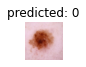

Actual: 0, predicted: 0


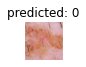

Actual: 0, predicted: 0


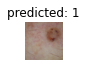

Actual: 0, predicted: 1


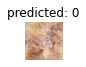

Actual: 0, predicted: 0


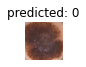

Actual: 0, predicted: 0


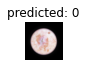

Actual: 0, predicted: 0


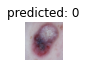

Actual: 0, predicted: 0


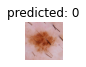

Actual: 0, predicted: 0


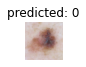

Actual: 0, predicted: 0


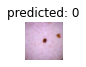

Actual: 0, predicted: 0


In [ ]:
visualize_model(resnet, val_loader, DEVICE, num_images=10)

#### Cross Entropy Loss + sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/ResNet/resnet_ce_samp.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/ResNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
resnet = make_resnet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(resnet.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.5, mode="min")

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:Resnet, LR: 1e-4, LR patience = 7, loss: CE + sampling, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model:Resnet, LR: 1e-4, LR patience = 7, loss: CE + sampling, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': mean_samples,
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_ce_samp.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 1 : loss : 0.5829, acc: 0.7786, kappa: 0.5843



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 1 : loss : 0.4109, acc: 0.8480, kappa: 0.7140



Epoch 2/100
---------------


100%|██████████| 318/318 [02:14<00:00,  2.36it/s]

train epoch 2 : loss : 0.4554, acc: 0.8270, kappa: 0.6756



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 2 : loss : 0.3693, acc: 0.8717, kappa: 0.7621



Epoch 3/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 3 : loss : 0.3883, acc: 0.8567, kappa: 0.7352



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 3 : loss : 0.3119, acc: 0.8858, kappa: 0.7930



Epoch 4/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 4 : loss : 0.3512, acc: 0.8660, kappa: 0.7534



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 4 : loss : 0.3141, acc: 0.8827, kappa: 0.7878



Epoch 5/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 5 : loss : 0.3163, acc: 0.8798, kappa: 0.7799



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 5 : loss : 0.2952, acc: 0.9000, kappa: 0.8188



Epoch 6/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 6 : loss : 0.3128, acc: 0.8813, kappa: 0.7829



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 6 : loss : 0.2783, acc: 0.8976, kappa: 0.8127



Epoch 7/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 7 : loss : 0.2818, acc: 0.8908, kappa: 0.8009



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 7 : loss : 0.2961, acc: 0.8937, kappa: 0.8086



Epoch 8/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 8 : loss : 0.2554, acc: 0.9042, kappa: 0.8252



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 8 : loss : 0.2515, acc: 0.9071, kappa: 0.8337



Epoch 9/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 9 : loss : 0.2341, acc: 0.9120, kappa: 0.8405



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 9 : loss : 0.2687, acc: 0.9031, kappa: 0.8283



Epoch 10/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 10 : loss : 0.2269, acc: 0.9150, kappa: 0.8454



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 10 : loss : 0.2403, acc: 0.9236, kappa: 0.8637



Epoch 11/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 11 : loss : 0.2109, acc: 0.9229, kappa: 0.8604



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 11 : loss : 0.2463, acc: 0.9220, kappa: 0.8608



Epoch 12/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 12 : loss : 0.2006, acc: 0.9288, kappa: 0.8710



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 12 : loss : 0.2280, acc: 0.9173, kappa: 0.8499



Epoch 13/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 13 : loss : 0.1872, acc: 0.9325, kappa: 0.8775



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 13 : loss : 0.2017, acc: 0.9268, kappa: 0.8678



Epoch 14/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 14 : loss : 0.1763, acc: 0.9353, kappa: 0.8828



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 14 : loss : 0.2811, acc: 0.9087, kappa: 0.8324



Epoch 15/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 15 : loss : 0.1589, acc: 0.9412, kappa: 0.8935



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 15 : loss : 0.2253, acc: 0.9220, kappa: 0.8603



Epoch 16/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 16 : loss : 0.1477, acc: 0.9457, kappa: 0.9019



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 16 : loss : 0.2740, acc: 0.9165, kappa: 0.8493



Epoch 17/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 17 : loss : 0.1580, acc: 0.9423, kappa: 0.8957



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 17 : loss : 0.2497, acc: 0.9220, kappa: 0.8583



Epoch 18/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 18 : loss : 0.1488, acc: 0.9433, kappa: 0.8976



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 18 : loss : 0.2618, acc: 0.9110, kappa: 0.8408



Epoch 19/100
---------------


 33%|███▎      | 104/318 [00:43<01:22,  2.60it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_ce_samp.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 19/100
---------------


100%|██████████| 318/318 [31:48<00:00,  6.00s/it]


train epoch 19 : loss : 0.1457, acc: 0.9496, kappa: 0.9088


100%|██████████| 20/20 [07:54<00:00, 23.73s/it]

val epoch 19 : loss : 0.2022, acc: 0.9268, kappa: 0.8671



Epoch 20/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 20 : loss : 0.1323, acc: 0.9534, kappa: 0.9158



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 20 : loss : 0.2899, acc: 0.9142, kappa: 0.8509



Epoch 21/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 21 : loss : 0.1205, acc: 0.9587, kappa: 0.9254



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 21 : loss : 0.2276, acc: 0.9339, kappa: 0.8810



Epoch 22/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 22 : loss : 0.0943, acc: 0.9677, kappa: 0.9419



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 22 : loss : 0.2189, acc: 0.9354, kappa: 0.8850



Epoch 23/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.43it/s]

train epoch 23 : loss : 0.0703, acc: 0.9750, kappa: 0.9549



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 23 : loss : 0.2168, acc: 0.9362, kappa: 0.8855



Epoch 24/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 24 : loss : 0.0727, acc: 0.9730, kappa: 0.9514



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 24 : loss : 0.2206, acc: 0.9346, kappa: 0.8822



Epoch 25/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 25 : loss : 0.0636, acc: 0.9780, kappa: 0.9603



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 25 : loss : 0.1849, acc: 0.9441, kappa: 0.8988



Epoch 26/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 26 : loss : 0.0784, acc: 0.9725, kappa: 0.9503



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 26 : loss : 0.1854, acc: 0.9512, kappa: 0.9127



Epoch 27/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 27 : loss : 0.0662, acc: 0.9768, kappa: 0.9582



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 27 : loss : 0.2018, acc: 0.9409, kappa: 0.8943



Epoch 28/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 28 : loss : 0.0570, acc: 0.9787, kappa: 0.9617



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 28 : loss : 0.1895, acc: 0.9496, kappa: 0.9101



Epoch 29/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 29 : loss : 0.0498, acc: 0.9833, kappa: 0.9699



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 29 : loss : 0.1924, acc: 0.9465, kappa: 0.9035



Epoch 30/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 30 : loss : 0.0695, acc: 0.9774, kappa: 0.9592



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 30 : loss : 0.2073, acc: 0.9449, kappa: 0.9014



Epoch 31/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 31 : loss : 0.0616, acc: 0.9778, kappa: 0.9599



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 31 : loss : 0.2006, acc: 0.9457, kappa: 0.9030



Epoch 32/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 32 : loss : 0.0603, acc: 0.9797, kappa: 0.9635



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 32 : loss : 0.1622, acc: 0.9512, kappa: 0.9117



Epoch 33/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 33 : loss : 0.0433, acc: 0.9856, kappa: 0.9741



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 33 : loss : 0.1910, acc: 0.9402, kappa: 0.8924



Epoch 34/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 34 : loss : 0.0472, acc: 0.9829, kappa: 0.9692



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 34 : loss : 0.1950, acc: 0.9496, kappa: 0.9091



Epoch 35/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 35 : loss : 0.0466, acc: 0.9829, kappa: 0.9692



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 35 : loss : 0.2162, acc: 0.9488, kappa: 0.9079



Epoch 36/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 36 : loss : 0.0433, acc: 0.9850, kappa: 0.9731



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 36 : loss : 0.2433, acc: 0.9362, kappa: 0.8864



Epoch 37/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 37 : loss : 0.0552, acc: 0.9833, kappa: 0.9699



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 37 : loss : 0.2131, acc: 0.9417, kappa: 0.8961



Epoch 38/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 38 : loss : 0.0490, acc: 0.9815, kappa: 0.9667



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 38 : loss : 0.1913, acc: 0.9504, kappa: 0.9110



Epoch 39/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 39 : loss : 0.0476, acc: 0.9821, kappa: 0.9678



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 39 : loss : 0.1567, acc: 0.9512, kappa: 0.9122



Epoch 40/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 40 : loss : 0.0491, acc: 0.9837, kappa: 0.9706



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 40 : loss : 0.2318, acc: 0.9370, kappa: 0.8870



Epoch 41/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 41 : loss : 0.0498, acc: 0.9837, kappa: 0.9706



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 41 : loss : 0.1910, acc: 0.9409, kappa: 0.8947



Epoch 42/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 42 : loss : 0.0500, acc: 0.9833, kappa: 0.9699



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 42 : loss : 0.1964, acc: 0.9480, kappa: 0.9065



Epoch 43/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 43 : loss : 0.0370, acc: 0.9860, kappa: 0.9749



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 43 : loss : 0.2067, acc: 0.9543, kappa: 0.9177



Epoch 44/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 44 : loss : 0.0420, acc: 0.9860, kappa: 0.9748



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 44 : loss : 0.2096, acc: 0.9520, kappa: 0.9139



Epoch 45/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 45 : loss : 0.0389, acc: 0.9876, kappa: 0.9777



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 45 : loss : 0.2349, acc: 0.9409, kappa: 0.8942



Epoch 46/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 46 : loss : 0.0438, acc: 0.9845, kappa: 0.9720



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 46 : loss : 0.1968, acc: 0.9488, kappa: 0.9085



Epoch 47/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 47 : loss : 0.0369, acc: 0.9876, kappa: 0.9777



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 47 : loss : 0.1828, acc: 0.9472, kappa: 0.9054



Epoch 48/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 48 : loss : 0.0306, acc: 0.9898, kappa: 0.9816



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 48 : loss : 0.1848, acc: 0.9496, kappa: 0.9100



Epoch 49/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 49 : loss : 0.0256, acc: 0.9917, kappa: 0.9851



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 49 : loss : 0.1918, acc: 0.9512, kappa: 0.9119



Epoch 50/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 50 : loss : 0.0246, acc: 0.9917, kappa: 0.9851



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 50 : loss : 0.1947, acc: 0.9535, kappa: 0.9165



Epoch 51/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 51 : loss : 0.0262, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 51 : loss : 0.1876, acc: 0.9504, kappa: 0.9109



Epoch 52/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 52 : loss : 0.0279, acc: 0.9892, kappa: 0.9805



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 52 : loss : 0.2133, acc: 0.9496, kappa: 0.9099


EARLY STOP AFTER 52 EPOCHS
Training complete in 127m 19s
Best val loss: 0.156652
Best val Kappa: 0.9176637335908717


##### Test

In [ ]:
resnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_ce_samp_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(resnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

Test Loss: 0.2067 Acc: 0.9543, kappa: 0.9177
Testing complete in 0m 30s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.2067, acc: 0.9543, kappa: 0.9177


Show some results

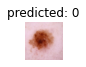

Actual: 0, predicted: 0


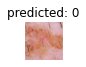

Actual: 0, predicted: 0


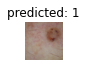

Actual: 0, predicted: 1


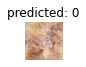

Actual: 0, predicted: 0


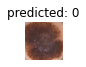

Actual: 0, predicted: 0


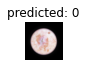

Actual: 0, predicted: 0


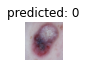

Actual: 0, predicted: 0


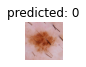

Actual: 0, predicted: 0


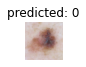

Actual: 0, predicted: 0


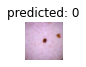

Actual: 0, predicted: 0


In [ ]:
visualize_model(resnet, val_loader, DEVICE, num_images=10)

#### With Cross Entropy Loss (no sampling)

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/ResNet/resnet_ce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/ResNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
resnet = make_resnet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(resnet.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.5, mode="min")

In [ ]:
logging.info('Model:Resnet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model:Resnet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_ce.pth'
resnet = train_model(resnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 1 : loss : 0.5703, acc: 0.7826, kappa: 0.5896



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 1 : loss : 0.3998, acc: 0.8480, kappa: 0.7141



Epoch 2/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 2 : loss : 0.4477, acc: 0.8320, kappa: 0.6856



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 2 : loss : 0.3253, acc: 0.8740, kappa: 0.7642



Epoch 3/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 3 : loss : 0.3992, acc: 0.8501, kappa: 0.7228



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 3 : loss : 0.3571, acc: 0.8764, kappa: 0.7719



Epoch 4/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 4 : loss : 0.3508, acc: 0.8660, kappa: 0.7533



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 4 : loss : 0.3231, acc: 0.8890, kappa: 0.7946



Epoch 5/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 5 : loss : 0.3205, acc: 0.8764, kappa: 0.7735



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 5 : loss : 0.2918, acc: 0.9039, kappa: 0.8249



Epoch 6/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 6 : loss : 0.3125, acc: 0.8847, kappa: 0.7896



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 6 : loss : 0.2819, acc: 0.8913, kappa: 0.8020



Epoch 7/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 7 : loss : 0.2737, acc: 0.8957, kappa: 0.8099



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 7 : loss : 0.2901, acc: 0.9031, kappa: 0.8218



Epoch 8/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 8 : loss : 0.2519, acc: 0.9054, kappa: 0.8276



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 8 : loss : 0.2399, acc: 0.9205, kappa: 0.8554



Epoch 9/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 9 : loss : 0.2437, acc: 0.9044, kappa: 0.8261



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 9 : loss : 0.2449, acc: 0.9134, kappa: 0.8441



Epoch 10/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 10 : loss : 0.2133, acc: 0.9219, kappa: 0.8581



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 10 : loss : 0.3116, acc: 0.8913, kappa: 0.8062



Epoch 11/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 11 : loss : 0.2079, acc: 0.9209, kappa: 0.8566



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 11 : loss : 0.2539, acc: 0.9173, kappa: 0.8500



Epoch 12/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 12 : loss : 0.2082, acc: 0.9240, kappa: 0.8621



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 12 : loss : 0.2260, acc: 0.9228, kappa: 0.8615



Epoch 13/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 13 : loss : 0.1912, acc: 0.9268, kappa: 0.8673



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 13 : loss : 0.2516, acc: 0.9244, kappa: 0.8637



Epoch 14/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 14 : loss : 0.1801, acc: 0.9319, kappa: 0.8766



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 14 : loss : 0.2382, acc: 0.9236, kappa: 0.8633



Epoch 15/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 15 : loss : 0.1670, acc: 0.9400, kappa: 0.8914



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 15 : loss : 0.2414, acc: 0.9205, kappa: 0.8541



Epoch 16/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 16 : loss : 0.1644, acc: 0.9364, kappa: 0.8852



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 16 : loss : 0.2177, acc: 0.9276, kappa: 0.8700



Epoch 17/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 17 : loss : 0.1391, acc: 0.9484, kappa: 0.9068



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 17 : loss : 0.2269, acc: 0.9276, kappa: 0.8688



Epoch 18/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 18 : loss : 0.1384, acc: 0.9490, kappa: 0.9079



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 18 : loss : 0.2237, acc: 0.9276, kappa: 0.8709



Epoch 19/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 19 : loss : 0.1450, acc: 0.9471, kappa: 0.9044



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 19 : loss : 0.2081, acc: 0.9331, kappa: 0.8797



Epoch 20/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.45it/s]

train epoch 20 : loss : 0.1320, acc: 0.9528, kappa: 0.9148



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 20 : loss : 0.2419, acc: 0.9346, kappa: 0.8819



Epoch 21/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 21 : loss : 0.1312, acc: 0.9506, kappa: 0.9109



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 21 : loss : 0.2164, acc: 0.9291, kappa: 0.8726



Epoch 22/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 22 : loss : 0.1348, acc: 0.9490, kappa: 0.9079



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 22 : loss : 0.2166, acc: 0.9425, kappa: 0.8959



Epoch 23/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 23 : loss : 0.1033, acc: 0.9618, kappa: 0.9312



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 23 : loss : 0.3214, acc: 0.9031, kappa: 0.8309



Epoch 24/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 24 : loss : 0.1100, acc: 0.9603, kappa: 0.9283



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 24 : loss : 0.2193, acc: 0.9339, kappa: 0.8819



Epoch 25/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.48it/s]

train epoch 25 : loss : 0.1025, acc: 0.9667, kappa: 0.9400



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 25 : loss : 0.2013, acc: 0.9465, kappa: 0.9038



Epoch 26/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 26 : loss : 0.1138, acc: 0.9563, kappa: 0.9212



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 26 : loss : 0.2058, acc: 0.9425, kappa: 0.8971



Epoch 27/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 27 : loss : 0.1022, acc: 0.9636, kappa: 0.9343



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 27 : loss : 0.2199, acc: 0.9323, kappa: 0.8785



Epoch 28/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 28 : loss : 0.1061, acc: 0.9630, kappa: 0.9333



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 28 : loss : 0.2061, acc: 0.9472, kappa: 0.9045



Epoch 29/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 29 : loss : 0.0935, acc: 0.9671, kappa: 0.9407



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 29 : loss : 0.2491, acc: 0.9331, kappa: 0.8793



Epoch 30/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 30 : loss : 0.0832, acc: 0.9675, kappa: 0.9414



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 30 : loss : 0.2861, acc: 0.9299, kappa: 0.8748



Epoch 31/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 31 : loss : 0.1020, acc: 0.9662, kappa: 0.9389



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 31 : loss : 0.2250, acc: 0.9362, kappa: 0.8867



Epoch 32/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 32 : loss : 0.0920, acc: 0.9677, kappa: 0.9419



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 32 : loss : 0.2322, acc: 0.9362, kappa: 0.8846



Epoch 33/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 33 : loss : 0.0901, acc: 0.9664, kappa: 0.9393



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 33 : loss : 0.3819, acc: 0.9165, kappa: 0.8526



Epoch 34/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 34 : loss : 0.0625, acc: 0.9774, kappa: 0.9592



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 34 : loss : 0.1982, acc: 0.9496, kappa: 0.9092



Epoch 35/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 35 : loss : 0.0448, acc: 0.9854, kappa: 0.9738



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 35 : loss : 0.2005, acc: 0.9543, kappa: 0.9179



Epoch 36/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 36 : loss : 0.0438, acc: 0.9862, kappa: 0.9752



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 36 : loss : 0.2071, acc: 0.9465, kappa: 0.9036



Epoch 37/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 37 : loss : 0.0482, acc: 0.9823, kappa: 0.9681



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 37 : loss : 0.2257, acc: 0.9425, kappa: 0.8960



Epoch 38/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 38 : loss : 0.0445, acc: 0.9858, kappa: 0.9745



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 38 : loss : 0.2062, acc: 0.9528, kappa: 0.9147



Epoch 39/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 39 : loss : 0.0479, acc: 0.9831, kappa: 0.9695



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 39 : loss : 0.2165, acc: 0.9441, kappa: 0.8992



Epoch 40/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.39it/s]

train epoch 40 : loss : 0.0437, acc: 0.9854, kappa: 0.9737



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 40 : loss : 0.2046, acc: 0.9496, kappa: 0.9092



Epoch 41/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.38it/s]

train epoch 41 : loss : 0.0421, acc: 0.9850, kappa: 0.9731



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 41 : loss : 0.1706, acc: 0.9567, kappa: 0.9219



Epoch 42/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 42 : loss : 0.0430, acc: 0.9845, kappa: 0.9720



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 42 : loss : 0.2036, acc: 0.9465, kappa: 0.9030



Epoch 43/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 43 : loss : 0.0358, acc: 0.9876, kappa: 0.9777



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 43 : loss : 0.2264, acc: 0.9409, kappa: 0.8946



Epoch 44/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 44 : loss : 0.0400, acc: 0.9860, kappa: 0.9748



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 44 : loss : 0.1903, acc: 0.9543, kappa: 0.9176



Epoch 45/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 45 : loss : 0.0393, acc: 0.9858, kappa: 0.9745



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 45 : loss : 0.2158, acc: 0.9504, kappa: 0.9105



Epoch 46/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 46 : loss : 0.0361, acc: 0.9862, kappa: 0.9752



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 46 : loss : 0.1905, acc: 0.9496, kappa: 0.9090



Epoch 47/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 47 : loss : 0.0383, acc: 0.9872, kappa: 0.9770



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 47 : loss : 0.2068, acc: 0.9488, kappa: 0.9086



Epoch 48/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 48 : loss : 0.0329, acc: 0.9878, kappa: 0.9780



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 48 : loss : 0.2267, acc: 0.9472, kappa: 0.9051



Epoch 49/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.39it/s]

train epoch 49 : loss : 0.0355, acc: 0.9878, kappa: 0.9780



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 49 : loss : 0.2601, acc: 0.9409, kappa: 0.8934



Epoch 50/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 50 : loss : 0.0256, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 50 : loss : 0.2055, acc: 0.9504, kappa: 0.9108



Epoch 51/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 51 : loss : 0.0216, acc: 0.9937, kappa: 0.9887



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 51 : loss : 0.1841, acc: 0.9512, kappa: 0.9124



Epoch 52/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 52 : loss : 0.0234, acc: 0.9921, kappa: 0.9858



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 52 : loss : 0.1901, acc: 0.9559, kappa: 0.9207



Epoch 53/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.41it/s]

train epoch 53 : loss : 0.0166, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 53 : loss : 0.2100, acc: 0.9551, kappa: 0.9187



Epoch 54/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.39it/s]

train epoch 54 : loss : 0.0216, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 54 : loss : 0.2116, acc: 0.9512, kappa: 0.9120


EARLY STOP AFTER 54 EPOCHS
Training complete in 143m 45s
Best val loss: 0.170572
Best val Kappa: 0.9218557715973419


##### Test

In [ ]:
resnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(resnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

Test Loss: 0.1706 Acc: 0.9567, kappa: 0.9219
Testing complete in 0m 28s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1706, acc: 0.9567, kappa: 0.9219


Show some results

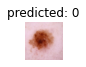

Actual: 0, predicted: 0


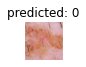

Actual: 0, predicted: 0


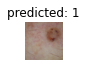

Actual: 0, predicted: 1


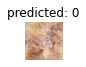

Actual: 0, predicted: 0


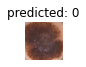

Actual: 0, predicted: 0


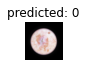

Actual: 0, predicted: 0


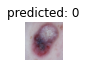

Actual: 0, predicted: 0


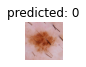

Actual: 0, predicted: 0


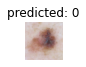

Actual: 0, predicted: 0


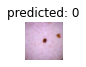

Actual: 0, predicted: 0


In [ ]:
visualize_model(resnet, val_loader, DEVICE, num_images=10)

## 2. DenseNet

### Train

#### With Focal Loss

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/DenseNet/densenet_fl.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/DenseNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-6

In [ ]:
densenet = make_densenet(True, DEVICE)

criterion =  FocalLoss(alpha = class_weights, gamma = 2.0, size_average= True)

optimizer = optim.Adam(densenet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/densenet161-8d451a50.pth" to /root/.cache/torch/hub/checkpoints/densenet161-8d451a50.pth


  0%|          | 0.00/110M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:Densenet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6')

Model:Densenet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_fl.pth'
densenet = train_model(densenet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [03:05<00:00,  1.71it/s]

train epoch 1 : loss : 0.3276, acc: 0.6574, kappa: 0.4602



100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

val epoch 1 : loss : 0.2477, acc: 0.7772, kappa: 0.6242



Epoch 2/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.83it/s]

train epoch 2 : loss : 0.2690, acc: 0.7277, kappa: 0.5557



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 2 : loss : 0.2193, acc: 0.7276, kappa: 0.5721



Epoch 3/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 3 : loss : 0.2200, acc: 0.7672, kappa: 0.6123



100%|██████████| 20/20 [00:33<00:00,  1.67s/it]

val epoch 3 : loss : 0.1705, acc: 0.7976, kappa: 0.6662



Epoch 4/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 4 : loss : 0.2020, acc: 0.7930, kappa: 0.6541



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 4 : loss : 0.1673, acc: 0.8197, kappa: 0.6947



Epoch 5/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 5 : loss : 0.1983, acc: 0.7928, kappa: 0.6524



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 5 : loss : 0.1809, acc: 0.8110, kappa: 0.6853



Epoch 6/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 6 : loss : 0.1808, acc: 0.8099, kappa: 0.6791



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 6 : loss : 0.1465, acc: 0.8150, kappa: 0.6945



Epoch 7/100
---------------


100%|██████████| 318/318 [02:56<00:00,  1.81it/s]

train epoch 7 : loss : 0.1844, acc: 0.8074, kappa: 0.6758



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 7 : loss : 0.1621, acc: 0.8102, kappa: 0.6878



Epoch 8/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 8 : loss : 0.1713, acc: 0.8282, kappa: 0.7083



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 8 : loss : 0.1650, acc: 0.8220, kappa: 0.7055



Epoch 9/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 9 : loss : 0.1711, acc: 0.8296, kappa: 0.7100



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 9 : loss : 0.1269, acc: 0.8630, kappa: 0.7652



Epoch 10/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.83it/s]

train epoch 10 : loss : 0.1445, acc: 0.8481, kappa: 0.7389



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 10 : loss : 0.1239, acc: 0.8433, kappa: 0.7362



Epoch 11/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 11 : loss : 0.1465, acc: 0.8505, kappa: 0.7439



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 11 : loss : 0.1370, acc: 0.8898, kappa: 0.8071



Epoch 12/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 12 : loss : 0.1480, acc: 0.8447, kappa: 0.7346



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 12 : loss : 0.1602, acc: 0.8102, kappa: 0.6882



Epoch 13/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 13 : loss : 0.1434, acc: 0.8503, kappa: 0.7428



100%|██████████| 20/20 [00:32<00:00,  1.64s/it]

val epoch 13 : loss : 0.1488, acc: 0.8370, kappa: 0.7292



Epoch 14/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 14 : loss : 0.1156, acc: 0.8741, kappa: 0.7816



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 14 : loss : 0.1399, acc: 0.8236, kappa: 0.7058



Epoch 15/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 15 : loss : 0.1294, acc: 0.8621, kappa: 0.7630



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 15 : loss : 0.1600, acc: 0.8614, kappa: 0.7624



Epoch 16/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 16 : loss : 0.1326, acc: 0.8615, kappa: 0.7621



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 16 : loss : 0.1239, acc: 0.8559, kappa: 0.7588



Epoch 17/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 17 : loss : 0.1338, acc: 0.8579, kappa: 0.7563



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 17 : loss : 0.1945, acc: 0.7961, kappa: 0.6693



Epoch 18/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 18 : loss : 0.1342, acc: 0.8662, kappa: 0.7698



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 18 : loss : 0.1482, acc: 0.8827, kappa: 0.7953



Epoch 19/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 19 : loss : 0.0958, acc: 0.9048, kappa: 0.8335



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 19 : loss : 0.1161, acc: 0.9087, kappa: 0.8392



Epoch 20/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.84it/s]

train epoch 20 : loss : 0.0777, acc: 0.9205, kappa: 0.8601



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 20 : loss : 0.1083, acc: 0.9157, kappa: 0.8524



Epoch 21/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 21 : loss : 0.0704, acc: 0.9317, kappa: 0.8795



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 21 : loss : 0.1049, acc: 0.9126, kappa: 0.8468



Epoch 22/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 22 : loss : 0.0633, acc: 0.9325, kappa: 0.8810



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 22 : loss : 0.1057, acc: 0.9189, kappa: 0.8572



Epoch 23/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.86it/s]

train epoch 23 : loss : 0.0633, acc: 0.9339, kappa: 0.8832



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 23 : loss : 0.1040, acc: 0.9157, kappa: 0.8517



Epoch 24/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 24 : loss : 0.0581, acc: 0.9441, kappa: 0.9010



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 24 : loss : 0.1008, acc: 0.9213, kappa: 0.8613



Epoch 25/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 25 : loss : 0.0566, acc: 0.9333, kappa: 0.8822



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 25 : loss : 0.1041, acc: 0.9244, kappa: 0.8668



Epoch 26/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.82it/s]

train epoch 26 : loss : 0.0483, acc: 0.9431, kappa: 0.8992



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 26 : loss : 0.0962, acc: 0.9228, kappa: 0.8642



Epoch 27/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 27 : loss : 0.0470, acc: 0.9463, kappa: 0.9047



100%|██████████| 20/20 [00:33<00:00,  1.66s/it]


val epoch 27 : loss : 0.1045, acc: 0.9299, kappa: 0.8752

Epoch 28/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.85it/s]

train epoch 28 : loss : 0.0515, acc: 0.9418, kappa: 0.8966



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 28 : loss : 0.1038, acc: 0.9291, kappa: 0.8750



Epoch 29/100
---------------


 86%|████████▋ | 275/318 [02:30<00:22,  1.91it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_fl.pth'
densenet = train_model(densenet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 29/100
---------------


100%|██████████| 318/318 [23:48<00:00,  4.49s/it]

train epoch 29 : loss : 0.0420, acc: 0.9500, kappa: 0.9113



100%|██████████| 20/20 [05:50<00:00, 17.52s/it]

val epoch 29 : loss : 0.1107, acc: 0.9299, kappa: 0.8761



Epoch 30/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 30 : loss : 0.0395, acc: 0.9542, kappa: 0.9184



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 30 : loss : 0.1001, acc: 0.9268, kappa: 0.8706



Epoch 31/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 31 : loss : 0.0415, acc: 0.9540, kappa: 0.9180



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 31 : loss : 0.1000, acc: 0.9189, kappa: 0.8574



Epoch 32/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 32 : loss : 0.0446, acc: 0.9528, kappa: 0.9160



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 32 : loss : 0.1030, acc: 0.9339, kappa: 0.8825



Epoch 33/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.89it/s]

train epoch 33 : loss : 0.0398, acc: 0.9524, kappa: 0.9155



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 33 : loss : 0.0983, acc: 0.9276, kappa: 0.8717



Epoch 34/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 34 : loss : 0.0396, acc: 0.9561, kappa: 0.9219



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 34 : loss : 0.0973, acc: 0.9370, kappa: 0.8882



Epoch 35/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 35 : loss : 0.0356, acc: 0.9567, kappa: 0.9229



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 35 : loss : 0.0994, acc: 0.9370, kappa: 0.8878



Epoch 36/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 36 : loss : 0.0357, acc: 0.9597, kappa: 0.9282



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 36 : loss : 0.0961, acc: 0.9354, kappa: 0.8854



Epoch 37/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 37 : loss : 0.0376, acc: 0.9583, kappa: 0.9258



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 37 : loss : 0.0980, acc: 0.9370, kappa: 0.8881



Epoch 38/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 38 : loss : 0.0342, acc: 0.9640, kappa: 0.9359



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 38 : loss : 0.0956, acc: 0.9378, kappa: 0.8896



Epoch 39/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 39 : loss : 0.0328, acc: 0.9597, kappa: 0.9282



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 39 : loss : 0.0982, acc: 0.9394, kappa: 0.8926



Epoch 40/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 40 : loss : 0.0353, acc: 0.9606, kappa: 0.9298



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 40 : loss : 0.0948, acc: 0.9346, kappa: 0.8842



Epoch 41/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 41 : loss : 0.0356, acc: 0.9604, kappa: 0.9295



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 41 : loss : 0.0997, acc: 0.9378, kappa: 0.8895



Epoch 42/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 42 : loss : 0.0314, acc: 0.9646, kappa: 0.9368



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 42 : loss : 0.0984, acc: 0.9362, kappa: 0.8867



Epoch 43/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 43 : loss : 0.0325, acc: 0.9648, kappa: 0.9372



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 43 : loss : 0.1021, acc: 0.9362, kappa: 0.8866



Epoch 44/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 44 : loss : 0.0310, acc: 0.9662, kappa: 0.9396



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 44 : loss : 0.0955, acc: 0.9378, kappa: 0.8897



Epoch 45/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 45 : loss : 0.0317, acc: 0.9665, kappa: 0.9403



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 45 : loss : 0.0949, acc: 0.9386, kappa: 0.8910



Epoch 46/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 46 : loss : 0.0308, acc: 0.9665, kappa: 0.9402



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 46 : loss : 0.1002, acc: 0.9386, kappa: 0.8907



Epoch 47/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 47 : loss : 0.0300, acc: 0.9669, kappa: 0.9410



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 47 : loss : 0.0962, acc: 0.9394, kappa: 0.8925



Epoch 48/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 48 : loss : 0.0334, acc: 0.9652, kappa: 0.9379



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 48 : loss : 0.0986, acc: 0.9354, kappa: 0.8854



Epoch 49/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 49 : loss : 0.0304, acc: 0.9665, kappa: 0.9403



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 49 : loss : 0.0965, acc: 0.9370, kappa: 0.8888



Epoch 50/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 50 : loss : 0.0304, acc: 0.9664, kappa: 0.9400



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 50 : loss : 0.0985, acc: 0.9378, kappa: 0.8897



Epoch 51/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 51 : loss : 0.0300, acc: 0.9656, kappa: 0.9385



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 51 : loss : 0.1015, acc: 0.9394, kappa: 0.8924



Epoch 52/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.93it/s]

train epoch 52 : loss : 0.0287, acc: 0.9634, kappa: 0.9348



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 52 : loss : 0.1015, acc: 0.9370, kappa: 0.8881



Epoch 53/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 53 : loss : 0.0287, acc: 0.9679, kappa: 0.9427



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 53 : loss : 0.1031, acc: 0.9362, kappa: 0.8869


EARLY STOP AFTER 53 EPOCHS
Training complete in 109m 6s
Best val loss: 0.094816
Best val Kappa: 0.8925691560653001


##### Test

In [ ]:
densenet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_fl_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(densenet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

Test Loss: 0.0982 Acc: 0.9394, kappa: 0.8926
Testing complete in 0m 31s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.0982, acc: 0.9394, kappa: 0.8926


Show some results

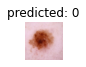

Actual: 0, predicted: 0


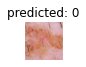

Actual: 0, predicted: 0


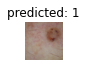

Actual: 0, predicted: 1


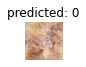

Actual: 0, predicted: 0


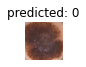

Actual: 0, predicted: 0


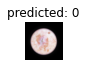

Actual: 0, predicted: 0


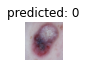

Actual: 0, predicted: 0


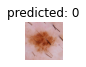

Actual: 0, predicted: 0


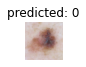

Actual: 0, predicted: 0


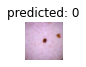

Actual: 0, predicted: 0


In [ ]:
visualize_model(densenet, val_loader, DEVICE, num_images=10)

#### With Weighted cross entropy

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/DenseNet/densenet_wce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/DenseNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
densenet = make_densenet(True, DEVICE)

criterion = nn.CrossEntropyLoss(weight=class_weights)

optimizer = optim.Adam(densenet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/densenet161-8d451a50.pth" to /root/.cache/torch/hub/checkpoints/densenet161-8d451a50.pth


  0%|          | 0.00/110M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:Densenet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model:Densenet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_wce.pth'
densenet = train_model(densenet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:58<00:00,  1.78it/s]

train epoch 1 : loss : 0.7458, acc: 0.7204, kappa: 0.5296



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 1 : loss : 0.5395, acc: 0.7472, kappa: 0.5865



Epoch 2/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.88it/s]

train epoch 2 : loss : 0.6161, acc: 0.7804, kappa: 0.6285



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 2 : loss : 0.4629, acc: 0.8000, kappa: 0.6628



Epoch 3/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 3 : loss : 0.5736, acc: 0.7946, kappa: 0.6491



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 3 : loss : 0.4361, acc: 0.8134, kappa: 0.6845



Epoch 4/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.89it/s]

train epoch 4 : loss : 0.5203, acc: 0.8072, kappa: 0.6723



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 4 : loss : 0.4209, acc: 0.8512, kappa: 0.7443



Epoch 5/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 5 : loss : 0.4991, acc: 0.8215, kappa: 0.6942



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 5 : loss : 0.4511, acc: 0.8157, kappa: 0.6935



Epoch 6/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.92it/s]

train epoch 6 : loss : 0.4407, acc: 0.8426, kappa: 0.7297



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 6 : loss : 0.3442, acc: 0.8669, kappa: 0.7682



Epoch 7/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 7 : loss : 0.4172, acc: 0.8459, kappa: 0.7339



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 7 : loss : 0.4573, acc: 0.8205, kappa: 0.7005



Epoch 8/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 8 : loss : 0.4067, acc: 0.8567, kappa: 0.7529



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 8 : loss : 0.3548, acc: 0.8654, kappa: 0.7690



Epoch 9/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 9 : loss : 0.3813, acc: 0.8664, kappa: 0.7685



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 9 : loss : 0.3554, acc: 0.8756, kappa: 0.7857



Epoch 10/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 10 : loss : 0.3604, acc: 0.8717, kappa: 0.7766



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 10 : loss : 0.4281, acc: 0.8394, kappa: 0.7307



Epoch 11/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 11 : loss : 0.3688, acc: 0.8693, kappa: 0.7729



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 11 : loss : 0.3056, acc: 0.8937, kappa: 0.8097



Epoch 12/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 12 : loss : 0.3219, acc: 0.8924, kappa: 0.8120



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 12 : loss : 0.3764, acc: 0.8606, kappa: 0.7625



Epoch 13/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 13 : loss : 0.3082, acc: 0.8878, kappa: 0.8041



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 13 : loss : 0.4676, acc: 0.8386, kappa: 0.7314



Epoch 14/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 14 : loss : 0.3064, acc: 0.8888, kappa: 0.8062



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 14 : loss : 0.2490, acc: 0.9228, kappa: 0.8629



Epoch 15/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 15 : loss : 0.3052, acc: 0.8985, kappa: 0.8221



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 15 : loss : 0.3370, acc: 0.8748, kappa: 0.7858



Epoch 16/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 16 : loss : 0.2703, acc: 0.9030, kappa: 0.8302



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 16 : loss : 0.2683, acc: 0.9126, kappa: 0.8452



Epoch 17/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 17 : loss : 0.2803, acc: 0.9026, kappa: 0.8292



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 17 : loss : 0.2677, acc: 0.9071, kappa: 0.8377



Epoch 18/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 18 : loss : 0.2620, acc: 0.9166, kappa: 0.8529



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 18 : loss : 0.3355, acc: 0.8819, kappa: 0.7938



Epoch 19/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 19 : loss : 0.2541, acc: 0.9111, kappa: 0.8437



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 19 : loss : 0.2563, acc: 0.9220, kappa: 0.8609



Epoch 20/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 20 : loss : 0.2402, acc: 0.9116, kappa: 0.8446



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 20 : loss : 0.2736, acc: 0.9110, kappa: 0.8428



Epoch 21/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 21 : loss : 0.2533, acc: 0.9115, kappa: 0.8438



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 21 : loss : 0.2979, acc: 0.8913, kappa: 0.8116



Epoch 22/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 22 : loss : 0.2217, acc: 0.9189, kappa: 0.8571



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 22 : loss : 0.2424, acc: 0.9134, kappa: 0.8461



Epoch 23/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 23 : loss : 0.2106, acc: 0.9286, kappa: 0.8737



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 23 : loss : 0.4109, acc: 0.8701, kappa: 0.7770



Epoch 24/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.90it/s]

train epoch 24 : loss : 0.2008, acc: 0.9274, kappa: 0.8717



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 24 : loss : 0.3396, acc: 0.8929, kappa: 0.8148



Epoch 25/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 25 : loss : 0.2021, acc: 0.9256, kappa: 0.8685



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 25 : loss : 0.2842, acc: 0.9110, kappa: 0.8439



Epoch 26/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 26 : loss : 0.1878, acc: 0.9309, kappa: 0.8778



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 26 : loss : 0.2778, acc: 0.9031, kappa: 0.8293



Epoch 27/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 27 : loss : 0.1959, acc: 0.9309, kappa: 0.8780



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 27 : loss : 0.2465, acc: 0.9189, kappa: 0.8556



Epoch 28/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 28 : loss : 0.2102, acc: 0.9313, kappa: 0.8786



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 28 : loss : 0.2221, acc: 0.9315, kappa: 0.8772



Epoch 29/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 29 : loss : 0.1927, acc: 0.9366, kappa: 0.8878



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 29 : loss : 0.3050, acc: 0.8976, kappa: 0.8222



Epoch 30/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 30 : loss : 0.1681, acc: 0.9457, kappa: 0.9034



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 30 : loss : 0.2384, acc: 0.9252, kappa: 0.8678



Epoch 31/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 31 : loss : 0.2005, acc: 0.9331, kappa: 0.8816



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 31 : loss : 0.2931, acc: 0.9071, kappa: 0.8383



Epoch 32/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 32 : loss : 0.1618, acc: 0.9439, kappa: 0.9005



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 32 : loss : 0.2301, acc: 0.9307, kappa: 0.8758



Epoch 33/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 33 : loss : 0.1399, acc: 0.9486, kappa: 0.9088



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 33 : loss : 0.2076, acc: 0.9299, kappa: 0.8749



Epoch 34/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 34 : loss : 0.1536, acc: 0.9473, kappa: 0.9061



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 34 : loss : 0.2662, acc: 0.9197, kappa: 0.8558



Epoch 35/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 35 : loss : 0.1702, acc: 0.9398, kappa: 0.8935



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 35 : loss : 0.2384, acc: 0.9252, kappa: 0.8666



Epoch 36/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 36 : loss : 0.1402, acc: 0.9502, kappa: 0.9114



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 36 : loss : 0.3321, acc: 0.8984, kappa: 0.8241



Epoch 37/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.89it/s]

train epoch 37 : loss : 0.1751, acc: 0.9402, kappa: 0.8942



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 37 : loss : 0.2499, acc: 0.9110, kappa: 0.8431



Epoch 38/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 38 : loss : 0.1484, acc: 0.9516, kappa: 0.9138



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 38 : loss : 0.2734, acc: 0.9260, kappa: 0.8686



Epoch 39/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 39 : loss : 0.1660, acc: 0.9439, kappa: 0.9003



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 39 : loss : 0.3055, acc: 0.9157, kappa: 0.8485



Epoch 40/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 40 : loss : 0.1461, acc: 0.9486, kappa: 0.9088



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 40 : loss : 0.3360, acc: 0.8843, kappa: 0.7998



Epoch 41/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.88it/s]

train epoch 41 : loss : 0.1413, acc: 0.9534, kappa: 0.9171



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 41 : loss : 0.2365, acc: 0.9213, kappa: 0.8596



Epoch 42/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 42 : loss : 0.0837, acc: 0.9726, kappa: 0.9510



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 42 : loss : 0.2104, acc: 0.9315, kappa: 0.8767



Epoch 43/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.88it/s]

train epoch 43 : loss : 0.0689, acc: 0.9762, kappa: 0.9574



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 43 : loss : 0.2149, acc: 0.9394, kappa: 0.8916



Epoch 44/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 44 : loss : 0.0700, acc: 0.9766, kappa: 0.9580



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 44 : loss : 0.2014, acc: 0.9378, kappa: 0.8884



Epoch 45/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 45 : loss : 0.0599, acc: 0.9793, kappa: 0.9630



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 45 : loss : 0.1991, acc: 0.9394, kappa: 0.8909



Epoch 46/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 46 : loss : 0.0515, acc: 0.9833, kappa: 0.9700



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 46 : loss : 0.1963, acc: 0.9417, kappa: 0.8955



Epoch 47/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 47 : loss : 0.0565, acc: 0.9848, kappa: 0.9728



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 47 : loss : 0.1973, acc: 0.9409, kappa: 0.8944



Epoch 48/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 48 : loss : 0.0496, acc: 0.9835, kappa: 0.9703



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 48 : loss : 0.1985, acc: 0.9449, kappa: 0.9010



Epoch 49/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 49 : loss : 0.0478, acc: 0.9839, kappa: 0.9711



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 49 : loss : 0.1980, acc: 0.9433, kappa: 0.8981



Epoch 50/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 50 : loss : 0.0467, acc: 0.9850, kappa: 0.9732



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 50 : loss : 0.1980, acc: 0.9425, kappa: 0.8973



Epoch 51/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 51 : loss : 0.0354, acc: 0.9882, kappa: 0.9788



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 51 : loss : 0.1988, acc: 0.9425, kappa: 0.8969



Epoch 52/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 52 : loss : 0.0444, acc: 0.9864, kappa: 0.9756



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 52 : loss : 0.2022, acc: 0.9441, kappa: 0.8995



Epoch 53/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 53 : loss : 0.0420, acc: 0.9894, kappa: 0.9809



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 53 : loss : 0.1920, acc: 0.9457, kappa: 0.9024



Epoch 54/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 54 : loss : 0.0391, acc: 0.9866, kappa: 0.9760



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 54 : loss : 0.1929, acc: 0.9441, kappa: 0.8990



Epoch 55/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 55 : loss : 0.0395, acc: 0.9856, kappa: 0.9742



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 55 : loss : 0.2021, acc: 0.9441, kappa: 0.8996



Epoch 56/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.87it/s]

train epoch 56 : loss : 0.0344, acc: 0.9886, kappa: 0.9795



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 56 : loss : 0.2090, acc: 0.9425, kappa: 0.8966



Epoch 57/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.87it/s]

train epoch 57 : loss : 0.0333, acc: 0.9892, kappa: 0.9806



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 57 : loss : 0.2069, acc: 0.9433, kappa: 0.8981



Epoch 58/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 58 : loss : 0.0338, acc: 0.9900, kappa: 0.9820



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 58 : loss : 0.2064, acc: 0.9409, kappa: 0.8936



Epoch 59/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 59 : loss : 0.0239, acc: 0.9915, kappa: 0.9848



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 59 : loss : 0.2023, acc: 0.9449, kappa: 0.9009



Epoch 60/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.87it/s]

train epoch 60 : loss : 0.0284, acc: 0.9917, kappa: 0.9852



100%|██████████| 20/20 [00:31<00:00,  1.60s/it]

val epoch 60 : loss : 0.2026, acc: 0.9480, kappa: 0.9061



Epoch 61/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 61 : loss : 0.0298, acc: 0.9888, kappa: 0.9799



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 61 : loss : 0.2088, acc: 0.9449, kappa: 0.9007



Epoch 62/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 62 : loss : 0.0302, acc: 0.9894, kappa: 0.9809



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 62 : loss : 0.2070, acc: 0.9441, kappa: 0.8996



Epoch 63/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 63 : loss : 0.0272, acc: 0.9917, kappa: 0.9851



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 63 : loss : 0.2091, acc: 0.9465, kappa: 0.9037



Epoch 64/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 64 : loss : 0.0251, acc: 0.9921, kappa: 0.9859



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 64 : loss : 0.2182, acc: 0.9457, kappa: 0.9024



Epoch 65/100
---------------


 30%|███       | 96/318 [00:52<01:54,  1.93it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_wce.pth'
densenet = train_model(densenet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 65/100
---------------


100%|██████████| 318/318 [33:09<00:00,  6.26s/it]

train epoch 65 : loss : 0.0260, acc: 0.9913, kappa: 0.9845



100%|██████████| 20/20 [08:27<00:00, 25.37s/it]

val epoch 65 : loss : 0.2038, acc: 0.9480, kappa: 0.9063



Epoch 66/100
---------------


100%|██████████| 318/318 [02:44<00:00,  1.93it/s]

train epoch 66 : loss : 0.0266, acc: 0.9919, kappa: 0.9855



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 66 : loss : 0.2027, acc: 0.9480, kappa: 0.9065


EARLY STOP AFTER 66 EPOCHS
Training complete in 45m 17s
Best val loss: 0.192039
Best val Kappa: 0.9065043189605939


##### Test

In [ ]:
densenet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_wce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(densenet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

Test Loss: 0.2027 Acc: 0.9480, kappa: 0.9065
Testing complete in 0m 30s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.2027, acc: 0.9480, kappa: 0.9065


Show some results

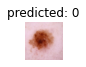

Actual: 0, predicted: 0


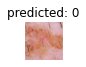

Actual: 0, predicted: 0


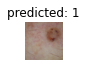

Actual: 0, predicted: 1


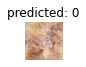

Actual: 0, predicted: 0


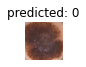

Actual: 0, predicted: 0


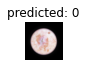

Actual: 0, predicted: 0


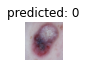

Actual: 0, predicted: 0


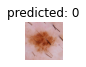

Actual: 0, predicted: 0


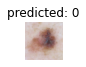

Actual: 0, predicted: 0


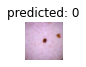

Actual: 0, predicted: 0


In [ ]:
visualize_model(densenet, val_loader, DEVICE, num_images=10)

#### Cross Entropy with sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/DenseNet/densenet_ce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/DenseNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 10

EPOCHS = 100
WD = 1e-6

In [ ]:
densenet = make_densenet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(densenet.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model:Densenet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling')

Model:Densenet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': mean_samples,
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_ce_sampling.pth'
densenet = train_model(densenet, dataloaders_balanced, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 1 : loss : 0.4859, acc: 0.8018, kappa: 0.7026



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 1 : loss : 0.5296, acc: 0.7835, kappa: 0.6504



Epoch 2/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 2 : loss : 0.4138, acc: 0.8375, kappa: 0.7561



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 2 : loss : 0.3413, acc: 0.8598, kappa: 0.7581



Epoch 3/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 3 : loss : 0.3698, acc: 0.8585, kappa: 0.7877



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 3 : loss : 0.4055, acc: 0.8441, kappa: 0.7366



Epoch 4/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 4 : loss : 0.3242, acc: 0.8749, kappa: 0.8123



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 4 : loss : 0.2937, acc: 0.8929, kappa: 0.8093



Epoch 5/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 5 : loss : 0.2865, acc: 0.8953, kappa: 0.8430



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 5 : loss : 0.3525, acc: 0.8787, kappa: 0.7862



Epoch 6/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 6 : loss : 0.2726, acc: 0.8983, kappa: 0.8474



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 6 : loss : 0.3043, acc: 0.8953, kappa: 0.8146



Epoch 7/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 7 : loss : 0.2443, acc: 0.9099, kappa: 0.8648



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 7 : loss : 0.3170, acc: 0.8906, kappa: 0.8082



Epoch 8/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 8 : loss : 0.2284, acc: 0.9128, kappa: 0.8692



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 8 : loss : 0.2826, acc: 0.9008, kappa: 0.8255



Epoch 9/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 9 : loss : 0.2066, acc: 0.9258, kappa: 0.8887



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 9 : loss : 0.2974, acc: 0.9000, kappa: 0.8225



Epoch 10/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 10 : loss : 0.2121, acc: 0.9221, kappa: 0.8831



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 10 : loss : 0.3554, acc: 0.8701, kappa: 0.7765



Epoch 11/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 11 : loss : 0.1969, acc: 0.9284, kappa: 0.8926



100%|██████████| 20/20 [00:31<00:00,  1.60s/it]

val epoch 11 : loss : 0.2550, acc: 0.9071, kappa: 0.8354



Epoch 12/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 12 : loss : 0.1808, acc: 0.9337, kappa: 0.9005



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 12 : loss : 0.2788, acc: 0.9016, kappa: 0.8249



Epoch 13/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 13 : loss : 0.1960, acc: 0.9280, kappa: 0.8920



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 13 : loss : 0.2468, acc: 0.9150, kappa: 0.8466



Epoch 14/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 14 : loss : 0.1676, acc: 0.9418, kappa: 0.9126



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 14 : loss : 0.2915, acc: 0.9102, kappa: 0.8381



Epoch 15/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 15 : loss : 0.1801, acc: 0.9337, kappa: 0.9005



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 15 : loss : 0.2569, acc: 0.9181, kappa: 0.8528



Epoch 16/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 16 : loss : 0.1352, acc: 0.9522, kappa: 0.9283



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 16 : loss : 0.2908, acc: 0.9094, kappa: 0.8382



Epoch 17/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 17 : loss : 0.1497, acc: 0.9451, kappa: 0.9176



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 17 : loss : 0.2766, acc: 0.9157, kappa: 0.8501



Epoch 18/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 18 : loss : 0.1343, acc: 0.9516, kappa: 0.9274



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 18 : loss : 0.2577, acc: 0.9228, kappa: 0.8604



Epoch 19/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 19 : loss : 0.1357, acc: 0.9530, kappa: 0.9294



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 19 : loss : 0.2448, acc: 0.9189, kappa: 0.8552



Epoch 20/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.89it/s]

train epoch 20 : loss : 0.1411, acc: 0.9492, kappa: 0.9238



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 20 : loss : 0.2507, acc: 0.9150, kappa: 0.8490



Epoch 21/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 21 : loss : 0.1290, acc: 0.9543, kappa: 0.9315



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 21 : loss : 0.3643, acc: 0.8984, kappa: 0.8205



Epoch 22/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 22 : loss : 0.1143, acc: 0.9604, kappa: 0.9407



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 22 : loss : 0.2326, acc: 0.9197, kappa: 0.8567



Epoch 23/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 23 : loss : 0.1110, acc: 0.9616, kappa: 0.9424



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 23 : loss : 0.3380, acc: 0.8992, kappa: 0.8238



Epoch 24/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 24 : loss : 0.1187, acc: 0.9559, kappa: 0.9339



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 24 : loss : 0.2483, acc: 0.9260, kappa: 0.8680



Epoch 25/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 25 : loss : 0.1214, acc: 0.9579, kappa: 0.9368



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 25 : loss : 0.2662, acc: 0.9291, kappa: 0.8727



Epoch 26/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 26 : loss : 0.0968, acc: 0.9662, kappa: 0.9492



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 26 : loss : 0.2861, acc: 0.9283, kappa: 0.8734



Epoch 27/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.90it/s]

train epoch 27 : loss : 0.1113, acc: 0.9620, kappa: 0.9430



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 27 : loss : 0.2827, acc: 0.9173, kappa: 0.8491



Epoch 28/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 28 : loss : 0.1052, acc: 0.9626, kappa: 0.9439



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 28 : loss : 0.2360, acc: 0.9299, kappa: 0.8747



Epoch 29/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 29 : loss : 0.0931, acc: 0.9664, kappa: 0.9495



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 29 : loss : 0.2272, acc: 0.9315, kappa: 0.8781



Epoch 30/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 30 : loss : 0.0960, acc: 0.9662, kappa: 0.9492



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 30 : loss : 0.2553, acc: 0.9260, kappa: 0.8667



Epoch 31/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 31 : loss : 0.1064, acc: 0.9628, kappa: 0.9442



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 31 : loss : 0.3045, acc: 0.9063, kappa: 0.8349



Epoch 32/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 32 : loss : 0.1114, acc: 0.9606, kappa: 0.9410



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 32 : loss : 0.2570, acc: 0.9236, kappa: 0.8637



Epoch 33/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 33 : loss : 0.1025, acc: 0.9644, kappa: 0.9466



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 33 : loss : 0.2568, acc: 0.9299, kappa: 0.8750



Epoch 34/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 34 : loss : 0.0858, acc: 0.9697, kappa: 0.9545



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 34 : loss : 0.2155, acc: 0.9307, kappa: 0.8745



Epoch 35/100
---------------


100%|██████████| 318/318 [02:45<00:00,  1.92it/s]

train epoch 35 : loss : 0.0961, acc: 0.9693, kappa: 0.9539



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 35 : loss : 0.1887, acc: 0.9409, kappa: 0.8934



Epoch 36/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 36 : loss : 0.0730, acc: 0.9721, kappa: 0.9581



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 36 : loss : 0.2738, acc: 0.9236, kappa: 0.8643



Epoch 37/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 37 : loss : 0.0843, acc: 0.9719, kappa: 0.9578



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 37 : loss : 0.2804, acc: 0.9339, kappa: 0.8814



Epoch 38/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 38 : loss : 0.0929, acc: 0.9675, kappa: 0.9513



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 38 : loss : 0.2793, acc: 0.9291, kappa: 0.8724



Epoch 39/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 39 : loss : 0.0995, acc: 0.9662, kappa: 0.9492



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 39 : loss : 0.2539, acc: 0.9244, kappa: 0.8649



Epoch 40/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 40 : loss : 0.0658, acc: 0.9780, kappa: 0.9669



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 40 : loss : 0.2178, acc: 0.9425, kappa: 0.8966



Epoch 41/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 41 : loss : 0.0875, acc: 0.9707, kappa: 0.9560



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 41 : loss : 0.2999, acc: 0.9071, kappa: 0.8353



Epoch 42/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.90it/s]

train epoch 42 : loss : 0.0718, acc: 0.9760, kappa: 0.9640



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 42 : loss : 0.2344, acc: 0.9346, kappa: 0.8829



Epoch 43/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 43 : loss : 0.0787, acc: 0.9719, kappa: 0.9578



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 43 : loss : 0.2366, acc: 0.9315, kappa: 0.8767



Epoch 44/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 44 : loss : 0.0493, acc: 0.9833, kappa: 0.9749



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 44 : loss : 0.2031, acc: 0.9417, kappa: 0.8952



Epoch 45/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 45 : loss : 0.0353, acc: 0.9892, kappa: 0.9838



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 45 : loss : 0.2005, acc: 0.9425, kappa: 0.8965



Epoch 46/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 46 : loss : 0.0328, acc: 0.9894, kappa: 0.9841



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 46 : loss : 0.1809, acc: 0.9449, kappa: 0.9005



Epoch 47/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 47 : loss : 0.0321, acc: 0.9886, kappa: 0.9829



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 47 : loss : 0.1849, acc: 0.9465, kappa: 0.9037



Epoch 48/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.89it/s]

train epoch 48 : loss : 0.0304, acc: 0.9896, kappa: 0.9844



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 48 : loss : 0.1833, acc: 0.9472, kappa: 0.9049



Epoch 49/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 49 : loss : 0.0244, acc: 0.9933, kappa: 0.9900



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 49 : loss : 0.1785, acc: 0.9465, kappa: 0.9039



Epoch 50/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.90it/s]

train epoch 50 : loss : 0.0245, acc: 0.9915, kappa: 0.9873



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 50 : loss : 0.1796, acc: 0.9496, kappa: 0.9095



Epoch 51/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 51 : loss : 0.0222, acc: 0.9941, kappa: 0.9911



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 51 : loss : 0.1802, acc: 0.9472, kappa: 0.9051



Epoch 52/100
---------------


100%|██████████| 318/318 [02:48<00:00,  1.88it/s]

train epoch 52 : loss : 0.0207, acc: 0.9943, kappa: 0.9914



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 52 : loss : 0.1924, acc: 0.9488, kappa: 0.9080



Epoch 53/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 53 : loss : 0.0190, acc: 0.9941, kappa: 0.9911



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 53 : loss : 0.1789, acc: 0.9488, kappa: 0.9078



Epoch 54/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 54 : loss : 0.0215, acc: 0.9943, kappa: 0.9914



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 54 : loss : 0.1818, acc: 0.9488, kappa: 0.9078



Epoch 55/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 55 : loss : 0.0155, acc: 0.9969, kappa: 0.9953



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 55 : loss : 0.1846, acc: 0.9512, kappa: 0.9123



Epoch 56/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.87it/s]

train epoch 56 : loss : 0.0163, acc: 0.9951, kappa: 0.9926



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 56 : loss : 0.1828, acc: 0.9488, kappa: 0.9082



Epoch 57/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 57 : loss : 0.0203, acc: 0.9939, kappa: 0.9908



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 57 : loss : 0.1854, acc: 0.9512, kappa: 0.9123



Epoch 58/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 58 : loss : 0.0127, acc: 0.9965, kappa: 0.9947



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 58 : loss : 0.1852, acc: 0.9488, kappa: 0.9080



Epoch 59/100
---------------


100%|██████████| 318/318 [02:46<00:00,  1.91it/s]

train epoch 59 : loss : 0.0153, acc: 0.9955, kappa: 0.9932



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 59 : loss : 0.1826, acc: 0.9520, kappa: 0.9135



Epoch 60/100
---------------


100%|██████████| 318/318 [02:47<00:00,  1.90it/s]

train epoch 60 : loss : 0.0148, acc: 0.9955, kappa: 0.9932



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 60 : loss : 0.1813, acc: 0.9520, kappa: 0.9135


EARLY STOP AFTER 60 EPOCHS
Training complete in 199m 29s
Best val loss: 0.178537
Best val Kappa: 0.9135221178876491


##### Test

In [ ]:
densenet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_ce_sampling_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(densenet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

Test Loss: 0.1813 Acc: 0.9520, kappa: 0.9135
Testing complete in 0m 30s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1813, acc: 0.9520, kappa: 0.9135


Show some results

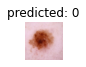

Actual: 0, predicted: 0


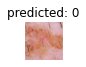

Actual: 0, predicted: 0


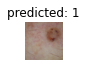

Actual: 0, predicted: 1


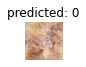

Actual: 0, predicted: 0


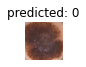

Actual: 0, predicted: 0


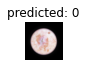

Actual: 0, predicted: 0


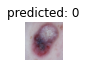

Actual: 0, predicted: 0


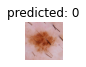

Actual: 0, predicted: 0


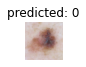

Actual: 0, predicted: 0


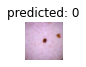

Actual: 0, predicted: 0


In [ ]:
visualize_model(densenet, val_loader, DEVICE, num_images=10)

#### Cross Entropy without sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/DenseNet/densenet_ce_all_data.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/DenseNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 10

EPOCHS = 100
WD = 1e-6

In [ ]:
densenet = make_densenet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(densenet.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model:Densenet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, without sampling')

Model:Densenet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_ce.pth'
densenet = train_model(densenet, dataloaders_balanced, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:56<00:00,  1.81it/s]

train epoch 1 : loss : 0.6454, acc: 0.7135, kappa: 0.5700



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 1 : loss : 0.3932, acc: 0.8551, kappa: 0.7447



Epoch 2/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.83it/s]

train epoch 2 : loss : 0.4739, acc: 0.8097, kappa: 0.7146



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 2 : loss : 0.3812, acc: 0.8591, kappa: 0.7468



Epoch 3/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 3 : loss : 0.3975, acc: 0.8434, kappa: 0.7650



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 3 : loss : 0.4111, acc: 0.8496, kappa: 0.7426



Epoch 4/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 4 : loss : 0.3461, acc: 0.8703, kappa: 0.8054



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 4 : loss : 0.3063, acc: 0.8921, kappa: 0.8053



Epoch 5/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 5 : loss : 0.3277, acc: 0.8772, kappa: 0.8158



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 5 : loss : 0.4295, acc: 0.8504, kappa: 0.7463



Epoch 6/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 6 : loss : 0.2621, acc: 0.9046, kappa: 0.8568



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 6 : loss : 0.2983, acc: 0.9031, kappa: 0.8303



Epoch 7/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 7 : loss : 0.2695, acc: 0.8989, kappa: 0.8483



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 7 : loss : 0.2890, acc: 0.8969, kappa: 0.8182



Epoch 8/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 8 : loss : 0.2402, acc: 0.9073, kappa: 0.8609



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 8 : loss : 0.2859, acc: 0.8969, kappa: 0.8189



Epoch 9/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 9 : loss : 0.2115, acc: 0.9260, kappa: 0.8890



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 9 : loss : 0.3180, acc: 0.9016, kappa: 0.8268



Epoch 10/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.85it/s]

train epoch 10 : loss : 0.1991, acc: 0.9235, kappa: 0.8852



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 10 : loss : 0.2809, acc: 0.9024, kappa: 0.8285



Epoch 11/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 11 : loss : 0.1917, acc: 0.9353, kappa: 0.9029



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 11 : loss : 0.2856, acc: 0.9024, kappa: 0.8292



Epoch 12/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 12 : loss : 0.1914, acc: 0.9303, kappa: 0.8955



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 12 : loss : 0.2707, acc: 0.9094, kappa: 0.8402



Epoch 13/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 13 : loss : 0.1864, acc: 0.9327, kappa: 0.8989



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 13 : loss : 0.2529, acc: 0.9181, kappa: 0.8526



Epoch 14/100
---------------


100%|██████████| 318/318 [02:54<00:00,  1.83it/s]

train epoch 14 : loss : 0.1626, acc: 0.9429, kappa: 0.9143



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 14 : loss : 0.2693, acc: 0.9118, kappa: 0.8459



Epoch 15/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 15 : loss : 0.1707, acc: 0.9394, kappa: 0.9090



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 15 : loss : 0.2731, acc: 0.9165, kappa: 0.8520



Epoch 16/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 16 : loss : 0.1386, acc: 0.9484, kappa: 0.9226



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 16 : loss : 0.2578, acc: 0.9252, kappa: 0.8647



Epoch 17/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 17 : loss : 0.1667, acc: 0.9431, kappa: 0.9147



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 17 : loss : 0.2928, acc: 0.9031, kappa: 0.8269



Epoch 18/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 18 : loss : 0.1458, acc: 0.9481, kappa: 0.9221



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 18 : loss : 0.2384, acc: 0.9236, kappa: 0.8639



Epoch 19/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 19 : loss : 0.1377, acc: 0.9524, kappa: 0.9286



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 19 : loss : 0.2813, acc: 0.9150, kappa: 0.8484



Epoch 20/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 20 : loss : 0.1310, acc: 0.9534, kappa: 0.9300



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 20 : loss : 0.3100, acc: 0.9039, kappa: 0.8327



Epoch 21/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 21 : loss : 0.1444, acc: 0.9494, kappa: 0.9241



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 21 : loss : 0.3003, acc: 0.9220, kappa: 0.8612



Epoch 22/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.84it/s]

train epoch 22 : loss : 0.1301, acc: 0.9530, kappa: 0.9294



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 22 : loss : 0.2904, acc: 0.9126, kappa: 0.8452



Epoch 23/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 23 : loss : 0.1267, acc: 0.9561, kappa: 0.9342



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 23 : loss : 0.2602, acc: 0.9102, kappa: 0.8408



Epoch 24/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 24 : loss : 0.1088, acc: 0.9642, kappa: 0.9463



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 24 : loss : 0.2634, acc: 0.9165, kappa: 0.8522



Epoch 25/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 25 : loss : 0.1293, acc: 0.9543, kappa: 0.9315



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 25 : loss : 0.2336, acc: 0.9268, kappa: 0.8676



Epoch 26/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 26 : loss : 0.1079, acc: 0.9624, kappa: 0.9436



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 26 : loss : 0.2050, acc: 0.9441, kappa: 0.9001



Epoch 27/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 27 : loss : 0.1265, acc: 0.9543, kappa: 0.9315



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 27 : loss : 0.2714, acc: 0.9213, kappa: 0.8597



Epoch 28/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 28 : loss : 0.0895, acc: 0.9707, kappa: 0.9560



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 28 : loss : 0.2716, acc: 0.9189, kappa: 0.8563



Epoch 29/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 29 : loss : 0.1074, acc: 0.9626, kappa: 0.9439



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 29 : loss : 0.2207, acc: 0.9339, kappa: 0.8820



Epoch 30/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.85it/s]

train epoch 30 : loss : 0.0965, acc: 0.9677, kappa: 0.9516



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 30 : loss : 0.2799, acc: 0.9244, kappa: 0.8650



Epoch 31/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 31 : loss : 0.0919, acc: 0.9644, kappa: 0.9466



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 31 : loss : 0.2241, acc: 0.9244, kappa: 0.8650



Epoch 32/100
---------------


 41%|████      | 130/318 [01:12<01:37,  1.93it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_ce.pth'
densenet = train_model(densenet, dataloaders_balanced, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 32/100
---------------


100%|██████████| 318/318 [10:16<00:00,  1.94s/it]


train epoch 32 : loss : 0.0835, acc: 0.9732, kappa: 0.9599


100%|██████████| 20/20 [04:14<00:00, 12.71s/it]

val epoch 32 : loss : 0.2468, acc: 0.9276, kappa: 0.8682



Epoch 33/100
---------------


100%|██████████| 318/318 [05:18<00:00,  1.00s/it]

train epoch 33 : loss : 0.1039, acc: 0.9628, kappa: 0.9442



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 33 : loss : 0.2376, acc: 0.9291, kappa: 0.8725



Epoch 34/100
---------------


100%|██████████| 318/318 [03:48<00:00,  1.39it/s]

train epoch 34 : loss : 0.0850, acc: 0.9679, kappa: 0.9519



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 34 : loss : 0.2452, acc: 0.9291, kappa: 0.8730



Epoch 35/100
---------------


100%|██████████| 318/318 [03:09<00:00,  1.68it/s]

train epoch 35 : loss : 0.0640, acc: 0.9799, kappa: 0.9699



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 35 : loss : 0.2160, acc: 0.9394, kappa: 0.8912



Epoch 36/100
---------------


100%|██████████| 318/318 [02:58<00:00,  1.78it/s]

train epoch 36 : loss : 0.0421, acc: 0.9868, kappa: 0.9802



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 36 : loss : 0.1951, acc: 0.9386, kappa: 0.8890



Epoch 37/100
---------------


100%|██████████| 318/318 [02:53<00:00,  1.83it/s]

train epoch 37 : loss : 0.0399, acc: 0.9876, kappa: 0.9814



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 37 : loss : 0.1921, acc: 0.9441, kappa: 0.8989



Epoch 38/100
---------------


100%|██████████| 318/318 [02:52<00:00,  1.85it/s]

train epoch 38 : loss : 0.0330, acc: 0.9878, kappa: 0.9817



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 38 : loss : 0.1866, acc: 0.9370, kappa: 0.8862



Epoch 39/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.85it/s]

train epoch 39 : loss : 0.0343, acc: 0.9886, kappa: 0.9829



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 39 : loss : 0.1786, acc: 0.9433, kappa: 0.8978



Epoch 40/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.86it/s]

train epoch 40 : loss : 0.0286, acc: 0.9917, kappa: 0.9876



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 40 : loss : 0.1792, acc: 0.9472, kappa: 0.9047



Epoch 41/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.86it/s]

train epoch 41 : loss : 0.0238, acc: 0.9927, kappa: 0.9891



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 41 : loss : 0.1682, acc: 0.9496, kappa: 0.9089



Epoch 42/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.87it/s]

train epoch 42 : loss : 0.0284, acc: 0.9898, kappa: 0.9847



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 42 : loss : 0.1787, acc: 0.9480, kappa: 0.9060



Epoch 43/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.87it/s]

train epoch 43 : loss : 0.0307, acc: 0.9898, kappa: 0.9847



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 43 : loss : 0.1821, acc: 0.9528, kappa: 0.9148



Epoch 44/100
---------------


100%|██████████| 318/318 [02:51<00:00,  1.86it/s]

train epoch 44 : loss : 0.0246, acc: 0.9915, kappa: 0.9873



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 44 : loss : 0.1760, acc: 0.9543, kappa: 0.9175



Epoch 45/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 45 : loss : 0.0258, acc: 0.9902, kappa: 0.9852



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 45 : loss : 0.1732, acc: 0.9465, kappa: 0.9031



Epoch 46/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.87it/s]

train epoch 46 : loss : 0.0231, acc: 0.9929, kappa: 0.9894



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 46 : loss : 0.1720, acc: 0.9472, kappa: 0.9048



Epoch 47/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 47 : loss : 0.0177, acc: 0.9955, kappa: 0.9932



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 47 : loss : 0.1741, acc: 0.9504, kappa: 0.9104



Epoch 48/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 48 : loss : 0.0194, acc: 0.9943, kappa: 0.9914



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 48 : loss : 0.1870, acc: 0.9457, kappa: 0.9018



Epoch 49/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 49 : loss : 0.0188, acc: 0.9937, kappa: 0.9906



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 49 : loss : 0.1808, acc: 0.9504, kappa: 0.9104



Epoch 50/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 50 : loss : 0.0198, acc: 0.9941, kappa: 0.9911



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 50 : loss : 0.1809, acc: 0.9528, kappa: 0.9150



Epoch 51/100
---------------


100%|██████████| 318/318 [02:50<00:00,  1.86it/s]

train epoch 51 : loss : 0.0187, acc: 0.9949, kappa: 0.9923



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 51 : loss : 0.1824, acc: 0.9472, kappa: 0.9045



Epoch 52/100
---------------


100%|██████████| 318/318 [02:49<00:00,  1.88it/s]

train epoch 52 : loss : 0.0158, acc: 0.9953, kappa: 0.9929



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 52 : loss : 0.1799, acc: 0.9465, kappa: 0.9029


EARLY STOP AFTER 52 EPOCHS
Training complete in 86m 13s
Best val loss: 0.168169
Best val Kappa: 0.9174940411118478


##### Test

In [ ]:
densenet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/densenet_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(densenet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

Test Loss: 0.1760 Acc: 0.9543, kappa: 0.9175
Testing complete in 0m 30s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1760, acc: 0.9543, kappa: 0.9175


Show some results

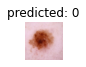

Actual: 0, predicted: 0


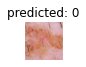

Actual: 0, predicted: 0


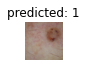

Actual: 0, predicted: 1


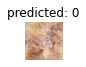

Actual: 0, predicted: 0


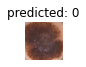

Actual: 0, predicted: 0


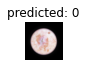

Actual: 0, predicted: 0


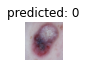

Actual: 0, predicted: 0


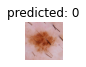

Actual: 0, predicted: 0


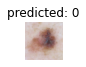

Actual: 0, predicted: 0


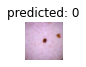

Actual: 0, predicted: 0


In [ ]:
visualize_model(densenet, val_loader, DEVICE, num_images=10)

## 3. Swin

### Train

#### With Focal Loss

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_fl.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 15

EPOCHS = 100
WD = 1e-6

In [ ]:
swin = make_swin(True, DEVICE)

criterion =  FocalLoss(alpha = class_weights, gamma = 2.0, size_average= True)

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_t-704ceda3.pth" to /root/.cache/torch/hub/checkpoints/swin_t-704ceda3.pth


  0%|          | 0.00/108M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:Swin, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6')

Model:Swin, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_fl_2.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:32<00:00,  2.08it/s]

train epoch 1 : loss : 0.3674, acc: 0.6143, kappa: 0.3941



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 1 : loss : 0.2763, acc: 0.6630, kappa: 0.4917



Epoch 2/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.12it/s]

train epoch 2 : loss : 0.2801, acc: 0.7115, kappa: 0.5332



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 2 : loss : 0.2474, acc: 0.6866, kappa: 0.5198



Epoch 3/100
---------------


100%|██████████| 318/318 [02:30<00:00,  2.11it/s]

train epoch 3 : loss : 0.2507, acc: 0.7576, kappa: 0.6010



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 3 : loss : 0.2547, acc: 0.6906, kappa: 0.5271



Epoch 4/100
---------------


100%|██████████| 318/318 [02:32<00:00,  2.09it/s]

train epoch 4 : loss : 0.2267, acc: 0.7637, kappa: 0.6104



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 4 : loss : 0.2258, acc: 0.7205, kappa: 0.5587



Epoch 5/100
---------------


100%|██████████| 318/318 [02:30<00:00,  2.11it/s]

train epoch 5 : loss : 0.2309, acc: 0.7609, kappa: 0.6077



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 5 : loss : 0.1887, acc: 0.8874, kappa: 0.7976



Epoch 6/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.12it/s]

train epoch 6 : loss : 0.1946, acc: 0.8044, kappa: 0.6724



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 6 : loss : 0.1826, acc: 0.8157, kappa: 0.6920



Epoch 7/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 7 : loss : 0.2056, acc: 0.7934, kappa: 0.6555



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 7 : loss : 0.1899, acc: 0.7575, kappa: 0.6171



Epoch 8/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 8 : loss : 0.2026, acc: 0.7936, kappa: 0.6571



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 8 : loss : 0.1886, acc: 0.8299, kappa: 0.7153



Epoch 9/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.12it/s]

train epoch 9 : loss : 0.1785, acc: 0.8290, kappa: 0.7091



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 9 : loss : 0.1581, acc: 0.8283, kappa: 0.7162



Epoch 10/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 10 : loss : 0.1796, acc: 0.8174, kappa: 0.6919



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 10 : loss : 0.2209, acc: 0.7677, kappa: 0.6254



Epoch 11/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 11 : loss : 0.1647, acc: 0.8323, kappa: 0.7141



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 11 : loss : 0.1688, acc: 0.8417, kappa: 0.7319



Epoch 12/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.18it/s]

train epoch 12 : loss : 0.1657, acc: 0.8306, kappa: 0.7119



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 12 : loss : 0.1617, acc: 0.8646, kappa: 0.7663



Epoch 13/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 13 : loss : 0.1484, acc: 0.8428, kappa: 0.7317



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 13 : loss : 0.1779, acc: 0.7992, kappa: 0.6645



Epoch 14/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 14 : loss : 0.1463, acc: 0.8575, kappa: 0.7555



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 14 : loss : 0.1927, acc: 0.8244, kappa: 0.7077



Epoch 15/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 15 : loss : 0.1454, acc: 0.8418, kappa: 0.7306



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 15 : loss : 0.1515, acc: 0.8110, kappa: 0.6908



Epoch 16/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 16 : loss : 0.1411, acc: 0.8503, kappa: 0.7441



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 16 : loss : 0.1954, acc: 0.7819, kappa: 0.6527



Epoch 17/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 17 : loss : 0.1419, acc: 0.8544, kappa: 0.7506



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 17 : loss : 0.1542, acc: 0.8354, kappa: 0.7189



Epoch 18/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 18 : loss : 0.1327, acc: 0.8589, kappa: 0.7572



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 18 : loss : 0.1356, acc: 0.8953, kappa: 0.8162



Epoch 19/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 19 : loss : 0.1213, acc: 0.8701, kappa: 0.7759



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 19 : loss : 0.1368, acc: 0.8512, kappa: 0.7505



Epoch 20/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 20 : loss : 0.1339, acc: 0.8646, kappa: 0.7672



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 20 : loss : 0.1689, acc: 0.8323, kappa: 0.7205



Epoch 21/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 21 : loss : 0.1246, acc: 0.8666, kappa: 0.7715



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 21 : loss : 0.1382, acc: 0.8898, kappa: 0.8078



Epoch 22/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 22 : loss : 0.1166, acc: 0.8756, kappa: 0.7856



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 22 : loss : 0.1218, acc: 0.8661, kappa: 0.7724



Epoch 23/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 23 : loss : 0.1118, acc: 0.8778, kappa: 0.7894



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 23 : loss : 0.1196, acc: 0.8984, kappa: 0.8210



Epoch 24/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 24 : loss : 0.1271, acc: 0.8798, kappa: 0.7926



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 24 : loss : 0.1408, acc: 0.8843, kappa: 0.7986



Epoch 25/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 25 : loss : 0.1168, acc: 0.8776, kappa: 0.7887



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 25 : loss : 0.1511, acc: 0.8976, kappa: 0.8181



Epoch 26/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 26 : loss : 0.1157, acc: 0.8731, kappa: 0.7812



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 26 : loss : 0.1510, acc: 0.8433, kappa: 0.7303



Epoch 27/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 27 : loss : 0.1062, acc: 0.8865, kappa: 0.8032



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 27 : loss : 0.1203, acc: 0.9063, kappa: 0.8342



Epoch 28/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 28 : loss : 0.1137, acc: 0.8754, kappa: 0.7855



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 28 : loss : 0.1011, acc: 0.8890, kappa: 0.8083



Epoch 29/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 29 : loss : 0.0940, acc: 0.8959, kappa: 0.8192



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 29 : loss : 0.1957, acc: 0.7528, kappa: 0.6071



Epoch 30/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 30 : loss : 0.1288, acc: 0.8650, kappa: 0.7680



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 30 : loss : 0.1285, acc: 0.9150, kappa: 0.8489



Epoch 31/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 31 : loss : 0.1064, acc: 0.8857, kappa: 0.8014



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 31 : loss : 0.1439, acc: 0.8976, kappa: 0.8201



Epoch 32/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 32 : loss : 0.1077, acc: 0.8857, kappa: 0.8012



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 32 : loss : 0.1153, acc: 0.8858, kappa: 0.8048



Epoch 33/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 33 : loss : 0.0925, acc: 0.8979, kappa: 0.8215



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 33 : loss : 0.0957, acc: 0.9008, kappa: 0.8284



Epoch 34/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 34 : loss : 0.0976, acc: 0.8975, kappa: 0.8218



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 34 : loss : 0.1208, acc: 0.8835, kappa: 0.8006



Epoch 35/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 35 : loss : 0.0904, acc: 0.9093, kappa: 0.8417



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 35 : loss : 0.1116, acc: 0.8866, kappa: 0.8041



Epoch 36/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.18it/s]

train epoch 36 : loss : 0.0954, acc: 0.9065, kappa: 0.8365



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 36 : loss : 0.1189, acc: 0.9197, kappa: 0.8569



Epoch 37/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.18it/s]

train epoch 37 : loss : 0.0813, acc: 0.9075, kappa: 0.8380



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 37 : loss : 0.1188, acc: 0.9165, kappa: 0.8526



Epoch 38/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 38 : loss : 0.0748, acc: 0.9170, kappa: 0.8542



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 38 : loss : 0.1407, acc: 0.8953, kappa: 0.8174



Epoch 39/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 39 : loss : 0.0932, acc: 0.9006, kappa: 0.8266



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 39 : loss : 0.1299, acc: 0.8921, kappa: 0.8117



Epoch 40/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 40 : loss : 0.0908, acc: 0.9030, kappa: 0.8312



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 40 : loss : 0.1254, acc: 0.8811, kappa: 0.7952



Epoch 41/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 41 : loss : 0.0872, acc: 0.9109, kappa: 0.8441



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 41 : loss : 0.1466, acc: 0.8661, kappa: 0.7698



Epoch 42/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 42 : loss : 0.0846, acc: 0.9087, kappa: 0.8412



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 42 : loss : 0.0939, acc: 0.9165, kappa: 0.8526



Epoch 43/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 43 : loss : 0.0542, acc: 0.9441, kappa: 0.9014



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 43 : loss : 0.0879, acc: 0.9150, kappa: 0.8506



Epoch 44/100
---------------


100%|██████████| 318/318 [02:30<00:00,  2.12it/s]

train epoch 44 : loss : 0.0451, acc: 0.9475, kappa: 0.9071



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 44 : loss : 0.0988, acc: 0.9291, kappa: 0.8736



Epoch 45/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.16it/s]

train epoch 45 : loss : 0.0428, acc: 0.9488, kappa: 0.9093



100%|██████████| 20/20 [00:31<00:00,  1.60s/it]

val epoch 45 : loss : 0.0864, acc: 0.9165, kappa: 0.8533



Epoch 46/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.16it/s]

train epoch 46 : loss : 0.0401, acc: 0.9512, kappa: 0.9135



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 46 : loss : 0.1025, acc: 0.9283, kappa: 0.8729



Epoch 47/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.13it/s]

train epoch 47 : loss : 0.0353, acc: 0.9555, kappa: 0.9209



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 47 : loss : 0.0943, acc: 0.9213, kappa: 0.8614



Epoch 48/100
---------------


 30%|███       | 96/318 [00:45<01:35,  2.32it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_fl_2.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 48/100
---------------


100%|██████████| 318/318 [15:34<00:00,  2.94s/it]

train epoch 48 : loss : 0.0399, acc: 0.9559, kappa: 0.9219



100%|██████████| 20/20 [04:44<00:00, 14.22s/it]

val epoch 48 : loss : 0.0902, acc: 0.9276, kappa: 0.8722



Epoch 49/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 49 : loss : 0.0388, acc: 0.9585, kappa: 0.9263



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 49 : loss : 0.0916, acc: 0.9315, kappa: 0.8787



Epoch 50/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 50 : loss : 0.0355, acc: 0.9579, kappa: 0.9252



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 50 : loss : 0.0878, acc: 0.9291, kappa: 0.8745



Epoch 51/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 51 : loss : 0.0322, acc: 0.9628, kappa: 0.9340



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 51 : loss : 0.0987, acc: 0.9299, kappa: 0.8747



Epoch 52/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 52 : loss : 0.0332, acc: 0.9603, kappa: 0.9292



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 52 : loss : 0.0864, acc: 0.9299, kappa: 0.8760



Epoch 53/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.19it/s]

train epoch 53 : loss : 0.0284, acc: 0.9677, kappa: 0.9426



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 53 : loss : 0.0932, acc: 0.9283, kappa: 0.8727



Epoch 54/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 54 : loss : 0.0304, acc: 0.9638, kappa: 0.9355



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 54 : loss : 0.0914, acc: 0.9283, kappa: 0.8728



Epoch 55/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 55 : loss : 0.0272, acc: 0.9685, kappa: 0.9438



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 55 : loss : 0.0927, acc: 0.9307, kappa: 0.8771



Epoch 56/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 56 : loss : 0.0263, acc: 0.9683, kappa: 0.9435



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 56 : loss : 0.0934, acc: 0.9307, kappa: 0.8769



Epoch 57/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 57 : loss : 0.0249, acc: 0.9701, kappa: 0.9467



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 57 : loss : 0.0954, acc: 0.9291, kappa: 0.8740



Epoch 58/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 58 : loss : 0.0275, acc: 0.9705, kappa: 0.9473



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 58 : loss : 0.0923, acc: 0.9291, kappa: 0.8743



Epoch 59/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 59 : loss : 0.0234, acc: 0.9725, kappa: 0.9509



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 59 : loss : 0.0936, acc: 0.9307, kappa: 0.8771



Epoch 60/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 60 : loss : 0.0254, acc: 0.9709, kappa: 0.9480



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 60 : loss : 0.0937, acc: 0.9323, kappa: 0.8798



Epoch 61/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 61 : loss : 0.0294, acc: 0.9671, kappa: 0.9414



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 61 : loss : 0.0907, acc: 0.9323, kappa: 0.8799


EARLY STOP AFTER 61 EPOCHS
Training complete in 58m 37s
Best val loss: 0.086373
Best val Kappa: 0.8799109832741794


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_fl_2_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

Test Loss: 0.0907 Acc: 0.9323, kappa: 0.8799
Testing complete in 0m 33s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.0907, acc: 0.9323, kappa: 0.8799


Show some results

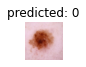

Actual: 0, predicted: 0


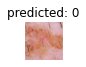

Actual: 0, predicted: 0


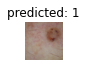

Actual: 0, predicted: 1


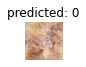

Actual: 0, predicted: 0


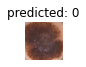

Actual: 0, predicted: 0


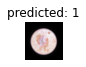

Actual: 0, predicted: 1


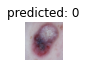

Actual: 0, predicted: 0


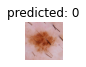

Actual: 0, predicted: 0


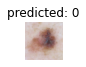

Actual: 0, predicted: 0


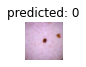

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### With Weighted cross entropy

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_wce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin(True, DEVICE)

criterion = nn.CrossEntropyLoss(weight=class_weights)

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model:swin, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model:swin, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_wce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [22:24<00:00,  4.23s/it]

train epoch 1 : loss : 0.8397, acc: 0.6785, kappa: 0.4597



100%|██████████| 20/20 [05:38<00:00, 16.90s/it]

val epoch 1 : loss : 0.7292, acc: 0.6795, kappa: 0.5073



Epoch 2/100
---------------


100%|██████████| 318/318 [02:32<00:00,  2.08it/s]

train epoch 2 : loss : 0.6859, acc: 0.7560, kappa: 0.5884



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 2 : loss : 0.4659, acc: 0.8465, kappa: 0.7336



Epoch 3/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 3 : loss : 0.6137, acc: 0.7869, kappa: 0.6397



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 3 : loss : 0.3925, acc: 0.8598, kappa: 0.7487



Epoch 4/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 4 : loss : 0.5743, acc: 0.8107, kappa: 0.6761



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 4 : loss : 0.5165, acc: 0.8134, kappa: 0.6830



Epoch 5/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 5 : loss : 0.5329, acc: 0.8200, kappa: 0.6912



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 5 : loss : 0.3566, acc: 0.8756, kappa: 0.7793



Epoch 6/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 6 : loss : 0.4725, acc: 0.8392, kappa: 0.7235



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 6 : loss : 0.4521, acc: 0.8283, kappa: 0.7103



Epoch 7/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 7 : loss : 0.4638, acc: 0.8337, kappa: 0.7156



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 7 : loss : 0.3254, acc: 0.8882, kappa: 0.8019



Epoch 8/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 8 : loss : 0.4734, acc: 0.8322, kappa: 0.7127



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 8 : loss : 0.3561, acc: 0.8654, kappa: 0.7678



Epoch 9/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 9 : loss : 0.4330, acc: 0.8449, kappa: 0.7336



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 9 : loss : 0.3835, acc: 0.8654, kappa: 0.7693



Epoch 10/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 10 : loss : 0.4248, acc: 0.8457, kappa: 0.7354



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 10 : loss : 0.3504, acc: 0.8732, kappa: 0.7798



Epoch 11/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.18it/s]

train epoch 11 : loss : 0.4131, acc: 0.8587, kappa: 0.7566



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 11 : loss : 0.3854, acc: 0.8346, kappa: 0.7246



Epoch 12/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 12 : loss : 0.3951, acc: 0.8493, kappa: 0.7406



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 12 : loss : 0.3469, acc: 0.8630, kappa: 0.7665



Epoch 13/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.16it/s]

train epoch 13 : loss : 0.3438, acc: 0.8786, kappa: 0.7895



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 13 : loss : 0.2861, acc: 0.8992, kappa: 0.8210



Epoch 14/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 14 : loss : 0.3768, acc: 0.8721, kappa: 0.7793



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 14 : loss : 0.2796, acc: 0.8992, kappa: 0.8242



Epoch 15/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 15 : loss : 0.3058, acc: 0.8863, kappa: 0.8026



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 15 : loss : 0.3045, acc: 0.8906, kappa: 0.8095



Epoch 16/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.13it/s]

train epoch 16 : loss : 0.3244, acc: 0.8886, kappa: 0.8064



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 16 : loss : 0.3274, acc: 0.8787, kappa: 0.7918



Epoch 17/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 17 : loss : 0.3004, acc: 0.8953, kappa: 0.8168



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 17 : loss : 0.3489, acc: 0.8827, kappa: 0.7954



Epoch 18/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 18 : loss : 0.3167, acc: 0.8924, kappa: 0.8123



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 18 : loss : 0.3153, acc: 0.8969, kappa: 0.8212



Epoch 19/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 19 : loss : 0.2728, acc: 0.9085, kappa: 0.8395



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 19 : loss : 0.2920, acc: 0.8969, kappa: 0.8206



Epoch 20/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 20 : loss : 0.2915, acc: 0.9026, kappa: 0.8301



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 20 : loss : 0.3450, acc: 0.8890, kappa: 0.8085



Epoch 21/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 21 : loss : 0.2677, acc: 0.9083, kappa: 0.8395



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 21 : loss : 0.3082, acc: 0.8961, kappa: 0.8195



Epoch 22/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 22 : loss : 0.2579, acc: 0.9124, kappa: 0.8461



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 22 : loss : 0.4015, acc: 0.8638, kappa: 0.7626



Epoch 23/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 23 : loss : 0.1914, acc: 0.9313, kappa: 0.8791



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 23 : loss : 0.2204, acc: 0.9276, kappa: 0.8717



Epoch 24/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.18it/s]

train epoch 24 : loss : 0.1611, acc: 0.9376, kappa: 0.8897



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 24 : loss : 0.2236, acc: 0.9346, kappa: 0.8849



Epoch 25/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 25 : loss : 0.1443, acc: 0.9492, kappa: 0.9102



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 25 : loss : 0.2154, acc: 0.9346, kappa: 0.8844



Epoch 26/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 26 : loss : 0.1378, acc: 0.9536, kappa: 0.9176



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 26 : loss : 0.2044, acc: 0.9409, kappa: 0.8951



Epoch 27/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 27 : loss : 0.1299, acc: 0.9522, kappa: 0.9152



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 27 : loss : 0.2006, acc: 0.9409, kappa: 0.8953



Epoch 28/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 28 : loss : 0.1157, acc: 0.9567, kappa: 0.9231



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 28 : loss : 0.2035, acc: 0.9433, kappa: 0.8988



Epoch 29/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 29 : loss : 0.1146, acc: 0.9571, kappa: 0.9237



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 29 : loss : 0.1993, acc: 0.9425, kappa: 0.8971



Epoch 30/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 30 : loss : 0.1011, acc: 0.9626, kappa: 0.9334



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 30 : loss : 0.2018, acc: 0.9465, kappa: 0.9043



Epoch 31/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 31 : loss : 0.1047, acc: 0.9652, kappa: 0.9380



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 31 : loss : 0.1939, acc: 0.9457, kappa: 0.9033



Epoch 32/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 32 : loss : 0.1093, acc: 0.9634, kappa: 0.9348



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 32 : loss : 0.1998, acc: 0.9449, kappa: 0.9020



Epoch 33/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.18it/s]

train epoch 33 : loss : 0.1099, acc: 0.9601, kappa: 0.9289



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 33 : loss : 0.1807, acc: 0.9496, kappa: 0.9099



Epoch 34/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 34 : loss : 0.1098, acc: 0.9636, kappa: 0.9351



100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 34 : loss : 0.1950, acc: 0.9457, kappa: 0.9033



Epoch 35/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 35 : loss : 0.0846, acc: 0.9693, kappa: 0.9452



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 35 : loss : 0.1927, acc: 0.9417, kappa: 0.8962



Epoch 36/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 36 : loss : 0.0899, acc: 0.9681, kappa: 0.9431



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 36 : loss : 0.1999, acc: 0.9496, kappa: 0.9098



Epoch 37/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 37 : loss : 0.0805, acc: 0.9695, kappa: 0.9456



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 37 : loss : 0.2127, acc: 0.9472, kappa: 0.9058



Epoch 38/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 38 : loss : 0.0820, acc: 0.9689, kappa: 0.9445



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 38 : loss : 0.2045, acc: 0.9496, kappa: 0.9098



Epoch 39/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 39 : loss : 0.0851, acc: 0.9685, kappa: 0.9438



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 39 : loss : 0.1967, acc: 0.9472, kappa: 0.9060



Epoch 40/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 40 : loss : 0.0903, acc: 0.9707, kappa: 0.9477



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 40 : loss : 0.2074, acc: 0.9457, kappa: 0.9032



Epoch 41/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 41 : loss : 0.0734, acc: 0.9728, kappa: 0.9515



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 41 : loss : 0.1946, acc: 0.9504, kappa: 0.9107



Epoch 42/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 42 : loss : 0.0843, acc: 0.9738, kappa: 0.9531



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 42 : loss : 0.1903, acc: 0.9512, kappa: 0.9123



Epoch 43/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 43 : loss : 0.0723, acc: 0.9736, kappa: 0.9529



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 43 : loss : 0.1907, acc: 0.9528, kappa: 0.9153



Epoch 44/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 44 : loss : 0.0757, acc: 0.9728, kappa: 0.9514



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 44 : loss : 0.1896, acc: 0.9504, kappa: 0.9111



Epoch 45/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 45 : loss : 0.0641, acc: 0.9738, kappa: 0.9533



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 45 : loss : 0.1911, acc: 0.9520, kappa: 0.9140



Epoch 46/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 46 : loss : 0.0679, acc: 0.9774, kappa: 0.9595



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 46 : loss : 0.1908, acc: 0.9520, kappa: 0.9140


EARLY STOP AFTER 46 EPOCHS
Training complete in 162m 14s
Best val loss: 0.180697
Best val Kappa: 0.9152757208234933


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_wce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

Test Loss: 0.1907 Acc: 0.9528, kappa: 0.9153
Testing complete in 0m 31s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1907, acc: 0.9528, kappa: 0.9153


Show some results

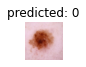

Actual: 0, predicted: 0


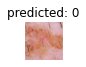

Actual: 0, predicted: 0


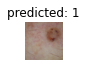

Actual: 0, predicted: 1


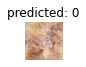

Actual: 0, predicted: 0


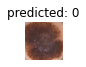

Actual: 0, predicted: 0


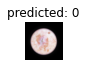

Actual: 0, predicted: 0


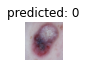

Actual: 0, predicted: 0


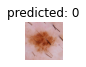

Actual: 0, predicted: 0


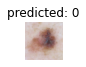

Actual: 0, predicted: 0


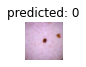

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Cross Entropy with sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_ce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-6

In [ ]:
swin = make_swin(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model:Swin, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling')

Model:Swin, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': mean_samples,
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce_sampling.pth'
swin = train_model(swin, dataloaders_balanced, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.19it/s]

train epoch 1 : loss : 0.7182, acc: 0.6769, kappa: 0.5153



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 1 : loss : 0.5220, acc: 0.7764, kappa: 0.6350



Epoch 2/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 2 : loss : 0.5456, acc: 0.7731, kappa: 0.6597



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 2 : loss : 0.3758, acc: 0.8535, kappa: 0.7467



Epoch 3/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.19it/s]

train epoch 3 : loss : 0.4471, acc: 0.8188, kappa: 0.7282



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 3 : loss : 0.3540, acc: 0.8591, kappa: 0.7493



Epoch 4/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 4 : loss : 0.3610, acc: 0.8611, kappa: 0.7916



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 4 : loss : 0.3060, acc: 0.8953, kappa: 0.8133



Epoch 5/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 5 : loss : 0.3387, acc: 0.8699, kappa: 0.8049



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 5 : loss : 0.3488, acc: 0.8709, kappa: 0.7798



Epoch 6/100
---------------


100%|██████████| 318/318 [02:21<00:00,  2.25it/s]

train epoch 6 : loss : 0.2917, acc: 0.8924, kappa: 0.8385



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 6 : loss : 0.3398, acc: 0.8803, kappa: 0.7943



Epoch 7/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 7 : loss : 0.2725, acc: 0.8993, kappa: 0.8488



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 7 : loss : 0.2619, acc: 0.9094, kappa: 0.8348



Epoch 8/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 8 : loss : 0.2522, acc: 0.9095, kappa: 0.8641



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 8 : loss : 0.3733, acc: 0.8850, kappa: 0.7987



Epoch 9/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.19it/s]

train epoch 9 : loss : 0.2283, acc: 0.9181, kappa: 0.8772



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 9 : loss : 0.2669, acc: 0.9134, kappa: 0.8477



Epoch 10/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 10 : loss : 0.2188, acc: 0.9209, kappa: 0.8813



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 10 : loss : 0.2880, acc: 0.9047, kappa: 0.8357



Epoch 11/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 11 : loss : 0.1850, acc: 0.9370, kappa: 0.9055



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 11 : loss : 0.2823, acc: 0.9055, kappa: 0.8336



Epoch 12/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.22it/s]

train epoch 12 : loss : 0.1882, acc: 0.9347, kappa: 0.9020



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 12 : loss : 0.2238, acc: 0.9291, kappa: 0.8712



Epoch 13/100
---------------


100%|██████████| 318/318 [02:21<00:00,  2.24it/s]

train epoch 13 : loss : 0.1757, acc: 0.9359, kappa: 0.9037



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 13 : loss : 0.2369, acc: 0.9236, kappa: 0.8640



Epoch 14/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 14 : loss : 0.1746, acc: 0.9339, kappa: 0.9008



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 14 : loss : 0.2630, acc: 0.9205, kappa: 0.8606



Epoch 15/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 15 : loss : 0.1594, acc: 0.9402, kappa: 0.9103



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 15 : loss : 0.2315, acc: 0.9291, kappa: 0.8750



Epoch 16/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 16 : loss : 0.1647, acc: 0.9423, kappa: 0.9135



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 16 : loss : 0.1984, acc: 0.9299, kappa: 0.8751



Epoch 17/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 17 : loss : 0.1433, acc: 0.9486, kappa: 0.9229



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 17 : loss : 0.1745, acc: 0.9457, kappa: 0.9022



Epoch 18/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 18 : loss : 0.1443, acc: 0.9484, kappa: 0.9227



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 18 : loss : 0.2425, acc: 0.9244, kappa: 0.8656



Epoch 19/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 19 : loss : 0.1508, acc: 0.9437, kappa: 0.9156



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 19 : loss : 0.2215, acc: 0.9283, kappa: 0.8731



Epoch 20/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 20 : loss : 0.1254, acc: 0.9589, kappa: 0.9383



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 20 : loss : 0.2259, acc: 0.9323, kappa: 0.8793



Epoch 21/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 21 : loss : 0.1443, acc: 0.9467, kappa: 0.9200



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 21 : loss : 0.2039, acc: 0.9299, kappa: 0.8748



Epoch 22/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 22 : loss : 0.1277, acc: 0.9530, kappa: 0.9295



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 22 : loss : 0.2152, acc: 0.9339, kappa: 0.8801



Epoch 23/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 23 : loss : 0.1329, acc: 0.9551, kappa: 0.9327



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 23 : loss : 0.2122, acc: 0.9339, kappa: 0.8808



Epoch 24/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 24 : loss : 0.1151, acc: 0.9589, kappa: 0.9383



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 24 : loss : 0.2309, acc: 0.9291, kappa: 0.8721



Epoch 25/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 25 : loss : 0.1162, acc: 0.9593, kappa: 0.9389



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 25 : loss : 0.1900, acc: 0.9394, kappa: 0.8912



Epoch 26/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 26 : loss : 0.0770, acc: 0.9703, kappa: 0.9554



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 26 : loss : 0.1575, acc: 0.9496, kappa: 0.9098



Epoch 27/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 27 : loss : 0.0557, acc: 0.9809, kappa: 0.9714



100%|██████████| 20/20 [00:29<00:00,  1.45s/it]

val epoch 27 : loss : 0.1527, acc: 0.9520, kappa: 0.9139



Epoch 28/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 28 : loss : 0.0442, acc: 0.9852, kappa: 0.9779



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 28 : loss : 0.1549, acc: 0.9520, kappa: 0.9139



Epoch 29/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 29 : loss : 0.0493, acc: 0.9843, kappa: 0.9764



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 29 : loss : 0.1548, acc: 0.9543, kappa: 0.9181



Epoch 30/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 30 : loss : 0.0466, acc: 0.9848, kappa: 0.9773



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 30 : loss : 0.1503, acc: 0.9567, kappa: 0.9224



Epoch 31/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.20it/s]

train epoch 31 : loss : 0.0402, acc: 0.9847, kappa: 0.9770



100%|██████████| 20/20 [00:28<00:00,  1.45s/it]

val epoch 31 : loss : 0.1547, acc: 0.9567, kappa: 0.9222



Epoch 32/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.21it/s]

train epoch 32 : loss : 0.0363, acc: 0.9888, kappa: 0.9832



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 32 : loss : 0.1547, acc: 0.9583, kappa: 0.9254



Epoch 33/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 33 : loss : 0.0345, acc: 0.9882, kappa: 0.9823



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 33 : loss : 0.1638, acc: 0.9567, kappa: 0.9222



Epoch 34/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 34 : loss : 0.0286, acc: 0.9908, kappa: 0.9861



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 34 : loss : 0.1614, acc: 0.9591, kappa: 0.9264



Epoch 35/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.19it/s]

train epoch 35 : loss : 0.0332, acc: 0.9888, kappa: 0.9832



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 35 : loss : 0.1628, acc: 0.9575, kappa: 0.9236



Epoch 36/100
---------------


100%|██████████| 318/318 [02:21<00:00,  2.24it/s]

train epoch 36 : loss : 0.0341, acc: 0.9870, kappa: 0.9805



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 36 : loss : 0.1578, acc: 0.9543, kappa: 0.9177



Epoch 37/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 37 : loss : 0.0296, acc: 0.9913, kappa: 0.9870



100%|██████████| 20/20 [00:28<00:00,  1.41s/it]

val epoch 37 : loss : 0.1579, acc: 0.9622, kappa: 0.9320



Epoch 38/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 38 : loss : 0.0269, acc: 0.9911, kappa: 0.9867



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 38 : loss : 0.1614, acc: 0.9606, kappa: 0.9293



Epoch 39/100
---------------


100%|██████████| 318/318 [02:22<00:00,  2.23it/s]

train epoch 39 : loss : 0.0298, acc: 0.9908, kappa: 0.9861



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 39 : loss : 0.1631, acc: 0.9606, kappa: 0.9291



Epoch 40/100
---------------


100%|██████████| 318/318 [02:24<00:00,  2.21it/s]

train epoch 40 : loss : 0.0261, acc: 0.9919, kappa: 0.9879



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 40 : loss : 0.1604, acc: 0.9614, kappa: 0.9307



Epoch 41/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 41 : loss : 0.0223, acc: 0.9923, kappa: 0.9885



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 41 : loss : 0.1601, acc: 0.9598, kappa: 0.9279



Epoch 42/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 42 : loss : 0.0247, acc: 0.9898, kappa: 0.9846



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 42 : loss : 0.1612, acc: 0.9606, kappa: 0.9293



Epoch 43/100
---------------


100%|██████████| 318/318 [02:23<00:00,  2.22it/s]

train epoch 43 : loss : 0.0283, acc: 0.9892, kappa: 0.9838



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 43 : loss : 0.1627, acc: 0.9598, kappa: 0.9279


EARLY STOP AFTER 43 EPOCHS
Training complete in 124m 44s
Best val loss: 0.150274
Best val Kappa: 0.9319861473097932


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce_sampling_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [08:08<00:00, 24.44s/it]

Test Loss: 0.1579 Acc: 0.9622, kappa: 0.9320
Testing complete in 8m 9s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1579, acc: 0.9622, kappa: 0.9320


Show some results

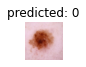

Actual: 0, predicted: 0


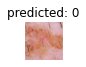

Actual: 0, predicted: 0


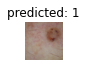

Actual: 0, predicted: 1


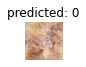

Actual: 0, predicted: 0


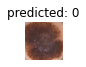

Actual: 0, predicted: 0


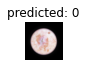

Actual: 0, predicted: 0


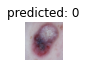

Actual: 0, predicted: 0


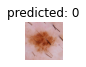

Actual: 0, predicted: 0


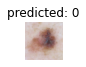

Actual: 0, predicted: 0


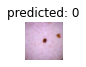

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Cross entropy without sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_ce_all.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_t-704ceda3.pth" to /root/.cache/torch/hub/checkpoints/swin_t-704ceda3.pth


  0%|          | 0.00/108M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling')

Model:swin, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 11/100
---------------


100%|██████████| 318/318 [13:12<00:00,  2.49s/it]

train epoch 11 : loss : 0.2199, acc: 0.9187, kappa: 0.8522



100%|██████████| 20/20 [02:59<00:00,  8.96s/it]

val epoch 11 : loss : 0.2585, acc: 0.9157, kappa: 0.8509



Epoch 12/100
---------------


100%|██████████| 318/318 [02:30<00:00,  2.11it/s]

train epoch 12 : loss : 0.2197, acc: 0.9179, kappa: 0.8513



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 12 : loss : 0.2789, acc: 0.9134, kappa: 0.8390



Epoch 13/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.13it/s]

train epoch 13 : loss : 0.1985, acc: 0.9266, kappa: 0.8671



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 13 : loss : 0.2106, acc: 0.9260, kappa: 0.8666



Epoch 14/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 14 : loss : 0.1773, acc: 0.9380, kappa: 0.8875



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 14 : loss : 0.2276, acc: 0.9331, kappa: 0.8780



Epoch 15/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 15 : loss : 0.1723, acc: 0.9368, kappa: 0.8855



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 15 : loss : 0.2172, acc: 0.9252, kappa: 0.8641



Epoch 16/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 16 : loss : 0.1807, acc: 0.9327, kappa: 0.8781



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 16 : loss : 0.1792, acc: 0.9441, kappa: 0.8980



Epoch 17/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 17 : loss : 0.1472, acc: 0.9461, kappa: 0.9025



100%|██████████| 20/20 [00:32<00:00,  1.60s/it]

val epoch 17 : loss : 0.1961, acc: 0.9425, kappa: 0.8959



Epoch 18/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 18 : loss : 0.1599, acc: 0.9398, kappa: 0.8911



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 18 : loss : 0.1763, acc: 0.9378, kappa: 0.8875



Epoch 19/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 19 : loss : 0.1639, acc: 0.9394, kappa: 0.8904



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 19 : loss : 0.1693, acc: 0.9425, kappa: 0.8960



Epoch 20/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.12it/s]

train epoch 20 : loss : 0.1340, acc: 0.9551, kappa: 0.9189



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 20 : loss : 0.2051, acc: 0.9433, kappa: 0.8972



Epoch 21/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 21 : loss : 0.1507, acc: 0.9445, kappa: 0.8998



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 21 : loss : 0.1703, acc: 0.9441, kappa: 0.8988



Epoch 22/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 22 : loss : 0.1295, acc: 0.9508, kappa: 0.9112



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 22 : loss : 0.1791, acc: 0.9386, kappa: 0.8883



Epoch 23/100
---------------


100%|██████████| 318/318 [02:30<00:00,  2.12it/s]

train epoch 23 : loss : 0.1269, acc: 0.9506, kappa: 0.9108



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 23 : loss : 0.1938, acc: 0.9417, kappa: 0.8967



Epoch 24/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 24 : loss : 0.1308, acc: 0.9536, kappa: 0.9162



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 24 : loss : 0.1558, acc: 0.9449, kappa: 0.9001



Epoch 25/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 25 : loss : 0.1225, acc: 0.9583, kappa: 0.9247



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 25 : loss : 0.1840, acc: 0.9504, kappa: 0.9104



Epoch 26/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 26 : loss : 0.1065, acc: 0.9632, kappa: 0.9335



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 26 : loss : 0.1738, acc: 0.9425, kappa: 0.8973



Epoch 27/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 27 : loss : 0.1166, acc: 0.9591, kappa: 0.9261



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 27 : loss : 0.1732, acc: 0.9409, kappa: 0.8935



Epoch 28/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 28 : loss : 0.1179, acc: 0.9597, kappa: 0.9272



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 28 : loss : 0.2123, acc: 0.9339, kappa: 0.8820



Epoch 29/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 29 : loss : 0.1139, acc: 0.9593, kappa: 0.9264



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 29 : loss : 0.1951, acc: 0.9378, kappa: 0.8886



Epoch 30/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 30 : loss : 0.1173, acc: 0.9597, kappa: 0.9272



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 30 : loss : 0.1758, acc: 0.9433, kappa: 0.8995



Epoch 31/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 31 : loss : 0.1065, acc: 0.9606, kappa: 0.9290



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 31 : loss : 0.1657, acc: 0.9504, kappa: 0.9106



Epoch 32/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 32 : loss : 0.1001, acc: 0.9660, kappa: 0.9387



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 32 : loss : 0.1961, acc: 0.9394, kappa: 0.8899



Epoch 33/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 33 : loss : 0.0730, acc: 0.9770, kappa: 0.9584



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 33 : loss : 0.1554, acc: 0.9528, kappa: 0.9155



Epoch 34/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 34 : loss : 0.0542, acc: 0.9811, kappa: 0.9660



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 34 : loss : 0.1527, acc: 0.9488, kappa: 0.9080



Epoch 35/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 35 : loss : 0.0480, acc: 0.9829, kappa: 0.9692



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 35 : loss : 0.1449, acc: 0.9567, kappa: 0.9223



Epoch 36/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 36 : loss : 0.0359, acc: 0.9874, kappa: 0.9773



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 36 : loss : 0.1439, acc: 0.9559, kappa: 0.9208



Epoch 37/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 37 : loss : 0.0364, acc: 0.9874, kappa: 0.9773



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 37 : loss : 0.1503, acc: 0.9559, kappa: 0.9210



Epoch 38/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.12it/s]

train epoch 38 : loss : 0.0301, acc: 0.9915, kappa: 0.9848



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 38 : loss : 0.1565, acc: 0.9567, kappa: 0.9221



Epoch 39/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 39 : loss : 0.0314, acc: 0.9894, kappa: 0.9809



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 39 : loss : 0.1515, acc: 0.9528, kappa: 0.9151



Epoch 40/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.16it/s]

train epoch 40 : loss : 0.0241, acc: 0.9923, kappa: 0.9862



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 40 : loss : 0.1532, acc: 0.9567, kappa: 0.9221



Epoch 41/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 41 : loss : 0.0312, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 41 : loss : 0.1547, acc: 0.9575, kappa: 0.9238



Epoch 42/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 42 : loss : 0.0307, acc: 0.9894, kappa: 0.9809



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 42 : loss : 0.1467, acc: 0.9575, kappa: 0.9236



Epoch 43/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 43 : loss : 0.0287, acc: 0.9902, kappa: 0.9823



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 43 : loss : 0.1438, acc: 0.9606, kappa: 0.9296



Epoch 44/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 44 : loss : 0.0239, acc: 0.9908, kappa: 0.9833



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 44 : loss : 0.1537, acc: 0.9598, kappa: 0.9282



Epoch 45/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 45 : loss : 0.0256, acc: 0.9900, kappa: 0.9819



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 45 : loss : 0.1468, acc: 0.9622, kappa: 0.9324



Epoch 46/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 46 : loss : 0.0256, acc: 0.9904, kappa: 0.9826



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 46 : loss : 0.1498, acc: 0.9591, kappa: 0.9268



Epoch 47/100
---------------


100%|██████████| 318/318 [02:29<00:00,  2.13it/s]

train epoch 47 : loss : 0.0207, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:30<00:00,  1.50s/it]

val epoch 47 : loss : 0.1465, acc: 0.9614, kappa: 0.9308



Epoch 48/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.16it/s]

train epoch 48 : loss : 0.0278, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 48 : loss : 0.1408, acc: 0.9606, kappa: 0.9290



Epoch 49/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.15it/s]

train epoch 49 : loss : 0.0221, acc: 0.9931, kappa: 0.9876



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 49 : loss : 0.1444, acc: 0.9606, kappa: 0.9292



Epoch 50/100
---------------


100%|██████████| 318/318 [02:27<00:00,  2.15it/s]

train epoch 50 : loss : 0.0175, acc: 0.9933, kappa: 0.9880



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 50 : loss : 0.1523, acc: 0.9575, kappa: 0.9240



Epoch 51/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 51 : loss : 0.0175, acc: 0.9937, kappa: 0.9887



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 51 : loss : 0.1554, acc: 0.9646, kappa: 0.9363



Epoch 52/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.16it/s]

train epoch 52 : loss : 0.0239, acc: 0.9913, kappa: 0.9844



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 52 : loss : 0.1455, acc: 0.9638, kappa: 0.9352



Epoch 53/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.18it/s]

train epoch 53 : loss : 0.0198, acc: 0.9945, kappa: 0.9901



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 53 : loss : 0.1344, acc: 0.9661, kappa: 0.9392



Epoch 54/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 54 : loss : 0.0183, acc: 0.9939, kappa: 0.9890



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 54 : loss : 0.1449, acc: 0.9646, kappa: 0.9365



Epoch 55/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 55 : loss : 0.0201, acc: 0.9919, kappa: 0.9855



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 55 : loss : 0.1564, acc: 0.9630, kappa: 0.9337



Epoch 56/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.13it/s]

train epoch 56 : loss : 0.0171, acc: 0.9957, kappa: 0.9922



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 56 : loss : 0.1478, acc: 0.9646, kappa: 0.9363



Epoch 57/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 57 : loss : 0.0187, acc: 0.9939, kappa: 0.9890



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 57 : loss : 0.1458, acc: 0.9669, kappa: 0.9406



Epoch 58/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 58 : loss : 0.0139, acc: 0.9953, kappa: 0.9915



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 58 : loss : 0.1542, acc: 0.9638, kappa: 0.9349



Epoch 59/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 59 : loss : 0.0195, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 59 : loss : 0.1568, acc: 0.9622, kappa: 0.9323



Epoch 60/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.18it/s]

train epoch 60 : loss : 0.0185, acc: 0.9933, kappa: 0.9880



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 60 : loss : 0.1535, acc: 0.9614, kappa: 0.9309



Epoch 61/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 61 : loss : 0.0171, acc: 0.9941, kappa: 0.9894



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 61 : loss : 0.1690, acc: 0.9630, kappa: 0.9334



Epoch 62/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.17it/s]

train epoch 62 : loss : 0.0127, acc: 0.9963, kappa: 0.9933



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 62 : loss : 0.1603, acc: 0.9622, kappa: 0.9320



Epoch 63/100
---------------


100%|██████████| 318/318 [02:26<00:00,  2.18it/s]

train epoch 63 : loss : 0.0173, acc: 0.9939, kappa: 0.9890



100%|██████████| 20/20 [00:29<00:00,  1.48s/it]

val epoch 63 : loss : 0.1572, acc: 0.9622, kappa: 0.9321



Epoch 64/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 64 : loss : 0.0138, acc: 0.9953, kappa: 0.9915



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 64 : loss : 0.1559, acc: 0.9622, kappa: 0.9321



Epoch 65/100
---------------


100%|██████████| 318/318 [02:25<00:00,  2.18it/s]

train epoch 65 : loss : 0.0136, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 65 : loss : 0.1533, acc: 0.9638, kappa: 0.9350



Epoch 66/100
---------------


100%|██████████| 318/318 [02:28<00:00,  2.14it/s]

train epoch 66 : loss : 0.0166, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 66 : loss : 0.1517, acc: 0.9630, kappa: 0.9335


EARLY STOP AFTER 66 EPOCHS
Training complete in 181m 8s
Best val loss: 0.134412
Best val Kappa: 0.9405978965374387


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

Test Loss: 0.1458 Acc: 0.9669, kappa: 0.9406
Testing complete in 0m 31s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1458, acc: 0.9669, kappa: 0.9406


Show some results

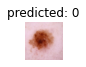

Actual: 0, predicted: 0


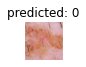

Actual: 0, predicted: 0


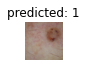

Actual: 0, predicted: 1


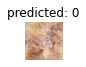

Actual: 0, predicted: 0


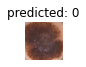

Actual: 0, predicted: 0


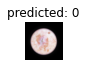

Actual: 0, predicted: 0


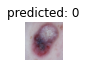

Actual: 0, predicted: 0


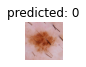

Actual: 0, predicted: 0


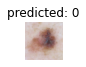

Actual: 0, predicted: 0


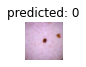

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

## 4. EfficientNet

### Train

#### With Focal Loss

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/EfficientNet/efficientnet_fl.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/EfficientNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 15

EPOCHS = 100
WD = 1e-6

In [ ]:
efficientnet = make_efficientnet(True, DEVICE)

criterion =  FocalLoss(alpha = class_weights, gamma = 2.0, size_average= True)

optimizer = optim.Adam(efficientnet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6')

Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: FL, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_fl.pth'
efficientnet = train_model(efficientnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [32:52<00:00,  6.20s/it]


train epoch 1 : loss : 0.3458, acc: 0.6458, kappa: 0.4359


100%|██████████| 20/20 [08:19<00:00, 24.95s/it]

val epoch 1 : loss : 0.2231, acc: 0.8291, kappa: 0.7023



Epoch 2/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]


train epoch 2 : loss : 0.2553, acc: 0.7444, kappa: 0.5768


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 2 : loss : 0.1734, acc: 0.8402, kappa: 0.7299



Epoch 3/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 3 : loss : 0.2182, acc: 0.7715, kappa: 0.6202



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 3 : loss : 0.1692, acc: 0.8268, kappa: 0.7098



Epoch 4/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 4 : loss : 0.1959, acc: 0.7932, kappa: 0.6541



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 4 : loss : 0.1578, acc: 0.8551, kappa: 0.7509



Epoch 5/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 5 : loss : 0.1906, acc: 0.7989, kappa: 0.6608



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 5 : loss : 0.1444, acc: 0.8528, kappa: 0.7503



Epoch 6/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 6 : loss : 0.1587, acc: 0.8339, kappa: 0.7172



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 6 : loss : 0.1434, acc: 0.8740, kappa: 0.7823



Epoch 7/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 7 : loss : 0.1670, acc: 0.8316, kappa: 0.7141



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 7 : loss : 0.1388, acc: 0.8465, kappa: 0.7422



Epoch 8/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 8 : loss : 0.1398, acc: 0.8503, kappa: 0.7432



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 8 : loss : 0.1268, acc: 0.8693, kappa: 0.7762



Epoch 9/100
---------------


100%|██████████| 318/318 [02:14<00:00,  2.36it/s]

train epoch 9 : loss : 0.1404, acc: 0.8449, kappa: 0.7353



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 9 : loss : 0.1398, acc: 0.8976, kappa: 0.8176



Epoch 10/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 10 : loss : 0.1156, acc: 0.8743, kappa: 0.7827



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 10 : loss : 0.1240, acc: 0.8764, kappa: 0.7897



Epoch 11/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 11 : loss : 0.1231, acc: 0.8697, kappa: 0.7753



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 11 : loss : 0.1029, acc: 0.8850, kappa: 0.8032



Epoch 12/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 12 : loss : 0.1174, acc: 0.8707, kappa: 0.7764



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 12 : loss : 0.1116, acc: 0.8331, kappa: 0.7240



Epoch 13/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]


train epoch 13 : loss : 0.1043, acc: 0.8843, kappa: 0.7993


100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 13 : loss : 0.0960, acc: 0.9039, kappa: 0.8327



Epoch 14/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.41it/s]

train epoch 14 : loss : 0.0989, acc: 0.8924, kappa: 0.8130



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 14 : loss : 0.1053, acc: 0.9260, kappa: 0.8689



Epoch 15/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 15 : loss : 0.0917, acc: 0.8998, kappa: 0.8251



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 15 : loss : 0.1126, acc: 0.9039, kappa: 0.8320



Epoch 16/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 16 : loss : 0.0909, acc: 0.9006, kappa: 0.8262



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 16 : loss : 0.1083, acc: 0.8858, kappa: 0.8043



Epoch 17/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 17 : loss : 0.0864, acc: 0.9085, kappa: 0.8395



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 17 : loss : 0.1193, acc: 0.9118, kappa: 0.8445



Epoch 18/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.44it/s]

train epoch 18 : loss : 0.0962, acc: 0.8914, kappa: 0.8109



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 18 : loss : 0.0958, acc: 0.8953, kappa: 0.8194



Epoch 19/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.39it/s]

train epoch 19 : loss : 0.0901, acc: 0.9024, kappa: 0.8302



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 19 : loss : 0.0987, acc: 0.8858, kappa: 0.8031



Epoch 20/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 20 : loss : 0.0879, acc: 0.9146, kappa: 0.8505



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 20 : loss : 0.1005, acc: 0.9031, kappa: 0.8320



Epoch 21/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.39it/s]

train epoch 21 : loss : 0.0756, acc: 0.9189, kappa: 0.8575



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 21 : loss : 0.1129, acc: 0.9142, kappa: 0.8492



Epoch 22/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]


train epoch 22 : loss : 0.0639, acc: 0.9309, kappa: 0.8782


100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 22 : loss : 0.1094, acc: 0.9063, kappa: 0.8366



Epoch 23/100
---------------


100%|██████████| 318/318 [02:12<00:00,  2.40it/s]

train epoch 23 : loss : 0.0611, acc: 0.9272, kappa: 0.8717



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 23 : loss : 0.0882, acc: 0.9228, kappa: 0.8648



Epoch 24/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.48it/s]


train epoch 24 : loss : 0.0674, acc: 0.9231, kappa: 0.8644


100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 24 : loss : 0.0857, acc: 0.9031, kappa: 0.8318



Epoch 25/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.45it/s]

train epoch 25 : loss : 0.0566, acc: 0.9353, kappa: 0.8855



100%|██████████| 20/20 [00:29<00:00,  1.49s/it]

val epoch 25 : loss : 0.1006, acc: 0.8937, kappa: 0.8165



Epoch 26/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 26 : loss : 0.0711, acc: 0.9221, kappa: 0.8630



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 26 : loss : 0.0973, acc: 0.9213, kappa: 0.8607



Epoch 27/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 27 : loss : 0.0557, acc: 0.9388, kappa: 0.8918



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 27 : loss : 0.1097, acc: 0.9000, kappa: 0.8257



Epoch 28/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 28 : loss : 0.0596, acc: 0.9429, kappa: 0.8990



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 28 : loss : 0.0895, acc: 0.8976, kappa: 0.8240



Epoch 29/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 29 : loss : 0.0544, acc: 0.9416, kappa: 0.8968



100%|██████████| 20/20 [00:27<00:00,  1.39s/it]

val epoch 29 : loss : 0.0820, acc: 0.9276, kappa: 0.8727



Epoch 30/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 30 : loss : 0.0492, acc: 0.9469, kappa: 0.9058



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 30 : loss : 0.0810, acc: 0.9283, kappa: 0.8740



Epoch 31/100
---------------


 70%|███████   | 223/318 [01:32<00:34,  2.72it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_fl.pth'
efficientnet = train_model(efficientnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 32/100
---------------


100%|██████████| 318/318 [32:10<00:00,  6.07s/it]


train epoch 32 : loss : 0.0532, acc: 0.9416, kappa: 0.8967


100%|██████████| 20/20 [08:05<00:00, 24.27s/it]

val epoch 32 : loss : 0.1200, acc: 0.9165, kappa: 0.8525



Epoch 33/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 33 : loss : 0.0520, acc: 0.9392, kappa: 0.8924



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 33 : loss : 0.1036, acc: 0.9157, kappa: 0.8529



Epoch 34/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 34 : loss : 0.0404, acc: 0.9520, kappa: 0.9147



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 34 : loss : 0.1068, acc: 0.9346, kappa: 0.8838



Epoch 35/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]


train epoch 35 : loss : 0.0521, acc: 0.9408, kappa: 0.8951


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 35 : loss : 0.1018, acc: 0.9260, kappa: 0.8688



Epoch 36/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 36 : loss : 0.0452, acc: 0.9540, kappa: 0.9183


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 36 : loss : 0.1271, acc: 0.9323, kappa: 0.8803



Epoch 37/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.52it/s]


train epoch 37 : loss : 0.0430, acc: 0.9561, kappa: 0.9220


100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 37 : loss : 0.1438, acc: 0.9291, kappa: 0.8726



Epoch 38/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.60it/s]

train epoch 38 : loss : 0.0511, acc: 0.9435, kappa: 0.9001



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 38 : loss : 0.1502, acc: 0.9315, kappa: 0.8774



Epoch 39/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 39 : loss : 0.0401, acc: 0.9638, kappa: 0.9352



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 39 : loss : 0.1193, acc: 0.9362, kappa: 0.8860



Epoch 40/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 40 : loss : 0.0335, acc: 0.9638, kappa: 0.9354


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 40 : loss : 0.1044, acc: 0.9346, kappa: 0.8836



Epoch 41/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.60it/s]

train epoch 41 : loss : 0.0300, acc: 0.9675, kappa: 0.9421



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 41 : loss : 0.1133, acc: 0.9339, kappa: 0.8822



Epoch 42/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.60it/s]

train epoch 42 : loss : 0.0265, acc: 0.9707, kappa: 0.9476



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 42 : loss : 0.1212, acc: 0.9449, kappa: 0.9009



Epoch 43/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 43 : loss : 0.0243, acc: 0.9721, kappa: 0.9500



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 43 : loss : 0.1096, acc: 0.9386, kappa: 0.8908



Epoch 44/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.52it/s]


train epoch 44 : loss : 0.0341, acc: 0.9650, kappa: 0.9375


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 44 : loss : 0.1135, acc: 0.9402, kappa: 0.8930



Epoch 45/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.60it/s]


train epoch 45 : loss : 0.0258, acc: 0.9693, kappa: 0.9452


100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 45 : loss : 0.1077, acc: 0.9480, kappa: 0.9068



Epoch 46/100
---------------


100%|██████████| 318/318 [02:01<00:00,  2.61it/s]


train epoch 46 : loss : 0.0243, acc: 0.9705, kappa: 0.9473


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 46 : loss : 0.0969, acc: 0.9504, kappa: 0.9112


EARLY STOP AFTER 46 EPOCHS
Training complete in 75m 56s
Best val loss: 0.080955
Best val Kappa: 0.9112120700981872


##### Test

In [ ]:
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_fl_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(efficientnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:26<00:00,  1.31s/it]

Test Loss: 0.0969 Acc: 0.9504, kappa: 0.9112
Testing complete in 0m 26s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.0969, acc: 0.9504, kappa: 0.9112


Show some results

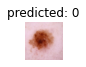

Actual: 0, predicted: 0


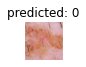

Actual: 0, predicted: 0


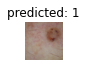

Actual: 0, predicted: 1


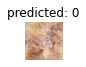

Actual: 0, predicted: 0


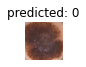

Actual: 0, predicted: 0


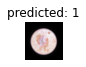

Actual: 0, predicted: 1


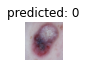

Actual: 0, predicted: 0


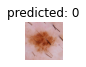

Actual: 0, predicted: 0


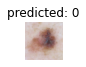

Actual: 0, predicted: 0


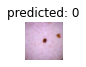

Actual: 0, predicted: 0


In [ ]:
visualize_model(efficientnet, val_loader, DEVICE, num_images=10)

#### With Weighted cross entropy

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/EfficientNet/efficientnet_wce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/EfficientNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
efficientnet = make_efficientnet(True, DEVICE)

criterion = nn.CrossEntropyLoss(weight=class_weights)

optimizer = optim.Adam(efficientnet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8')

Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: WCE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_wce.pth'
efficientnet = train_model(efficientnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [14:52<00:00,  2.81s/it]

train epoch 1 : loss : 0.7860, acc: 0.7127, kappa: 0.5139



100%|██████████| 20/20 [03:41<00:00, 11.06s/it]

val epoch 1 : loss : 0.4520, acc: 0.8291, kappa: 0.7010



Epoch 2/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 2 : loss : 0.6214, acc: 0.7725, kappa: 0.6150



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 2 : loss : 0.4569, acc: 0.8102, kappa: 0.6810



Epoch 3/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 3 : loss : 0.5391, acc: 0.8083, kappa: 0.6733



100%|██████████| 20/20 [00:29<00:00,  1.47s/it]

val epoch 3 : loss : 0.3552, acc: 0.8661, kappa: 0.7673



Epoch 4/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 4 : loss : 0.4786, acc: 0.8259, kappa: 0.7007



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 4 : loss : 0.3299, acc: 0.8780, kappa: 0.7871



Epoch 5/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 5 : loss : 0.4432, acc: 0.8406, kappa: 0.7256


100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 5 : loss : 0.3028, acc: 0.8890, kappa: 0.8064



Epoch 6/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 6 : loss : 0.4264, acc: 0.8534, kappa: 0.7458



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 6 : loss : 0.2859, acc: 0.8945, kappa: 0.8176



Epoch 7/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 7 : loss : 0.3642, acc: 0.8699, kappa: 0.7736


100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 7 : loss : 0.3606, acc: 0.8717, kappa: 0.7804



Epoch 8/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]


train epoch 8 : loss : 0.3760, acc: 0.8686, kappa: 0.7710


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 8 : loss : 0.3057, acc: 0.8874, kappa: 0.8054



Epoch 9/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 9 : loss : 0.3127, acc: 0.8843, kappa: 0.7975



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 9 : loss : 0.2748, acc: 0.9079, kappa: 0.8401



Epoch 10/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 10 : loss : 0.3012, acc: 0.8890, kappa: 0.8055



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 10 : loss : 0.2815, acc: 0.9024, kappa: 0.8304



Epoch 11/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 11 : loss : 0.2819, acc: 0.8994, kappa: 0.8234



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 11 : loss : 0.2983, acc: 0.8913, kappa: 0.8118



Epoch 12/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 12 : loss : 0.2620, acc: 0.9083, kappa: 0.8385



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 12 : loss : 0.2589, acc: 0.9126, kappa: 0.8454



Epoch 13/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 13 : loss : 0.2463, acc: 0.9146, kappa: 0.8496



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 13 : loss : 0.3008, acc: 0.9031, kappa: 0.8317



Epoch 14/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 14 : loss : 0.2471, acc: 0.9132, kappa: 0.8469



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 14 : loss : 0.3002, acc: 0.8969, kappa: 0.8214



Epoch 15/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 15 : loss : 0.2288, acc: 0.9176, kappa: 0.8543



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 15 : loss : 0.3083, acc: 0.9071, kappa: 0.8386



Epoch 16/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]


train epoch 16 : loss : 0.2096, acc: 0.9311, kappa: 0.8780


100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 16 : loss : 0.2534, acc: 0.9157, kappa: 0.8513



Epoch 17/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 17 : loss : 0.1963, acc: 0.9256, kappa: 0.8684



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 17 : loss : 0.2116, acc: 0.9323, kappa: 0.8807



Epoch 18/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 18 : loss : 0.2156, acc: 0.9177, kappa: 0.8549



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 18 : loss : 0.2095, acc: 0.9205, kappa: 0.8596



Epoch 19/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 19 : loss : 0.1693, acc: 0.9427, kappa: 0.8984



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 19 : loss : 0.2558, acc: 0.9134, kappa: 0.8479



Epoch 20/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 20 : loss : 0.1761, acc: 0.9370, kappa: 0.8885



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 20 : loss : 0.2242, acc: 0.9268, kappa: 0.8717



Epoch 21/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 21 : loss : 0.1558, acc: 0.9488, kappa: 0.9091



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 21 : loss : 0.2028, acc: 0.9386, kappa: 0.8910



Epoch 22/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 22 : loss : 0.1462, acc: 0.9488, kappa: 0.9092



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 22 : loss : 0.2074, acc: 0.9362, kappa: 0.8874



Epoch 23/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 23 : loss : 0.1710, acc: 0.9421, kappa: 0.8973



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 23 : loss : 0.2245, acc: 0.9268, kappa: 0.8721



Epoch 24/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 24 : loss : 0.1367, acc: 0.9563, kappa: 0.9222



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 24 : loss : 0.1993, acc: 0.9433, kappa: 0.8991



Epoch 25/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]


train epoch 25 : loss : 0.1514, acc: 0.9508, kappa: 0.9124


100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 25 : loss : 0.2275, acc: 0.9307, kappa: 0.8779



Epoch 26/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 26 : loss : 0.1395, acc: 0.9543, kappa: 0.9188


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 26 : loss : 0.2793, acc: 0.9197, kappa: 0.8596



Epoch 27/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 27 : loss : 0.1435, acc: 0.9534, kappa: 0.9172



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 27 : loss : 0.2034, acc: 0.9394, kappa: 0.8924



Epoch 28/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 28 : loss : 0.1237, acc: 0.9542, kappa: 0.9183



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 28 : loss : 0.2060, acc: 0.9362, kappa: 0.8866



Epoch 29/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 29 : loss : 0.1115, acc: 0.9614, kappa: 0.9312



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 29 : loss : 0.1925, acc: 0.9402, kappa: 0.8933



Epoch 30/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 30 : loss : 0.1087, acc: 0.9646, kappa: 0.9368


100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 30 : loss : 0.2386, acc: 0.9339, kappa: 0.8834



Epoch 31/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 31 : loss : 0.0934, acc: 0.9667, kappa: 0.9406



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 31 : loss : 0.2102, acc: 0.9417, kappa: 0.8961



Epoch 32/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 32 : loss : 0.1087, acc: 0.9648, kappa: 0.9372



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 32 : loss : 0.2238, acc: 0.9315, kappa: 0.8790



Epoch 33/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]


train epoch 33 : loss : 0.1121, acc: 0.9616, kappa: 0.9316


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 33 : loss : 0.2066, acc: 0.9425, kappa: 0.8971



Epoch 34/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 34 : loss : 0.1070, acc: 0.9638, kappa: 0.9353



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 34 : loss : 0.2213, acc: 0.9331, kappa: 0.8819



Epoch 35/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 35 : loss : 0.0905, acc: 0.9664, kappa: 0.9398



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 35 : loss : 0.2029, acc: 0.9402, kappa: 0.8931



Epoch 36/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 36 : loss : 0.0931, acc: 0.9693, kappa: 0.9452



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 36 : loss : 0.1913, acc: 0.9370, kappa: 0.8884



Epoch 37/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 37 : loss : 0.0777, acc: 0.9725, kappa: 0.9508



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 37 : loss : 0.2091, acc: 0.9425, kappa: 0.8974



Epoch 38/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 38 : loss : 0.0752, acc: 0.9740, kappa: 0.9536



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 38 : loss : 0.2442, acc: 0.9346, kappa: 0.8842



Epoch 39/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]


train epoch 39 : loss : 0.0747, acc: 0.9756, kappa: 0.9563


100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 39 : loss : 0.2792, acc: 0.9323, kappa: 0.8805



Epoch 40/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.50it/s]

train epoch 40 : loss : 0.0852, acc: 0.9705, kappa: 0.9472



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 40 : loss : 0.2612, acc: 0.9244, kappa: 0.8673



Epoch 41/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 41 : loss : 0.0970, acc: 0.9703, kappa: 0.9469



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 41 : loss : 0.2150, acc: 0.9362, kappa: 0.8864



Epoch 42/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 42 : loss : 0.0828, acc: 0.9709, kappa: 0.9480



100%|██████████| 20/20 [00:28<00:00,  1.44s/it]

val epoch 42 : loss : 0.1950, acc: 0.9354, kappa: 0.8848



Epoch 43/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 43 : loss : 0.0784, acc: 0.9715, kappa: 0.9490



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 43 : loss : 0.1925, acc: 0.9496, kappa: 0.9097



Epoch 44/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 44 : loss : 0.0956, acc: 0.9709, kappa: 0.9480



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 44 : loss : 0.2410, acc: 0.9362, kappa: 0.8864



Epoch 45/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 45 : loss : 0.0563, acc: 0.9786, kappa: 0.9616



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 45 : loss : 0.2143, acc: 0.9402, kappa: 0.8933



Epoch 46/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 46 : loss : 0.0509, acc: 0.9809, kappa: 0.9658



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 46 : loss : 0.2072, acc: 0.9417, kappa: 0.8964



Epoch 47/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]


train epoch 47 : loss : 0.0535, acc: 0.9823, kappa: 0.9682


100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 47 : loss : 0.1997, acc: 0.9496, kappa: 0.9101



Epoch 48/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]


train epoch 48 : loss : 0.0512, acc: 0.9835, kappa: 0.9703


 20%|██        | 4/20 [00:04<00:13,  1.18it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_wce.pth'
efficientnet = train_model(efficientnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, load_checkpoint=checkpoint_p)

Epoch 49/100
---------------


100%|██████████| 318/318 [14:36<00:00,  2.75s/it]


train epoch 49 : loss : 0.0421, acc: 0.9858, kappa: 0.9746


100%|██████████| 20/20 [03:36<00:00, 10.83s/it]

val epoch 49 : loss : 0.2104, acc: 0.9504, kappa: 0.9114


EARLY STOP AFTER 49 EPOCHS
Training complete in 18m 24s
Best val loss: 0.191295
Best val Kappa: 0.913123877362779


##### Test

In [ ]:
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_wce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(efficientnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

Test Loss: 0.2033 Acc: 0.9512, kappa: 0.9131
Testing complete in 0m 27s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.2033, acc: 0.9512, kappa: 0.9131


Show some results

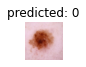

Actual: 0, predicted: 0


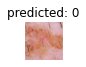

Actual: 0, predicted: 0


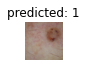

Actual: 0, predicted: 1


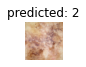

Actual: 0, predicted: 2


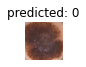

Actual: 0, predicted: 0


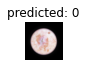

Actual: 0, predicted: 0


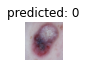

Actual: 0, predicted: 0


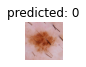

Actual: 0, predicted: 0


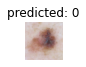

Actual: 0, predicted: 0


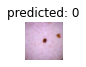

Actual: 0, predicted: 0


In [ ]:
visualize_model(efficientnet, val_loader, DEVICE, num_images=10)

#### Cross Entropy with sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/EfficientNet/efficientnet_ce.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/EfficientNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-6

In [ ]:
efficientnet = make_efficientnet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(efficientnet.parameters(), lr = LR, weight_decay=WD)

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

In [ ]:
logging.info('Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling')

Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, with sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': mean_samples,
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce_sampling.pth'
efficientnet = train_model(efficientnet, dataloaders_balanced, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [02:13<00:00,  2.38it/s]

train epoch 1 : loss : 0.7299, acc: 0.6777, kappa: 0.5165



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 1 : loss : 0.4653, acc: 0.8346, kappa: 0.7176



Epoch 2/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.42it/s]

train epoch 2 : loss : 0.4935, acc: 0.8040, kappa: 0.7060



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 2 : loss : 0.3551, acc: 0.8646, kappa: 0.7621



Epoch 3/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 3 : loss : 0.4230, acc: 0.8323, kappa: 0.7485



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 3 : loss : 0.3478, acc: 0.8669, kappa: 0.7687



Epoch 4/100
---------------


100%|██████████| 318/318 [02:11<00:00,  2.43it/s]

train epoch 4 : loss : 0.3632, acc: 0.8656, kappa: 0.7984



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 4 : loss : 0.3033, acc: 0.8929, kappa: 0.8120



Epoch 5/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 5 : loss : 0.3198, acc: 0.8762, kappa: 0.8143



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 5 : loss : 0.3469, acc: 0.8756, kappa: 0.7856



Epoch 6/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.56it/s]

train epoch 6 : loss : 0.2931, acc: 0.8876, kappa: 0.8314



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 6 : loss : 0.2907, acc: 0.8890, kappa: 0.8077



Epoch 7/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 7 : loss : 0.2655, acc: 0.8994, kappa: 0.8491



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 7 : loss : 0.2650, acc: 0.9126, kappa: 0.8465



Epoch 8/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 8 : loss : 0.2426, acc: 0.9124, kappa: 0.8686



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 8 : loss : 0.2413, acc: 0.9260, kappa: 0.8688



Epoch 9/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 9 : loss : 0.2199, acc: 0.9134, kappa: 0.8700



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 9 : loss : 0.2838, acc: 0.9071, kappa: 0.8384



Epoch 10/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 10 : loss : 0.2013, acc: 0.9286, kappa: 0.8929



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 10 : loss : 0.2478, acc: 0.9063, kappa: 0.8343



Epoch 11/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 11 : loss : 0.1812, acc: 0.9351, kappa: 0.9026



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 11 : loss : 0.2206, acc: 0.9220, kappa: 0.8634



Epoch 12/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 12 : loss : 0.1812, acc: 0.9355, kappa: 0.9032



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 12 : loss : 0.2616, acc: 0.9181, kappa: 0.8566



Epoch 13/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 13 : loss : 0.1546, acc: 0.9447, kappa: 0.9170



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 13 : loss : 0.2380, acc: 0.9220, kappa: 0.8631



Epoch 14/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 14 : loss : 0.1348, acc: 0.9520, kappa: 0.9280



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 14 : loss : 0.2073, acc: 0.9362, kappa: 0.8858



Epoch 15/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 15 : loss : 0.1418, acc: 0.9500, kappa: 0.9250



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 15 : loss : 0.1992, acc: 0.9394, kappa: 0.8918



Epoch 16/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 16 : loss : 0.1240, acc: 0.9536, kappa: 0.9303



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 16 : loss : 0.2289, acc: 0.9331, kappa: 0.8805



Epoch 17/100
---------------


100%|██████████| 318/318 [02:16<00:00,  2.34it/s]

train epoch 17 : loss : 0.1393, acc: 0.9490, kappa: 0.9235



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 17 : loss : 0.1999, acc: 0.9331, kappa: 0.8801



Epoch 18/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 18 : loss : 0.1182, acc: 0.9575, kappa: 0.9362



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 18 : loss : 0.1890, acc: 0.9378, kappa: 0.8887



Epoch 19/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 19 : loss : 0.1091, acc: 0.9618, kappa: 0.9427



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 19 : loss : 0.2180, acc: 0.9362, kappa: 0.8860



Epoch 20/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 20 : loss : 0.0965, acc: 0.9650, kappa: 0.9475



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 20 : loss : 0.2119, acc: 0.9354, kappa: 0.8840



Epoch 21/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 21 : loss : 0.0922, acc: 0.9685, kappa: 0.9528



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 21 : loss : 0.2177, acc: 0.9362, kappa: 0.8866



Epoch 22/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 22 : loss : 0.1048, acc: 0.9650, kappa: 0.9475



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 22 : loss : 0.2034, acc: 0.9307, kappa: 0.8758



Epoch 23/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 23 : loss : 0.0934, acc: 0.9669, kappa: 0.9504



100%|██████████| 20/20 [00:29<00:00,  1.50s/it]

val epoch 23 : loss : 0.1907, acc: 0.9449, kappa: 0.9017



Epoch 24/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 24 : loss : 0.0836, acc: 0.9713, kappa: 0.9569



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 24 : loss : 0.1916, acc: 0.9339, kappa: 0.8815



Epoch 25/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 25 : loss : 0.0808, acc: 0.9713, kappa: 0.9569



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 25 : loss : 0.1790, acc: 0.9480, kappa: 0.9071



Epoch 26/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 26 : loss : 0.0758, acc: 0.9746, kappa: 0.9619



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 26 : loss : 0.1993, acc: 0.9417, kappa: 0.8958



Epoch 27/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 27 : loss : 0.0757, acc: 0.9750, kappa: 0.9625



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 27 : loss : 0.1979, acc: 0.9449, kappa: 0.9021



Epoch 28/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 28 : loss : 0.0876, acc: 0.9683, kappa: 0.9525



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 28 : loss : 0.1681, acc: 0.9520, kappa: 0.9137



Epoch 29/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 29 : loss : 0.0804, acc: 0.9723, kappa: 0.9584



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 29 : loss : 0.1977, acc: 0.9504, kappa: 0.9112



Epoch 30/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 30 : loss : 0.0717, acc: 0.9744, kappa: 0.9616



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 30 : loss : 0.2019, acc: 0.9472, kappa: 0.9055



Epoch 31/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 31 : loss : 0.0707, acc: 0.9756, kappa: 0.9634



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 31 : loss : 0.1952, acc: 0.9449, kappa: 0.9009



Epoch 32/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 32 : loss : 0.0604, acc: 0.9801, kappa: 0.9702



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 32 : loss : 0.1703, acc: 0.9543, kappa: 0.9181



Epoch 33/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 33 : loss : 0.0542, acc: 0.9835, kappa: 0.9752



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 33 : loss : 0.2104, acc: 0.9386, kappa: 0.8899



Epoch 34/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.50it/s]

train epoch 34 : loss : 0.0525, acc: 0.9819, kappa: 0.9728



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 34 : loss : 0.1906, acc: 0.9457, kappa: 0.9024



Epoch 35/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 35 : loss : 0.0563, acc: 0.9801, kappa: 0.9702



100%|██████████| 20/20 [00:30<00:00,  1.51s/it]

val epoch 35 : loss : 0.1988, acc: 0.9504, kappa: 0.9112



Epoch 36/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.59it/s]

train epoch 36 : loss : 0.0619, acc: 0.9799, kappa: 0.9699



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 36 : loss : 0.1697, acc: 0.9520, kappa: 0.9139



Epoch 37/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 37 : loss : 0.0381, acc: 0.9866, kappa: 0.9799



100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 37 : loss : 0.1607, acc: 0.9528, kappa: 0.9150



Epoch 38/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.50it/s]

train epoch 38 : loss : 0.0434, acc: 0.9847, kappa: 0.9770



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 38 : loss : 0.1573, acc: 0.9575, kappa: 0.9234



Epoch 39/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 39 : loss : 0.0310, acc: 0.9898, kappa: 0.9846



100%|██████████| 20/20 [00:27<00:00,  1.40s/it]

val epoch 39 : loss : 0.1594, acc: 0.9551, kappa: 0.9191



Epoch 40/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 40 : loss : 0.0304, acc: 0.9898, kappa: 0.9847



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 40 : loss : 0.1608, acc: 0.9591, kappa: 0.9267



Epoch 41/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 41 : loss : 0.0411, acc: 0.9850, kappa: 0.9776



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 41 : loss : 0.1610, acc: 0.9551, kappa: 0.9193



Epoch 42/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]

train epoch 42 : loss : 0.0318, acc: 0.9908, kappa: 0.9861



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 42 : loss : 0.1612, acc: 0.9575, kappa: 0.9237



Epoch 43/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 43 : loss : 0.0385, acc: 0.9860, kappa: 0.9790



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 43 : loss : 0.1639, acc: 0.9559, kappa: 0.9207



Epoch 44/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.58it/s]

train epoch 44 : loss : 0.0343, acc: 0.9888, kappa: 0.9832



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 44 : loss : 0.1583, acc: 0.9567, kappa: 0.9220



Epoch 45/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 45 : loss : 0.0327, acc: 0.9906, kappa: 0.9858



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 45 : loss : 0.1516, acc: 0.9575, kappa: 0.9235



Epoch 46/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 46 : loss : 0.0293, acc: 0.9898, kappa: 0.9847



100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 46 : loss : 0.1509, acc: 0.9575, kappa: 0.9235



Epoch 47/100
---------------


100%|██████████| 318/318 [02:10<00:00,  2.43it/s]

train epoch 47 : loss : 0.0280, acc: 0.9900, kappa: 0.9849



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 47 : loss : 0.1546, acc: 0.9567, kappa: 0.9220



Epoch 48/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 48 : loss : 0.0266, acc: 0.9913, kappa: 0.9870



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 48 : loss : 0.1659, acc: 0.9535, kappa: 0.9163



Epoch 49/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 49 : loss : 0.0274, acc: 0.9908, kappa: 0.9861



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 49 : loss : 0.1511, acc: 0.9559, kappa: 0.9208



Epoch 50/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 50 : loss : 0.0252, acc: 0.9931, kappa: 0.9897



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 50 : loss : 0.1518, acc: 0.9583, kappa: 0.9249



Epoch 51/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 51 : loss : 0.0192, acc: 0.9941, kappa: 0.9911



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 51 : loss : 0.1585, acc: 0.9567, kappa: 0.9224



Epoch 52/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 52 : loss : 0.0188, acc: 0.9949, kappa: 0.9923



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 52 : loss : 0.1613, acc: 0.9575, kappa: 0.9235



Epoch 53/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 53 : loss : 0.0233, acc: 0.9929, kappa: 0.9894



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 53 : loss : 0.1663, acc: 0.9583, kappa: 0.9250



Epoch 54/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 54 : loss : 0.0187, acc: 0.9949, kappa: 0.9923



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 54 : loss : 0.1608, acc: 0.9583, kappa: 0.9250



Epoch 55/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 55 : loss : 0.0298, acc: 0.9896, kappa: 0.9844



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 55 : loss : 0.1617, acc: 0.9591, kappa: 0.9265



Epoch 56/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.47it/s]

train epoch 56 : loss : 0.0200, acc: 0.9939, kappa: 0.9908



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 56 : loss : 0.1572, acc: 0.9598, kappa: 0.9277



Epoch 57/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 57 : loss : 0.0234, acc: 0.9929, kappa: 0.9894



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 57 : loss : 0.1651, acc: 0.9575, kappa: 0.9234



Epoch 58/100
---------------


100%|██████████| 318/318 [02:09<00:00,  2.46it/s]

train epoch 58 : loss : 0.0204, acc: 0.9937, kappa: 0.9906



100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 58 : loss : 0.1635, acc: 0.9567, kappa: 0.9220



Epoch 59/100
---------------


100%|██████████| 318/318 [02:08<00:00,  2.48it/s]

train epoch 59 : loss : 0.0190, acc: 0.9933, kappa: 0.9900



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 59 : loss : 0.1522, acc: 0.9575, kappa: 0.9235


EARLY STOP AFTER 59 EPOCHS
Training complete in 152m 21s
Best val loss: 0.150946
Best val Kappa: 0.9277172166273837


##### Test

In [ ]:
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce_sampling_best.pth'))

In [ ]:
val_loss, val_acc, val_kappa = test_model(efficientnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

Test Loss: 0.1572 Acc: 0.9598, kappa: 0.9277
Testing complete in 0m 32s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1572, acc: 0.9598, kappa: 0.9277


Show some results

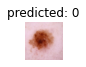

Actual: 0, predicted: 0


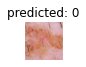

Actual: 0, predicted: 0


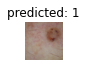

Actual: 0, predicted: 1


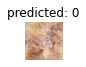

Actual: 0, predicted: 0


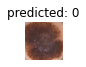

Actual: 0, predicted: 0


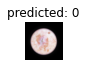

Actual: 0, predicted: 0


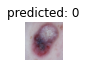

Actual: 0, predicted: 0


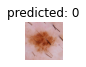

Actual: 0, predicted: 0


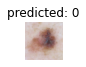

Actual: 0, predicted: 0


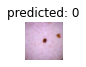

Actual: 0, predicted: 0


In [ ]:
visualize_model(efficientnet, val_loader, DEVICE, num_images=10)

#### Cross entropy without sampling

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/EfficientNet/efficientnet_ce_all.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/EfficientNet'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
efficientnet = make_efficientnet(True, DEVICE)

criterion = nn.CrossEntropyLoss()

optimizer = optim.Adam(efficientnet.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/efficientnet_b2_rwightman-bcdf34b7.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b2_rwightman-bcdf34b7.pth


  0%|          | 0.00/35.2M [00:00<?, ?B/s]

In [ ]:
logging.info('Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, no sampling')

Model: EfficientNet, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, no sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce.pth'
efficientnet = train_model(efficientnet, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [31:56<00:00,  6.03s/it]

train epoch 1 : loss : 0.5780, acc: 0.7757, kappa: 0.5786



100%|██████████| 20/20 [08:05<00:00, 24.26s/it]

val epoch 1 : loss : 0.3839, acc: 0.8606, kappa: 0.7385



Epoch 2/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 2 : loss : 0.4351, acc: 0.8355, kappa: 0.6940


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 2 : loss : 0.3246, acc: 0.8858, kappa: 0.7898



Epoch 3/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 3 : loss : 0.3791, acc: 0.8619, kappa: 0.7454


100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 3 : loss : 0.3060, acc: 0.8882, kappa: 0.7998



Epoch 4/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]


train epoch 4 : loss : 0.3367, acc: 0.8713, kappa: 0.7646


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 4 : loss : 0.2752, acc: 0.8921, kappa: 0.8065



Epoch 5/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 5 : loss : 0.3048, acc: 0.8896, kappa: 0.7987



100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 5 : loss : 0.2620, acc: 0.9126, kappa: 0.8441



Epoch 6/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 6 : loss : 0.2805, acc: 0.8912, kappa: 0.8022



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 6 : loss : 0.2461, acc: 0.9150, kappa: 0.8476



Epoch 7/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 7 : loss : 0.2522, acc: 0.9085, kappa: 0.8339



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 7 : loss : 0.2381, acc: 0.9213, kappa: 0.8585



Epoch 8/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 8 : loss : 0.2509, acc: 0.9083, kappa: 0.8340



100%|██████████| 20/20 [00:28<00:00,  1.42s/it]

val epoch 8 : loss : 0.2069, acc: 0.9315, kappa: 0.8766



Epoch 9/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 9 : loss : 0.2107, acc: 0.9262, kappa: 0.8664



100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

val epoch 9 : loss : 0.2144, acc: 0.9307, kappa: 0.8762



Epoch 10/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]


train epoch 10 : loss : 0.1964, acc: 0.9240, kappa: 0.8628


100%|██████████| 20/20 [00:29<00:00,  1.46s/it]

val epoch 10 : loss : 0.2017, acc: 0.9354, kappa: 0.8838



Epoch 11/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]


train epoch 11 : loss : 0.1710, acc: 0.9362, kappa: 0.8846


100%|██████████| 20/20 [00:27<00:00,  1.38s/it]

val epoch 11 : loss : 0.2120, acc: 0.9283, kappa: 0.8712



Epoch 12/100
---------------


100%|██████████| 318/318 [02:02<00:00,  2.60it/s]


train epoch 12 : loss : 0.1701, acc: 0.9425, kappa: 0.8960


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 12 : loss : 0.2083, acc: 0.9236, kappa: 0.8658



Epoch 13/100
---------------


100%|██████████| 318/318 [02:03<00:00,  2.57it/s]

train epoch 13 : loss : 0.1586, acc: 0.9439, kappa: 0.8987



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 13 : loss : 0.2147, acc: 0.9220, kappa: 0.8616



Epoch 14/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 14 : loss : 0.1429, acc: 0.9508, kappa: 0.9112



100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 14 : loss : 0.2182, acc: 0.9307, kappa: 0.8757



Epoch 15/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]


train epoch 15 : loss : 0.1477, acc: 0.9457, kappa: 0.9019


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 15 : loss : 0.2111, acc: 0.9346, kappa: 0.8832



Epoch 16/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 16 : loss : 0.1300, acc: 0.9520, kappa: 0.9133


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 16 : loss : 0.2171, acc: 0.9307, kappa: 0.8771



Epoch 17/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]


train epoch 17 : loss : 0.1148, acc: 0.9591, kappa: 0.9261


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 17 : loss : 0.2311, acc: 0.9228, kappa: 0.8629



Epoch 18/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]


train epoch 18 : loss : 0.1089, acc: 0.9612, kappa: 0.9301


100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 18 : loss : 0.1794, acc: 0.9472, kappa: 0.9059



Epoch 19/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]


train epoch 19 : loss : 0.1146, acc: 0.9585, kappa: 0.9253


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 19 : loss : 0.1692, acc: 0.9441, kappa: 0.9001



Epoch 20/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 20 : loss : 0.1048, acc: 0.9618, kappa: 0.9312


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 20 : loss : 0.1822, acc: 0.9354, kappa: 0.8855



Epoch 21/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 21 : loss : 0.0888, acc: 0.9705, kappa: 0.9468



100%|██████████| 20/20 [00:26<00:00,  1.34s/it]

val epoch 21 : loss : 0.1822, acc: 0.9433, kappa: 0.8986



Epoch 22/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.56it/s]

train epoch 22 : loss : 0.0785, acc: 0.9717, kappa: 0.9490



100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 22 : loss : 0.1719, acc: 0.9354, kappa: 0.8851



Epoch 23/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]


train epoch 23 : loss : 0.0783, acc: 0.9736, kappa: 0.9525


100%|██████████| 20/20 [00:27<00:00,  1.37s/it]

val epoch 23 : loss : 0.2098, acc: 0.9394, kappa: 0.8928



Epoch 24/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.52it/s]


train epoch 24 : loss : 0.0982, acc: 0.9693, kappa: 0.9447


100%|██████████| 20/20 [00:26<00:00,  1.35s/it]

val epoch 24 : loss : 0.1700, acc: 0.9449, kappa: 0.9004



Epoch 25/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.53it/s]

train epoch 25 : loss : 0.0766, acc: 0.9725, kappa: 0.9504



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 25 : loss : 0.1706, acc: 0.9496, kappa: 0.9097



Epoch 26/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 26 : loss : 0.0786, acc: 0.9723, kappa: 0.9500


100%|██████████| 20/20 [00:26<00:00,  1.32s/it]

val epoch 26 : loss : 0.1769, acc: 0.9441, kappa: 0.9002



Epoch 27/100
---------------


100%|██████████| 318/318 [02:04<00:00,  2.55it/s]

train epoch 27 : loss : 0.0796, acc: 0.9689, kappa: 0.9441



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 27 : loss : 0.1911, acc: 0.9402, kappa: 0.8918



Epoch 28/100
---------------


100%|██████████| 318/318 [02:06<00:00,  2.51it/s]

train epoch 28 : loss : 0.0653, acc: 0.9748, kappa: 0.9546



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 28 : loss : 0.1816, acc: 0.9449, kappa: 0.9010



Epoch 29/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 29 : loss : 0.0536, acc: 0.9833, kappa: 0.9699



100%|██████████| 20/20 [00:28<00:00,  1.40s/it]

val epoch 29 : loss : 0.1787, acc: 0.9441, kappa: 0.8993



Epoch 30/100
---------------


100%|██████████| 318/318 [02:07<00:00,  2.49it/s]

train epoch 30 : loss : 0.0481, acc: 0.9821, kappa: 0.9678



100%|██████████| 20/20 [00:27<00:00,  1.36s/it]

val epoch 30 : loss : 0.1809, acc: 0.9417, kappa: 0.8947



Epoch 31/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]

train epoch 31 : loss : 0.0476, acc: 0.9831, kappa: 0.9695



100%|██████████| 20/20 [00:27<00:00,  1.35s/it]

val epoch 31 : loss : 0.1915, acc: 0.9465, kappa: 0.9034



Epoch 32/100
---------------


100%|██████████| 318/318 [02:05<00:00,  2.54it/s]


train epoch 32 : loss : 0.0410, acc: 0.9858, kappa: 0.9745


100%|██████████| 20/20 [00:26<00:00,  1.33s/it]

val epoch 32 : loss : 0.1774, acc: 0.9472, kappa: 0.9050


EARLY STOP AFTER 32 EPOCHS
Training complete in 119m 0s
Best val loss: 0.169208
Best val Kappa: 0.9097173780718084


##### Test

In [ ]:
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(efficientnet, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:28<00:00,  1.43s/it]

Test Loss: 0.1706 Acc: 0.9496, kappa: 0.9097
Testing complete in 0m 29s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1706, acc: 0.9496, kappa: 0.9097


Show some results

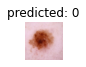

Actual: 0, predicted: 0


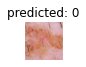

Actual: 0, predicted: 0


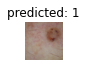

Actual: 0, predicted: 1


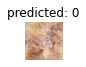

Actual: 0, predicted: 0


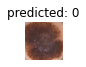

Actual: 0, predicted: 0


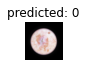

Actual: 0, predicted: 0


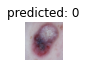

Actual: 0, predicted: 0


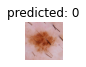

Actual: 0, predicted: 0


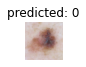

Actual: 0, predicted: 0


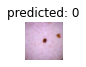

Actual: 0, predicted: 0


In [ ]:
visualize_model(efficientnet, val_loader, DEVICE, num_images=10)

# Attempts for improvement...

## Single models

#### Swin S

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_s_ce_all.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin_s(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_s-5e29d889.pth" to /root/.cache/torch/hub/checkpoints/swin_s-5e29d889.pth


  0%|          | 0.00/190M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_s, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling')

Model:swin_s, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [32:16<00:00,  6.09s/it]

train epoch 1 : loss : 0.5412, acc: 0.7983, kappa: 0.6207



100%|██████████| 20/20 [08:06<00:00, 24.34s/it]

val epoch 1 : loss : 0.3664, acc: 0.8693, kappa: 0.7536



Epoch 2/100
---------------


100%|██████████| 318/318 [03:23<00:00,  1.56it/s]

train epoch 2 : loss : 0.4166, acc: 0.8432, kappa: 0.7091



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 2 : loss : 0.3378, acc: 0.8709, kappa: 0.7587



Epoch 3/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 3 : loss : 0.3542, acc: 0.8737, kappa: 0.7672



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 3 : loss : 0.2914, acc: 0.8890, kappa: 0.7945



Epoch 4/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 4 : loss : 0.3257, acc: 0.8754, kappa: 0.7716



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 4 : loss : 0.2577, acc: 0.9063, kappa: 0.8287



Epoch 5/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 5 : loss : 0.2996, acc: 0.8851, kappa: 0.7897



100%|██████████| 20/20 [00:32<00:00,  1.64s/it]

val epoch 5 : loss : 0.2637, acc: 0.9039, kappa: 0.8274



Epoch 6/100
---------------


100%|██████████| 318/318 [03:23<00:00,  1.57it/s]

train epoch 6 : loss : 0.2572, acc: 0.9081, kappa: 0.8328



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 6 : loss : 0.2374, acc: 0.9197, kappa: 0.8553



Epoch 7/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 7 : loss : 0.2423, acc: 0.9081, kappa: 0.8329



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 7 : loss : 0.2548, acc: 0.9134, kappa: 0.8454



Epoch 8/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 8 : loss : 0.2210, acc: 0.9197, kappa: 0.8545



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 8 : loss : 0.1981, acc: 0.9283, kappa: 0.8708



Epoch 9/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 9 : loss : 0.2100, acc: 0.9187, kappa: 0.8527



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 9 : loss : 0.2158, acc: 0.9307, kappa: 0.8740



Epoch 10/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 10 : loss : 0.1991, acc: 0.9280, kappa: 0.8692



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 10 : loss : 0.2325, acc: 0.9181, kappa: 0.8531



Epoch 11/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 11 : loss : 0.1713, acc: 0.9370, kappa: 0.8860



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 11 : loss : 0.2643, acc: 0.9047, kappa: 0.8304



Epoch 12/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 12 : loss : 0.1648, acc: 0.9406, kappa: 0.8927



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 12 : loss : 0.2418, acc: 0.9276, kappa: 0.8691



Epoch 13/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 13 : loss : 0.1650, acc: 0.9392, kappa: 0.8900



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 13 : loss : 0.2044, acc: 0.9339, kappa: 0.8790



Epoch 14/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 14 : loss : 0.1519, acc: 0.9437, kappa: 0.8983



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 14 : loss : 0.1728, acc: 0.9370, kappa: 0.8877



Epoch 15/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.57it/s]

train epoch 15 : loss : 0.1410, acc: 0.9486, kappa: 0.9074



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 15 : loss : 0.2062, acc: 0.9331, kappa: 0.8779



Epoch 16/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 16 : loss : 0.1333, acc: 0.9510, kappa: 0.9114



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 16 : loss : 0.1931, acc: 0.9394, kappa: 0.8889



Epoch 17/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 17 : loss : 0.1300, acc: 0.9508, kappa: 0.9112



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 17 : loss : 0.2270, acc: 0.9276, kappa: 0.8716



Epoch 18/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 18 : loss : 0.1099, acc: 0.9604, kappa: 0.9287



100%|██████████| 20/20 [00:33<00:00,  1.65s/it]

val epoch 18 : loss : 0.1565, acc: 0.9449, kappa: 0.9011



Epoch 19/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 19 : loss : 0.1267, acc: 0.9551, kappa: 0.9191



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 19 : loss : 0.1885, acc: 0.9394, kappa: 0.8898



Epoch 20/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 20 : loss : 0.1062, acc: 0.9618, kappa: 0.9312



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 20 : loss : 0.1973, acc: 0.9362, kappa: 0.8850



Epoch 21/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 21 : loss : 0.1072, acc: 0.9616, kappa: 0.9307



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 21 : loss : 0.2222, acc: 0.9323, kappa: 0.8807



Epoch 22/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 22 : loss : 0.0978, acc: 0.9667, kappa: 0.9400



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 22 : loss : 0.1753, acc: 0.9386, kappa: 0.8889



Epoch 23/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.57it/s]

train epoch 23 : loss : 0.1045, acc: 0.9591, kappa: 0.9262



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 23 : loss : 0.1676, acc: 0.9480, kappa: 0.9063



Epoch 24/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 24 : loss : 0.0948, acc: 0.9664, kappa: 0.9392



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 24 : loss : 0.2374, acc: 0.9291, kappa: 0.8709



Epoch 25/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 25 : loss : 0.0913, acc: 0.9675, kappa: 0.9415



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 25 : loss : 0.1726, acc: 0.9433, kappa: 0.8977



Epoch 26/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 26 : loss : 0.0978, acc: 0.9650, kappa: 0.9368



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 26 : loss : 0.1965, acc: 0.9457, kappa: 0.9023



Epoch 27/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 27 : loss : 0.0481, acc: 0.9831, kappa: 0.9695



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 27 : loss : 0.1612, acc: 0.9583, kappa: 0.9247



Epoch 28/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 28 : loss : 0.0336, acc: 0.9894, kappa: 0.9809



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 28 : loss : 0.1559, acc: 0.9583, kappa: 0.9247



Epoch 29/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 29 : loss : 0.0334, acc: 0.9884, kappa: 0.9791



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 29 : loss : 0.1573, acc: 0.9598, kappa: 0.9273



Epoch 30/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.57it/s]

train epoch 30 : loss : 0.0229, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 30 : loss : 0.1539, acc: 0.9614, kappa: 0.9304



Epoch 31/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 31 : loss : 0.0208, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 31 : loss : 0.1588, acc: 0.9630, kappa: 0.9335



Epoch 32/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 32 : loss : 0.0180, acc: 0.9929, kappa: 0.9873



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 32 : loss : 0.1688, acc: 0.9622, kappa: 0.9316



Epoch 33/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 33 : loss : 0.0199, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 33 : loss : 0.1668, acc: 0.9638, kappa: 0.9344



Epoch 34/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.57it/s]

train epoch 34 : loss : 0.0197, acc: 0.9919, kappa: 0.9855



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 34 : loss : 0.1827, acc: 0.9614, kappa: 0.9308



Epoch 35/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 35 : loss : 0.0193, acc: 0.9923, kappa: 0.9862



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 35 : loss : 0.1702, acc: 0.9638, kappa: 0.9349



Epoch 36/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.57it/s]

train epoch 36 : loss : 0.0204, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:33<00:00,  1.65s/it]

val epoch 36 : loss : 0.1738, acc: 0.9646, kappa: 0.9363



Epoch 37/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 37 : loss : 0.0203, acc: 0.9925, kappa: 0.9865



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 37 : loss : 0.1776, acc: 0.9614, kappa: 0.9303



Epoch 38/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 38 : loss : 0.0134, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

val epoch 38 : loss : 0.1745, acc: 0.9646, kappa: 0.9360



Epoch 39/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 39 : loss : 0.0135, acc: 0.9959, kappa: 0.9926



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 39 : loss : 0.1719, acc: 0.9661, kappa: 0.9388



Epoch 40/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 40 : loss : 0.0114, acc: 0.9953, kappa: 0.9915



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 40 : loss : 0.1706, acc: 0.9669, kappa: 0.9403



Epoch 41/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 41 : loss : 0.0124, acc: 0.9957, kappa: 0.9922



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 41 : loss : 0.1669, acc: 0.9677, kappa: 0.9418



Epoch 42/100
---------------


100%|██████████| 318/318 [03:22<00:00,  1.57it/s]

train epoch 42 : loss : 0.0130, acc: 0.9951, kappa: 0.9911



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 42 : loss : 0.1689, acc: 0.9677, kappa: 0.9417



Epoch 43/100
---------------


100%|██████████| 318/318 [03:21<00:00,  1.58it/s]

train epoch 43 : loss : 0.0102, acc: 0.9967, kappa: 0.9940



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 43 : loss : 0.1704, acc: 0.9685, kappa: 0.9431


EARLY STOP AFTER 43 EPOCHS
Training complete in 206m 10s
Best val loss: 0.153878
Best val Kappa: 0.9430993386978261


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

Test Loss: 0.1704 Acc: 0.9685, kappa: 0.9431
Testing complete in 0m 33s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1704, acc: 0.9685, kappa: 0.9431


Show some results

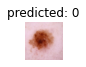

Actual: 0, predicted: 0


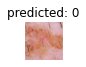

Actual: 0, predicted: 0


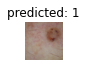

Actual: 0, predicted: 1


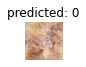

Actual: 0, predicted: 0


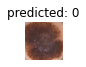

Actual: 0, predicted: 0


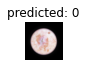

Actual: 0, predicted: 0


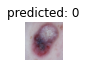

Actual: 0, predicted: 0


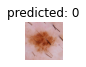

Actual: 0, predicted: 0


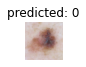

Actual: 0, predicted: 0


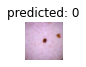

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Swin S V2

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_s_v2_ce_all.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin_v2(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_v2_s-637d8ceb.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_s-637d8ceb.pth


  0%|          | 0.00/191M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_s_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling')

Model:swin_s_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_v2_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [25:04<00:00,  4.73s/it]


train epoch 1 : loss : 0.5375, acc: 0.7952, kappa: 0.6153


100%|██████████| 20/20 [06:19<00:00, 18.96s/it]

val epoch 1 : loss : 0.3532, acc: 0.8819, kappa: 0.7837



Epoch 2/100
---------------


100%|██████████| 318/318 [03:02<00:00,  1.74it/s]

train epoch 2 : loss : 0.4179, acc: 0.8436, kappa: 0.7092



100%|██████████| 20/20 [00:33<00:00,  1.67s/it]

val epoch 2 : loss : 0.4204, acc: 0.8331, kappa: 0.6978



Epoch 3/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 3 : loss : 0.3459, acc: 0.8695, kappa: 0.7606



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 3 : loss : 0.2903, acc: 0.8882, kappa: 0.7964



Epoch 4/100
---------------


100%|██████████| 318/318 [03:08<00:00,  1.69it/s]

train epoch 4 : loss : 0.3098, acc: 0.8813, kappa: 0.7836



100%|██████████| 20/20 [00:31<00:00,  1.60s/it]

val epoch 4 : loss : 0.2796, acc: 0.8929, kappa: 0.8034



Epoch 5/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 5 : loss : 0.2625, acc: 0.9032, kappa: 0.8239



100%|██████████| 20/20 [00:33<00:00,  1.70s/it]

val epoch 5 : loss : 0.2564, acc: 0.9063, kappa: 0.8283



Epoch 6/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 6 : loss : 0.2434, acc: 0.9136, kappa: 0.8425



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 6 : loss : 0.2298, acc: 0.9165, kappa: 0.8479



Epoch 7/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.69it/s]

train epoch 7 : loss : 0.2101, acc: 0.9209, kappa: 0.8566



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 7 : loss : 0.2343, acc: 0.9323, kappa: 0.8761



Epoch 8/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.69it/s]

train epoch 8 : loss : 0.2007, acc: 0.9252, kappa: 0.8646



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 8 : loss : 0.2328, acc: 0.9205, kappa: 0.8546



Epoch 9/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 9 : loss : 0.1866, acc: 0.9319, kappa: 0.8768



100%|██████████| 20/20 [00:33<00:00,  1.70s/it]

val epoch 9 : loss : 0.2264, acc: 0.9276, kappa: 0.8698



Epoch 10/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 10 : loss : 0.1650, acc: 0.9431, kappa: 0.8972



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 10 : loss : 0.2305, acc: 0.9150, kappa: 0.8479



Epoch 11/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.69it/s]

train epoch 11 : loss : 0.1594, acc: 0.9416, kappa: 0.8943



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 11 : loss : 0.2140, acc: 0.9276, kappa: 0.8701



Epoch 12/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 12 : loss : 0.1460, acc: 0.9471, kappa: 0.9043



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 12 : loss : 0.2109, acc: 0.9283, kappa: 0.8714



Epoch 13/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 13 : loss : 0.1414, acc: 0.9540, kappa: 0.9170



100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

val epoch 13 : loss : 0.1605, acc: 0.9512, kappa: 0.9115



Epoch 14/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 14 : loss : 0.1246, acc: 0.9577, kappa: 0.9236



100%|██████████| 20/20 [00:31<00:00,  1.57s/it]

val epoch 14 : loss : 0.1874, acc: 0.9417, kappa: 0.8946



Epoch 15/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 15 : loss : 0.1323, acc: 0.9518, kappa: 0.9129



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 15 : loss : 0.1726, acc: 0.9394, kappa: 0.8922



Epoch 16/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 16 : loss : 0.1105, acc: 0.9585, kappa: 0.9251



100%|██████████| 20/20 [00:31<00:00,  1.59s/it]

val epoch 16 : loss : 0.2117, acc: 0.9299, kappa: 0.8727



Epoch 17/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 17 : loss : 0.1131, acc: 0.9583, kappa: 0.9246



100%|██████████| 20/20 [00:31<00:00,  1.58s/it]

val epoch 17 : loss : 0.1927, acc: 0.9449, kappa: 0.9007



Epoch 18/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 18 : loss : 0.1120, acc: 0.9622, kappa: 0.9318



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 18 : loss : 0.1906, acc: 0.9386, kappa: 0.8874



Epoch 19/100
---------------


100%|██████████| 318/318 [03:05<00:00,  1.71it/s]

train epoch 19 : loss : 0.1070, acc: 0.9608, kappa: 0.9293



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 19 : loss : 0.1817, acc: 0.9323, kappa: 0.8787



Epoch 20/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 20 : loss : 0.1051, acc: 0.9614, kappa: 0.9305



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 20 : loss : 0.1680, acc: 0.9409, kappa: 0.8926



Epoch 21/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 21 : loss : 0.0905, acc: 0.9683, kappa: 0.9428



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 21 : loss : 0.2078, acc: 0.9362, kappa: 0.8837



Epoch 22/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 22 : loss : 0.0580, acc: 0.9799, kappa: 0.9638



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 22 : loss : 0.1436, acc: 0.9591, kappa: 0.9260



Epoch 23/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 23 : loss : 0.0365, acc: 0.9880, kappa: 0.9784



100%|██████████| 20/20 [00:32<00:00,  1.65s/it]

val epoch 23 : loss : 0.1440, acc: 0.9567, kappa: 0.9218



Epoch 24/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 24 : loss : 0.0281, acc: 0.9906, kappa: 0.9830



100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

val epoch 24 : loss : 0.1430, acc: 0.9614, kappa: 0.9309



Epoch 25/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 25 : loss : 0.0216, acc: 0.9915, kappa: 0.9848



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 25 : loss : 0.1541, acc: 0.9591, kappa: 0.9261



Epoch 26/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 26 : loss : 0.0266, acc: 0.9909, kappa: 0.9837



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 26 : loss : 0.1355, acc: 0.9622, kappa: 0.9321



Epoch 27/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.69it/s]

train epoch 27 : loss : 0.0212, acc: 0.9933, kappa: 0.9880



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 27 : loss : 0.1317, acc: 0.9661, kappa: 0.9390



Epoch 28/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 28 : loss : 0.0164, acc: 0.9951, kappa: 0.9911



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 28 : loss : 0.1434, acc: 0.9638, kappa: 0.9347



Epoch 29/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 29 : loss : 0.0154, acc: 0.9945, kappa: 0.9901



100%|██████████| 20/20 [00:30<00:00,  1.55s/it]

val epoch 29 : loss : 0.1341, acc: 0.9677, kappa: 0.9417



Epoch 30/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 30 : loss : 0.0251, acc: 0.9925, kappa: 0.9865



100%|██████████| 20/20 [00:31<00:00,  1.55s/it]

val epoch 30 : loss : 0.1347, acc: 0.9622, kappa: 0.9316



Epoch 31/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 31 : loss : 0.0148, acc: 0.9947, kappa: 0.9904



100%|██████████| 20/20 [00:32<00:00,  1.64s/it]

val epoch 31 : loss : 0.1353, acc: 0.9693, kappa: 0.9450



Epoch 32/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 32 : loss : 0.0186, acc: 0.9941, kappa: 0.9894



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 32 : loss : 0.1344, acc: 0.9693, kappa: 0.9447



Epoch 33/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 33 : loss : 0.0150, acc: 0.9951, kappa: 0.9911



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 33 : loss : 0.1355, acc: 0.9669, kappa: 0.9408



Epoch 34/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 34 : loss : 0.0182, acc: 0.9937, kappa: 0.9887



100%|██████████| 20/20 [00:31<00:00,  1.56s/it]

val epoch 34 : loss : 0.1313, acc: 0.9709, kappa: 0.9476



Epoch 35/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 35 : loss : 0.0150, acc: 0.9957, kappa: 0.9922



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 35 : loss : 0.1390, acc: 0.9685, kappa: 0.9437



Epoch 36/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 36 : loss : 0.0115, acc: 0.9957, kappa: 0.9922



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 36 : loss : 0.1386, acc: 0.9693, kappa: 0.9449



Epoch 37/100
---------------


100%|██████████| 318/318 [03:13<00:00,  1.64it/s]

train epoch 37 : loss : 0.0108, acc: 0.9967, kappa: 0.9940



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 37 : loss : 0.1500, acc: 0.9661, kappa: 0.9391



Epoch 38/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 38 : loss : 0.0153, acc: 0.9945, kappa: 0.9901



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 38 : loss : 0.1556, acc: 0.9638, kappa: 0.9346



Epoch 39/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 39 : loss : 0.0138, acc: 0.9959, kappa: 0.9926



100%|██████████| 20/20 [00:30<00:00,  1.52s/it]

val epoch 39 : loss : 0.1557, acc: 0.9661, kappa: 0.9392



Epoch 40/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 40 : loss : 0.0121, acc: 0.9963, kappa: 0.9933



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 40 : loss : 0.1535, acc: 0.9677, kappa: 0.9418



Epoch 41/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.70it/s]

train epoch 41 : loss : 0.0124, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:30<00:00,  1.53s/it]

val epoch 41 : loss : 0.1489, acc: 0.9693, kappa: 0.9448



Epoch 42/100
---------------


100%|██████████| 318/318 [03:06<00:00,  1.71it/s]

train epoch 42 : loss : 0.0129, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

val epoch 42 : loss : 0.1514, acc: 0.9669, kappa: 0.9404



Epoch 43/100
---------------


100%|██████████| 318/318 [03:05<00:00,  1.71it/s]

train epoch 43 : loss : 0.0075, acc: 0.9976, kappa: 0.9958



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 43 : loss : 0.1459, acc: 0.9693, kappa: 0.9446



Epoch 44/100
---------------


100%|██████████| 318/318 [03:05<00:00,  1.71it/s]

train epoch 44 : loss : 0.0082, acc: 0.9965, kappa: 0.9936



100%|██████████| 20/20 [00:32<00:00,  1.61s/it]

val epoch 44 : loss : 0.1444, acc: 0.9693, kappa: 0.9447



Epoch 45/100
---------------


 19%|█▉        | 60/318 [00:36<02:28,  1.73it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_v2_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, 
                   load_checkpoint=checkpoint_p)

Epoch 45/100
---------------


100%|██████████| 318/318 [34:59<00:00,  6.60s/it]


train epoch 45 : loss : 0.0087, acc: 0.9974, kappa: 0.9954


100%|██████████| 20/20 [08:44<00:00, 26.22s/it]

val epoch 45 : loss : 0.1440, acc: 0.9701, kappa: 0.9460



Epoch 46/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 46 : loss : 0.0133, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:30<00:00,  1.54s/it]

val epoch 46 : loss : 0.1404, acc: 0.9709, kappa: 0.9475



Epoch 47/100
---------------


100%|██████████| 318/318 [03:07<00:00,  1.70it/s]

train epoch 47 : loss : 0.0084, acc: 0.9980, kappa: 0.9965



100%|██████████| 20/20 [00:33<00:00,  1.68s/it]

val epoch 47 : loss : 0.1410, acc: 0.9701, kappa: 0.9461


EARLY STOP AFTER 47 EPOCHS
Training complete in 51m 23s
Best val loss: 0.131305
Best val Kappa: 0.9475698473623136


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_v2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:32<00:00,  1.62s/it]

Test Loss: 0.1313 Acc: 0.9709, kappa: 0.9476
Testing complete in 0m 32s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1313, acc: 0.9709, kappa: 0.9476


Show some results

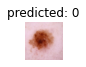

Actual: 0, predicted: 0


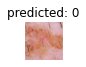

Actual: 0, predicted: 0


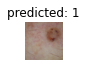

Actual: 0, predicted: 1


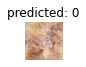

Actual: 0, predicted: 0


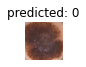

Actual: 0, predicted: 0


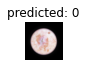

Actual: 0, predicted: 0


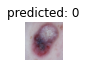

Actual: 0, predicted: 0


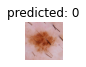

Actual: 0, predicted: 0


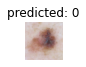

Actual: 0, predicted: 0


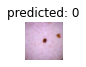

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Swin B V2

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_b_v2_ce_all.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin_v2_b(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_v2_b-781e5279.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_b-781e5279.pth


  0%|          | 0.00/336M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling')

Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val)
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [04:24<00:00,  1.20it/s]

train epoch 1 : loss : 0.5342, acc: 0.7993, kappa: 0.6232



100%|██████████| 20/20 [00:33<00:00,  1.66s/it]

val epoch 1 : loss : 0.3724, acc: 0.8638, kappa: 0.7432



Epoch 2/100
---------------


100%|██████████| 318/318 [04:23<00:00,  1.21it/s]

train epoch 2 : loss : 0.4062, acc: 0.8479, kappa: 0.7182



100%|██████████| 20/20 [00:33<00:00,  1.69s/it]

val epoch 2 : loss : 0.3388, acc: 0.8740, kappa: 0.7725



Epoch 3/100
---------------


100%|██████████| 318/318 [04:23<00:00,  1.21it/s]

train epoch 3 : loss : 0.3519, acc: 0.8688, kappa: 0.7588



100%|██████████| 20/20 [00:34<00:00,  1.74s/it]

val epoch 3 : loss : 0.2964, acc: 0.8866, kappa: 0.7929



Epoch 4/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 4 : loss : 0.3128, acc: 0.8841, kappa: 0.7879



100%|██████████| 20/20 [00:35<00:00,  1.78s/it]

val epoch 4 : loss : 0.3252, acc: 0.8843, kappa: 0.7832



Epoch 5/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 5 : loss : 0.2844, acc: 0.8961, kappa: 0.8095



100%|██████████| 20/20 [00:34<00:00,  1.70s/it]

val epoch 5 : loss : 0.2564, acc: 0.9126, kappa: 0.8399



Epoch 6/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 6 : loss : 0.2627, acc: 0.9008, kappa: 0.8193



100%|██████████| 20/20 [00:34<00:00,  1.74s/it]

val epoch 6 : loss : 0.2247, acc: 0.9118, kappa: 0.8394



Epoch 7/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 7 : loss : 0.2321, acc: 0.9148, kappa: 0.8449



100%|██████████| 20/20 [00:33<00:00,  1.69s/it]

val epoch 7 : loss : 0.2020, acc: 0.9354, kappa: 0.8827



Epoch 8/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 8 : loss : 0.2275, acc: 0.9160, kappa: 0.8472



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 8 : loss : 0.1872, acc: 0.9331, kappa: 0.8790



Epoch 9/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 9 : loss : 0.1921, acc: 0.9258, kappa: 0.8658



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 9 : loss : 0.2837, acc: 0.9189, kappa: 0.8521



Epoch 10/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 10 : loss : 0.1877, acc: 0.9323, kappa: 0.8773



100%|██████████| 20/20 [00:34<00:00,  1.70s/it]

val epoch 10 : loss : 0.1956, acc: 0.9260, kappa: 0.8681



Epoch 11/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 11 : loss : 0.1729, acc: 0.9400, kappa: 0.8915



100%|██████████| 20/20 [00:35<00:00,  1.77s/it]

val epoch 11 : loss : 0.1989, acc: 0.9299, kappa: 0.8727



Epoch 12/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 12 : loss : 0.1586, acc: 0.9414, kappa: 0.8940



100%|██████████| 20/20 [00:37<00:00,  1.88s/it]

val epoch 12 : loss : 0.2164, acc: 0.9331, kappa: 0.8782



Epoch 13/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 13 : loss : 0.1476, acc: 0.9482, kappa: 0.9064



100%|██████████| 20/20 [00:35<00:00,  1.80s/it]

val epoch 13 : loss : 0.1784, acc: 0.9433, kappa: 0.8977



Epoch 14/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 14 : loss : 0.1341, acc: 0.9545, kappa: 0.9179



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 14 : loss : 0.2093, acc: 0.9386, kappa: 0.8887



Epoch 15/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 15 : loss : 0.1448, acc: 0.9467, kappa: 0.9036



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 15 : loss : 0.1984, acc: 0.9362, kappa: 0.8849



Epoch 16/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 16 : loss : 0.1270, acc: 0.9549, kappa: 0.9187



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 16 : loss : 0.1836, acc: 0.9457, kappa: 0.9031



Epoch 17/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 17 : loss : 0.1318, acc: 0.9547, kappa: 0.9183



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 17 : loss : 0.1841, acc: 0.9394, kappa: 0.8916



Epoch 18/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 18 : loss : 0.1230, acc: 0.9577, kappa: 0.9236



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 18 : loss : 0.1892, acc: 0.9394, kappa: 0.8910



Epoch 19/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 19 : loss : 0.1188, acc: 0.9595, kappa: 0.9268



100%|██████████| 20/20 [00:33<00:00,  1.70s/it]

val epoch 19 : loss : 0.1940, acc: 0.9339, kappa: 0.8815



Epoch 20/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]


train epoch 20 : loss : 0.1126, acc: 0.9595, kappa: 0.9269


100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 20 : loss : 0.1590, acc: 0.9496, kappa: 0.9098



Epoch 21/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 21 : loss : 0.1012, acc: 0.9642, kappa: 0.9354



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 21 : loss : 0.1581, acc: 0.9480, kappa: 0.9057



Epoch 22/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 22 : loss : 0.1071, acc: 0.9626, kappa: 0.9325



100%|██████████| 20/20 [00:38<00:00,  1.90s/it]

val epoch 22 : loss : 0.1467, acc: 0.9504, kappa: 0.9113



Epoch 23/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 23 : loss : 0.1018, acc: 0.9630, kappa: 0.9333



100%|██████████| 20/20 [00:35<00:00,  1.76s/it]

val epoch 23 : loss : 0.1682, acc: 0.9394, kappa: 0.8917



Epoch 24/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 24 : loss : 0.1050, acc: 0.9630, kappa: 0.9332



100%|██████████| 20/20 [00:37<00:00,  1.90s/it]

val epoch 24 : loss : 0.1776, acc: 0.9433, kappa: 0.8984



Epoch 25/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 25 : loss : 0.0999, acc: 0.9634, kappa: 0.9340



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 25 : loss : 0.1668, acc: 0.9520, kappa: 0.9132



Epoch 26/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 26 : loss : 0.0833, acc: 0.9701, kappa: 0.9461



100%|██████████| 20/20 [00:34<00:00,  1.74s/it]

val epoch 26 : loss : 0.1851, acc: 0.9394, kappa: 0.8896



Epoch 27/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 27 : loss : 0.0985, acc: 0.9628, kappa: 0.9330



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 27 : loss : 0.1333, acc: 0.9598, kappa: 0.9273



Epoch 28/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 28 : loss : 0.0767, acc: 0.9721, kappa: 0.9496



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 28 : loss : 0.1487, acc: 0.9496, kappa: 0.9084



Epoch 29/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 29 : loss : 0.0857, acc: 0.9681, kappa: 0.9425



100%|██████████| 20/20 [00:34<00:00,  1.74s/it]

val epoch 29 : loss : 0.2039, acc: 0.9465, kappa: 0.9023



Epoch 30/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 30 : loss : 0.0892, acc: 0.9685, kappa: 0.9433



100%|██████████| 20/20 [00:34<00:00,  1.72s/it]

val epoch 30 : loss : 0.2671, acc: 0.9244, kappa: 0.8652



Epoch 31/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 31 : loss : 0.0754, acc: 0.9740, kappa: 0.9532



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 31 : loss : 0.2311, acc: 0.9417, kappa: 0.8945



Epoch 32/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 32 : loss : 0.0738, acc: 0.9744, kappa: 0.9539



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 32 : loss : 0.2329, acc: 0.9354, kappa: 0.8839



Epoch 33/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 33 : loss : 0.0812, acc: 0.9734, kappa: 0.9521



100%|██████████| 20/20 [00:34<00:00,  1.74s/it]

val epoch 33 : loss : 0.1748, acc: 0.9449, kappa: 0.9011



Epoch 34/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 34 : loss : 0.0816, acc: 0.9726, kappa: 0.9507



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 34 : loss : 0.1732, acc: 0.9480, kappa: 0.9069



Epoch 35/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 35 : loss : 0.0606, acc: 0.9807, kappa: 0.9653



100%|██████████| 20/20 [00:34<00:00,  1.75s/it]

val epoch 35 : loss : 0.1536, acc: 0.9583, kappa: 0.9258



Epoch 36/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 36 : loss : 0.0356, acc: 0.9870, kappa: 0.9766



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 36 : loss : 0.1275, acc: 0.9685, kappa: 0.9434



Epoch 37/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 37 : loss : 0.0258, acc: 0.9921, kappa: 0.9858



100%|██████████| 20/20 [00:34<00:00,  1.73s/it]

val epoch 37 : loss : 0.1225, acc: 0.9724, kappa: 0.9505



Epoch 38/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 38 : loss : 0.0168, acc: 0.9951, kappa: 0.9912



100%|██████████| 20/20 [00:35<00:00,  1.79s/it]

val epoch 38 : loss : 0.1242, acc: 0.9724, kappa: 0.9505



Epoch 39/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 39 : loss : 0.0192, acc: 0.9929, kappa: 0.9873



100%|██████████| 20/20 [00:35<00:00,  1.78s/it]

val epoch 39 : loss : 0.1247, acc: 0.9732, kappa: 0.9518



Epoch 40/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 40 : loss : 0.0182, acc: 0.9935, kappa: 0.9883



100%|██████████| 20/20 [00:35<00:00,  1.77s/it]

val epoch 40 : loss : 0.1262, acc: 0.9685, kappa: 0.9435



Epoch 41/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 41 : loss : 0.0156, acc: 0.9951, kappa: 0.9912



100%|██████████| 20/20 [00:35<00:00,  1.79s/it]

val epoch 41 : loss : 0.1399, acc: 0.9724, kappa: 0.9503



Epoch 42/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 42 : loss : 0.0177, acc: 0.9937, kappa: 0.9887



100%|██████████| 20/20 [00:35<00:00,  1.77s/it]

val epoch 42 : loss : 0.1281, acc: 0.9740, kappa: 0.9533



Epoch 43/100
---------------


100%|██████████| 318/318 [04:20<00:00,  1.22it/s]

train epoch 43 : loss : 0.0130, acc: 0.9957, kappa: 0.9922



100%|██████████| 20/20 [00:36<00:00,  1.81s/it]

val epoch 43 : loss : 0.1338, acc: 0.9724, kappa: 0.9504



Epoch 44/100
---------------


 80%|████████  | 255/318 [03:29<00:51,  1.22it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path, 
                   load_checkpoint=checkpoint_p)

Epoch 44/100
---------------


100%|██████████| 318/318 [34:14<00:00,  6.46s/it]


train epoch 44 : loss : 0.0167, acc: 0.9947, kappa: 0.9904


100%|██████████| 20/20 [08:40<00:00, 26.02s/it]

val epoch 44 : loss : 0.1334, acc: 0.9693, kappa: 0.9449



Epoch 45/100
---------------


100%|██████████| 318/318 [04:13<00:00,  1.25it/s]

train epoch 45 : loss : 0.0181, acc: 0.9939, kappa: 0.9890



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 45 : loss : 0.1330, acc: 0.9717, kappa: 0.9490



Epoch 46/100
---------------


100%|██████████| 318/318 [04:18<00:00,  1.23it/s]

train epoch 46 : loss : 0.0127, acc: 0.9959, kappa: 0.9926



100%|██████████| 20/20 [00:34<00:00,  1.70s/it]

val epoch 46 : loss : 0.1329, acc: 0.9717, kappa: 0.9490



Epoch 47/100
---------------


100%|██████████| 318/318 [04:18<00:00,  1.23it/s]

train epoch 47 : loss : 0.0149, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 47 : loss : 0.1321, acc: 0.9709, kappa: 0.9476



Epoch 48/100
---------------


100%|██████████| 318/318 [04:18<00:00,  1.23it/s]

train epoch 48 : loss : 0.0065, acc: 0.9982, kappa: 0.9968



100%|██████████| 20/20 [00:34<00:00,  1.71s/it]

val epoch 48 : loss : 0.1321, acc: 0.9717, kappa: 0.9490



Epoch 49/100
---------------


100%|██████████| 318/318 [04:19<00:00,  1.23it/s]

train epoch 49 : loss : 0.0165, acc: 0.9947, kappa: 0.9904



100%|██████████| 20/20 [00:33<00:00,  1.70s/it]

val epoch 49 : loss : 0.1316, acc: 0.9701, kappa: 0.9463



Epoch 50/100
---------------


100%|██████████| 318/318 [04:19<00:00,  1.23it/s]

train epoch 50 : loss : 0.0111, acc: 0.9955, kappa: 0.9919



100%|██████████| 20/20 [00:33<00:00,  1.67s/it]

val epoch 50 : loss : 0.1316, acc: 0.9701, kappa: 0.9461


EARLY STOP AFTER 50 EPOCHS
Training complete in 73m 0s
Best val loss: 0.122472
Best val Kappa: 0.9532871740913792


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:32<00:00,  1.63s/it]

Test Loss: 0.1281 Acc: 0.9740, kappa: 0.9533
Testing complete in 0m 33s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1281, acc: 0.9740, kappa: 0.9533


Show some results

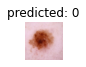

Actual: 0, predicted: 0


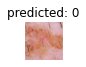

Actual: 0, predicted: 0


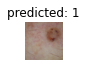

Actual: 0, predicted: 1


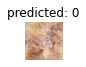

Actual: 0, predicted: 0


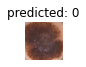

Actual: 0, predicted: 0


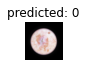

Actual: 0, predicted: 0


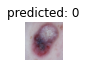

Actual: 0, predicted: 0


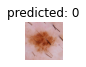

Actual: 0, predicted: 0


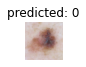

Actual: 0, predicted: 0


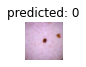

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Swin B V2.2

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_b_v2_ce_all_2.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-6

In [ ]:
swin = make_swin_v2_b(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_v2_b-781e5279.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_b-781e5279.pth


  0%|          | 0.00/336M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, without sampling')

Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-6, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_2_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [04:26<00:00,  1.19it/s]

train epoch 1 : loss : 0.4261, acc: 0.8428, kappa: 0.7068



100%|██████████| 20/20 [06:10<00:00, 18.55s/it]

val epoch 1 : loss : 0.3508, acc: 0.8693, kappa: 0.7560



Epoch 2/100
---------------


100%|██████████| 318/318 [04:31<00:00,  1.17it/s]

train epoch 2 : loss : 0.3622, acc: 0.8656, kappa: 0.7528



100%|██████████| 20/20 [00:40<00:00,  2.04s/it]

val epoch 2 : loss : 0.3045, acc: 0.8882, kappa: 0.7952



Epoch 3/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 3 : loss : 0.3213, acc: 0.8839, kappa: 0.7876



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 3 : loss : 0.3051, acc: 0.8929, kappa: 0.7999



Epoch 4/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 4 : loss : 0.2792, acc: 0.8951, kappa: 0.8088



100%|██████████| 20/20 [00:39<00:00,  1.95s/it]

val epoch 4 : loss : 0.2790, acc: 0.8969, kappa: 0.8123



Epoch 5/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 5 : loss : 0.2634, acc: 0.9052, kappa: 0.8270



100%|██████████| 20/20 [00:38<00:00,  1.94s/it]

val epoch 5 : loss : 0.2386, acc: 0.9150, kappa: 0.8458



Epoch 6/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.13it/s]

train epoch 6 : loss : 0.2409, acc: 0.9109, kappa: 0.8379



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 6 : loss : 0.2262, acc: 0.9173, kappa: 0.8513



Epoch 7/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.13it/s]

train epoch 7 : loss : 0.2196, acc: 0.9205, kappa: 0.8561



100%|██████████| 20/20 [00:38<00:00,  1.94s/it]

val epoch 7 : loss : 0.2072, acc: 0.9236, kappa: 0.8623



Epoch 8/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 8 : loss : 0.2032, acc: 0.9268, kappa: 0.8674



100%|██████████| 20/20 [00:38<00:00,  1.90s/it]

val epoch 8 : loss : 0.2139, acc: 0.9291, kappa: 0.8731



Epoch 9/100
---------------


100%|██████████| 318/318 [04:41<00:00,  1.13it/s]

train epoch 9 : loss : 0.1881, acc: 0.9292, kappa: 0.8719



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 9 : loss : 0.2408, acc: 0.9189, kappa: 0.8529



Epoch 10/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.14it/s]

train epoch 10 : loss : 0.1781, acc: 0.9382, kappa: 0.8880



100%|██████████| 20/20 [00:38<00:00,  1.95s/it]

val epoch 10 : loss : 0.2049, acc: 0.9291, kappa: 0.8717



Epoch 11/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 11 : loss : 0.1599, acc: 0.9416, kappa: 0.8943



100%|██████████| 20/20 [00:39<00:00,  1.95s/it]

val epoch 11 : loss : 0.2047, acc: 0.9354, kappa: 0.8821



Epoch 12/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 12 : loss : 0.1517, acc: 0.9449, kappa: 0.9005



100%|██████████| 20/20 [00:36<00:00,  1.85s/it]

val epoch 12 : loss : 0.2281, acc: 0.9252, kappa: 0.8630



Epoch 13/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 13 : loss : 0.1526, acc: 0.9445, kappa: 0.8997



100%|██████████| 20/20 [00:38<00:00,  1.95s/it]

val epoch 13 : loss : 0.2724, acc: 0.9236, kappa: 0.8600



Epoch 14/100
---------------


100%|██████████| 318/318 [04:38<00:00,  1.14it/s]

train epoch 14 : loss : 0.1416, acc: 0.9520, kappa: 0.9132



100%|██████████| 20/20 [00:37<00:00,  1.90s/it]

val epoch 14 : loss : 0.2394, acc: 0.9236, kappa: 0.8642



Epoch 15/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 15 : loss : 0.1363, acc: 0.9500, kappa: 0.9099



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 15 : loss : 0.1869, acc: 0.9394, kappa: 0.8906



Epoch 16/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.13it/s]

train epoch 16 : loss : 0.1125, acc: 0.9597, kappa: 0.9271



100%|██████████| 20/20 [00:37<00:00,  1.88s/it]

val epoch 16 : loss : 0.1885, acc: 0.9449, kappa: 0.9008



Epoch 17/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 17 : loss : 0.1304, acc: 0.9536, kappa: 0.9162



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 17 : loss : 0.1902, acc: 0.9425, kappa: 0.8971



Epoch 18/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 18 : loss : 0.1100, acc: 0.9601, kappa: 0.9280



100%|██████████| 20/20 [00:36<00:00,  1.82s/it]

val epoch 18 : loss : 0.2321, acc: 0.9331, kappa: 0.8783



Epoch 19/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 19 : loss : 0.1073, acc: 0.9642, kappa: 0.9354



100%|██████████| 20/20 [00:38<00:00,  1.95s/it]

val epoch 19 : loss : 0.2285, acc: 0.9307, kappa: 0.8748



Epoch 20/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 20 : loss : 0.1020, acc: 0.9656, kappa: 0.9378



100%|██████████| 20/20 [00:38<00:00,  1.91s/it]

val epoch 20 : loss : 0.3044, acc: 0.9268, kappa: 0.8680



Epoch 21/100
---------------


100%|██████████| 318/318 [04:38<00:00,  1.14it/s]

train epoch 21 : loss : 0.1031, acc: 0.9626, kappa: 0.9326



100%|██████████| 20/20 [00:38<00:00,  1.93s/it]

val epoch 21 : loss : 0.1567, acc: 0.9480, kappa: 0.9058



Epoch 22/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 22 : loss : 0.1074, acc: 0.9644, kappa: 0.9358



100%|██████████| 20/20 [00:38<00:00,  1.93s/it]

val epoch 22 : loss : 0.2537, acc: 0.9244, kappa: 0.8670



Epoch 23/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 23 : loss : 0.0990, acc: 0.9656, kappa: 0.9379



100%|██████████| 20/20 [00:38<00:00,  1.92s/it]

val epoch 23 : loss : 0.2433, acc: 0.9394, kappa: 0.8899



Epoch 24/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 24 : loss : 0.0942, acc: 0.9683, kappa: 0.9429



100%|██████████| 20/20 [00:37<00:00,  1.90s/it]

val epoch 24 : loss : 0.2474, acc: 0.9346, kappa: 0.8815



Epoch 25/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 25 : loss : 0.0986, acc: 0.9630, kappa: 0.9333



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 25 : loss : 0.1773, acc: 0.9543, kappa: 0.9178



Epoch 26/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 26 : loss : 0.0880, acc: 0.9691, kappa: 0.9443



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 26 : loss : 0.1953, acc: 0.9433, kappa: 0.8977



Epoch 27/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 27 : loss : 0.0882, acc: 0.9699, kappa: 0.9457



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 27 : loss : 0.1673, acc: 0.9441, kappa: 0.8996



Epoch 28/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.13it/s]

train epoch 28 : loss : 0.0971, acc: 0.9644, kappa: 0.9358



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 28 : loss : 0.1839, acc: 0.9551, kappa: 0.9192



Epoch 29/100
---------------


100%|██████████| 318/318 [04:40<00:00,  1.13it/s]

train epoch 29 : loss : 0.0740, acc: 0.9784, kappa: 0.9610



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 29 : loss : 0.2116, acc: 0.9354, kappa: 0.8843



Epoch 30/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 30 : loss : 0.0597, acc: 0.9803, kappa: 0.9646



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 30 : loss : 0.1728, acc: 0.9472, kappa: 0.9048



Epoch 31/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 31 : loss : 0.0361, acc: 0.9868, kappa: 0.9763



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 31 : loss : 0.1671, acc: 0.9496, kappa: 0.9092



Epoch 32/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 32 : loss : 0.0339, acc: 0.9888, kappa: 0.9798



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 32 : loss : 0.1632, acc: 0.9543, kappa: 0.9178



Epoch 33/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 33 : loss : 0.0252, acc: 0.9937, kappa: 0.9887



100%|██████████| 20/20 [00:37<00:00,  1.86s/it]

val epoch 33 : loss : 0.1728, acc: 0.9567, kappa: 0.9223



Epoch 34/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 34 : loss : 0.0222, acc: 0.9927, kappa: 0.9869



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 34 : loss : 0.1700, acc: 0.9598, kappa: 0.9279


EARLY STOP AFTER 34 EPOCHS
Training complete in 187m 58s
Best val loss: 0.156665
Best val Kappa: 0.9278508762158525


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:41<00:00,  2.07s/it]

Test Loss: 0.1700 Acc: 0.9598, kappa: 0.9279
Testing complete in 0m 41s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1700, acc: 0.9598, kappa: 0.9279


Show some results

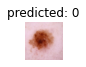

Actual: 0, predicted: 0


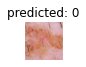

Actual: 0, predicted: 0


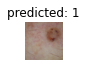

Actual: 0, predicted: 1


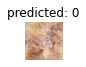

Actual: 0, predicted: 0


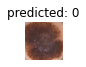

Actual: 0, predicted: 0


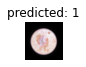

Actual: 0, predicted: 1


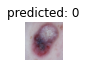

Actual: 0, predicted: 0


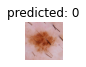

Actual: 0, predicted: 0


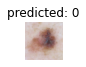

Actual: 0, predicted: 0


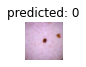

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Swin B V2.3

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_b_v2_ce_all_3.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 7
ES_PATIENCE = 12

EPOCHS = 100
WD = 1e-9

In [ ]:
swin = make_swin_v2_b(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_v2_b-781e5279.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_b-781e5279.pth


  0%|          | 0.00/336M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-9, without sampling')

Model:swin_b_v2, LR: 1e-4, LR patience = 7, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-9, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_3_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 1 : loss : 0.5728, acc: 0.7826, kappa: 0.5913



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 1 : loss : 0.4388, acc: 0.8370, kappa: 0.6970



Epoch 2/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 2 : loss : 0.4185, acc: 0.8396, kappa: 0.7014



100%|██████████| 20/20 [00:35<00:00,  1.80s/it]

val epoch 2 : loss : 0.3799, acc: 0.8567, kappa: 0.7336



Epoch 3/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 3 : loss : 0.3683, acc: 0.8591, kappa: 0.7396



100%|██████████| 20/20 [00:39<00:00,  1.98s/it]

val epoch 3 : loss : 0.2873, acc: 0.8882, kappa: 0.7927



Epoch 4/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 4 : loss : 0.3230, acc: 0.8756, kappa: 0.7721



100%|██████████| 20/20 [00:36<00:00,  1.81s/it]

val epoch 4 : loss : 0.2674, acc: 0.8984, kappa: 0.8137



Epoch 5/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 5 : loss : 0.3035, acc: 0.8876, kappa: 0.7942



100%|██████████| 20/20 [00:39<00:00,  2.00s/it]

val epoch 5 : loss : 0.2972, acc: 0.8937, kappa: 0.8141



Epoch 6/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 6 : loss : 0.2638, acc: 0.9067, kappa: 0.8297



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 6 : loss : 0.2392, acc: 0.9150, kappa: 0.8473



Epoch 7/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 7 : loss : 0.2511, acc: 0.9144, kappa: 0.8443



100%|██████████| 20/20 [00:40<00:00,  2.01s/it]

val epoch 7 : loss : 0.2225, acc: 0.9228, kappa: 0.8589



Epoch 8/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 8 : loss : 0.2231, acc: 0.9225, kappa: 0.8587



100%|██████████| 20/20 [00:35<00:00,  1.80s/it]

val epoch 8 : loss : 0.2386, acc: 0.9094, kappa: 0.8387



Epoch 9/100
---------------


100%|██████████| 318/318 [04:39<00:00,  1.14it/s]

train epoch 9 : loss : 0.2016, acc: 0.9260, kappa: 0.8659



100%|██████████| 20/20 [00:40<00:00,  2.01s/it]

val epoch 9 : loss : 0.1779, acc: 0.9354, kappa: 0.8822



Epoch 10/100
---------------


 10%|█         | 33/318 [00:30<04:13,  1.12it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_3_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path,
                   load_checkpoint=checkpoint_p)

Epoch 10/100
---------------


100%|██████████| 318/318 [15:24<00:00,  2.91s/it]


train epoch 10 : loss : 0.1927, acc: 0.9327, kappa: 0.8780


100%|██████████| 20/20 [03:37<00:00, 10.89s/it]

val epoch 10 : loss : 0.1997, acc: 0.9386, kappa: 0.8889



Epoch 11/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 11 : loss : 0.1847, acc: 0.9315, kappa: 0.8758



100%|██████████| 20/20 [00:37<00:00,  1.88s/it]

val epoch 11 : loss : 0.2066, acc: 0.9299, kappa: 0.8737



Epoch 12/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 12 : loss : 0.1706, acc: 0.9347, kappa: 0.8818



100%|██████████| 20/20 [00:36<00:00,  1.85s/it]

val epoch 12 : loss : 0.1938, acc: 0.9307, kappa: 0.8774



Epoch 13/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 13 : loss : 0.1609, acc: 0.9418, kappa: 0.8948



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 13 : loss : 0.2216, acc: 0.9283, kappa: 0.8716



Epoch 14/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 14 : loss : 0.1478, acc: 0.9490, kappa: 0.9081



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 14 : loss : 0.2084, acc: 0.9244, kappa: 0.8626



Epoch 15/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 15 : loss : 0.1496, acc: 0.9453, kappa: 0.9011



100%|██████████| 20/20 [00:36<00:00,  1.81s/it]

val epoch 15 : loss : 0.1762, acc: 0.9362, kappa: 0.8860



Epoch 16/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 16 : loss : 0.1383, acc: 0.9514, kappa: 0.9122



100%|██████████| 20/20 [00:36<00:00,  1.82s/it]

val epoch 16 : loss : 0.2086, acc: 0.9323, kappa: 0.8782



Epoch 17/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 17 : loss : 0.1264, acc: 0.9575, kappa: 0.9233



100%|██████████| 20/20 [00:35<00:00,  1.79s/it]

val epoch 17 : loss : 0.2085, acc: 0.9291, kappa: 0.8700



Epoch 18/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.22it/s]

train epoch 18 : loss : 0.1218, acc: 0.9579, kappa: 0.9239



100%|██████████| 20/20 [00:36<00:00,  1.81s/it]

val epoch 18 : loss : 0.2038, acc: 0.9339, kappa: 0.8827



Epoch 19/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 19 : loss : 0.1179, acc: 0.9608, kappa: 0.9293



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 19 : loss : 0.2396, acc: 0.9315, kappa: 0.8789



Epoch 20/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 20 : loss : 0.1076, acc: 0.9650, kappa: 0.9368



100%|██████████| 20/20 [00:37<00:00,  1.88s/it]

val epoch 20 : loss : 0.2134, acc: 0.9378, kappa: 0.8878



Epoch 21/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 21 : loss : 0.1149, acc: 0.9579, kappa: 0.9240



100%|██████████| 20/20 [00:37<00:00,  1.87s/it]

val epoch 21 : loss : 0.2278, acc: 0.9299, kappa: 0.8751



Epoch 22/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 22 : loss : 0.1065, acc: 0.9622, kappa: 0.9319



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 22 : loss : 0.1972, acc: 0.9386, kappa: 0.8889



Epoch 23/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 23 : loss : 0.1037, acc: 0.9636, kappa: 0.9344



100%|██████████| 20/20 [00:35<00:00,  1.78s/it]

val epoch 23 : loss : 0.2018, acc: 0.9417, kappa: 0.8934



Epoch 24/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 24 : loss : 0.0683, acc: 0.9780, kappa: 0.9602



100%|██████████| 20/20 [00:35<00:00,  1.79s/it]

val epoch 24 : loss : 0.1596, acc: 0.9551, kappa: 0.9191



Epoch 25/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 25 : loss : 0.0477, acc: 0.9854, kappa: 0.9738



100%|██████████| 20/20 [00:36<00:00,  1.80s/it]

val epoch 25 : loss : 0.1575, acc: 0.9512, kappa: 0.9116



Epoch 26/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 26 : loss : 0.0384, acc: 0.9864, kappa: 0.9756



100%|██████████| 20/20 [00:36<00:00,  1.82s/it]

val epoch 26 : loss : 0.1511, acc: 0.9551, kappa: 0.9191



Epoch 27/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 27 : loss : 0.0326, acc: 0.9892, kappa: 0.9805



100%|██████████| 20/20 [00:36<00:00,  1.82s/it]

val epoch 27 : loss : 0.1646, acc: 0.9543, kappa: 0.9173



Epoch 28/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 28 : loss : 0.0296, acc: 0.9908, kappa: 0.9834



100%|██████████| 20/20 [00:36<00:00,  1.85s/it]

val epoch 28 : loss : 0.1625, acc: 0.9567, kappa: 0.9218



Epoch 29/100
---------------


100%|██████████| 318/318 [04:23<00:00,  1.21it/s]

train epoch 29 : loss : 0.0303, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 29 : loss : 0.1547, acc: 0.9614, kappa: 0.9304



Epoch 30/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 30 : loss : 0.0245, acc: 0.9911, kappa: 0.9841



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 30 : loss : 0.1736, acc: 0.9598, kappa: 0.9274



Epoch 31/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 31 : loss : 0.0234, acc: 0.9909, kappa: 0.9837



100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

val epoch 31 : loss : 0.1621, acc: 0.9614, kappa: 0.9305



Epoch 32/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 32 : loss : 0.0214, acc: 0.9919, kappa: 0.9855



100%|██████████| 20/20 [00:35<00:00,  1.77s/it]

val epoch 32 : loss : 0.1638, acc: 0.9614, kappa: 0.9305



Epoch 33/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 33 : loss : 0.0198, acc: 0.9943, kappa: 0.9897



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 33 : loss : 0.1602, acc: 0.9646, kappa: 0.9358



Epoch 34/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 34 : loss : 0.0157, acc: 0.9953, kappa: 0.9915



100%|██████████| 20/20 [00:36<00:00,  1.81s/it]

val epoch 34 : loss : 0.1605, acc: 0.9630, kappa: 0.9331



Epoch 35/100
---------------


100%|██████████| 318/318 [04:21<00:00,  1.21it/s]

train epoch 35 : loss : 0.0177, acc: 0.9939, kappa: 0.9890



100%|██████████| 20/20 [00:36<00:00,  1.85s/it]

val epoch 35 : loss : 0.1589, acc: 0.9638, kappa: 0.9346



Epoch 36/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 36 : loss : 0.0146, acc: 0.9949, kappa: 0.9908



100%|██████████| 20/20 [00:37<00:00,  1.85s/it]

val epoch 36 : loss : 0.1554, acc: 0.9630, kappa: 0.9333



Epoch 37/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 37 : loss : 0.0204, acc: 0.9933, kappa: 0.9880



100%|██████████| 20/20 [00:35<00:00,  1.78s/it]

val epoch 37 : loss : 0.1544, acc: 0.9646, kappa: 0.9361



Epoch 38/100
---------------


100%|██████████| 318/318 [04:23<00:00,  1.21it/s]

train epoch 38 : loss : 0.0148, acc: 0.9965, kappa: 0.9936



100%|██████████| 20/20 [00:36<00:00,  1.80s/it]

val epoch 38 : loss : 0.1556, acc: 0.9661, kappa: 0.9390



Epoch 39/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 39 : loss : 0.0148, acc: 0.9953, kappa: 0.9915



100%|██████████| 20/20 [00:36<00:00,  1.82s/it]

val epoch 39 : loss : 0.1580, acc: 0.9654, kappa: 0.9375


EARLY STOP AFTER 39 EPOCHS
Training complete in 166m 11s
Best val loss: 0.151072
Best val Kappa: 0.9389575955932324


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_3_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:35<00:00,  1.76s/it]

Test Loss: 0.1556 Acc: 0.9661, kappa: 0.9390
Testing complete in 0m 35s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1556, acc: 0.9661, kappa: 0.9390


Show some results

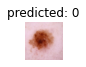

Actual: 0, predicted: 0


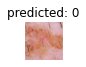

Actual: 0, predicted: 0


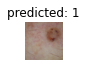

Actual: 0, predicted: 1


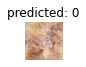

Actual: 0, predicted: 0


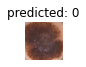

Actual: 0, predicted: 0


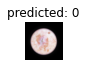

Actual: 0, predicted: 0


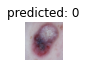

Actual: 0, predicted: 0


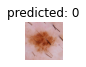

Actual: 0, predicted: 0


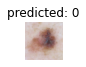

Actual: 0, predicted: 0


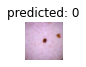

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

#### Swin B V2.4

In [ ]:
logging.basicConfig(filename="/content/drive/MyDrive/CAD_DL_TB/Swin/swin_b_v2_ce_all_4.txt", level=logging.INFO,
                        format='[%(asctime)s.%(msecs)03d] %(message)s', datefmt='%H:%M:%S', force=True)
logging.getLogger().addHandler(logging.StreamHandler(sys.stdout))
writer_path = '/content/drive/MyDrive/CAD_DL_TB/Swin'

In [ ]:
# Parameters 
DEVICE = "cuda" if torch.cuda.is_available() else "cpu" # Device used
LR = 1e-4
LR_PATIENCE = 5
ES_PATIENCE = 15

EPOCHS = 100
WD = 1e-8

In [ ]:
swin = make_swin_v2_b(True, DEVICE)

criterion = nn.CrossEntropyLoss() # no weights

optimizer = optim.Adam(swin.parameters(), lr = LR, weight_decay=WD) 

lr_scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience= LR_PATIENCE, factor = 0.1, mode="min")

Downloading: "https://download.pytorch.org/models/swin_v2_b-781e5279.pth" to /root/.cache/torch/hub/checkpoints/swin_v2_b-781e5279.pth


  0%|          | 0.00/336M [00:00<?, ?B/s]

In [ ]:
logging.info('Model:swin_b_v2, LR: 1e-4, LR patience = 5, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling')

Model:swin_b_v2, LR: 1e-4, LR patience = 5, loss: CE, optim: ADAM, lr_sched: ReduceOnPlat, WD = 1e-8, without sampling


In [ ]:
#number of samples in each set
dataset_sizes = {
    'train': len(dataset_train),
    'val':len(dataset_val),
}

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_4_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path)

Epoch 1/100
---------------


100%|██████████| 318/318 [04:26<00:00,  1.19it/s]

train epoch 1 : loss : 0.5515, acc: 0.7879, kappa: 0.6025



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 1 : loss : 0.3647, acc: 0.8685, kappa: 0.7534



Epoch 2/100
---------------


100%|██████████| 318/318 [04:23<00:00,  1.21it/s]

train epoch 2 : loss : 0.4146, acc: 0.8432, kappa: 0.7082



100%|██████████| 20/20 [00:35<00:00,  1.76s/it]

val epoch 2 : loss : 0.4147, acc: 0.8417, kappa: 0.7106



Epoch 3/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 3 : loss : 0.3532, acc: 0.8697, kappa: 0.7598



100%|██████████| 20/20 [00:34<00:00,  1.75s/it]

val epoch 3 : loss : 0.3455, acc: 0.8724, kappa: 0.7692



Epoch 4/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 4 : loss : 0.3221, acc: 0.8833, kappa: 0.7865



100%|██████████| 20/20 [00:35<00:00,  1.78s/it]

val epoch 4 : loss : 0.3363, acc: 0.8669, kappa: 0.7674



Epoch 5/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 5 : loss : 0.2817, acc: 0.8943, kappa: 0.8073



100%|██████████| 20/20 [00:34<00:00,  1.75s/it]

val epoch 5 : loss : 0.2817, acc: 0.8953, kappa: 0.8078



Epoch 6/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 6 : loss : 0.2599, acc: 0.9069, kappa: 0.8305



100%|██████████| 20/20 [00:35<00:00,  1.76s/it]

val epoch 6 : loss : 0.2857, acc: 0.9047, kappa: 0.8226



Epoch 7/100
---------------


100%|██████████| 318/318 [04:22<00:00,  1.21it/s]

train epoch 7 : loss : 0.2344, acc: 0.9148, kappa: 0.8451



100%|██████████| 20/20 [00:35<00:00,  1.75s/it]

val epoch 7 : loss : 0.2901, acc: 0.9157, kappa: 0.8469



Epoch 8/100
---------------


  7%|▋         | 23/318 [00:20<04:08,  1.19it/s]

In [ ]:
checkpoint_p = '/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_4_ce.pth'
swin = train_model(swin, dataloaders, criterion, optimizer, lr_scheduler, checkpoint_p, early_stop_patience=ES_PATIENCE, num_epochs=EPOCHS, writer_path = writer_path,
                   load_checkpoint=checkpoint_p)

Epoch 8/100
---------------


100%|██████████| 318/318 [15:22<00:00,  2.90s/it]


train epoch 8 : loss : 0.2438, acc: 0.9087, kappa: 0.8335


100%|██████████| 20/20 [03:50<00:00, 11.53s/it]

val epoch 8 : loss : 0.2299, acc: 0.9142, kappa: 0.8455



Epoch 9/100
---------------


100%|██████████| 318/318 [04:27<00:00,  1.19it/s]

train epoch 9 : loss : 0.2100, acc: 0.9256, kappa: 0.8651



100%|██████████| 20/20 [00:40<00:00,  2.03s/it]

val epoch 9 : loss : 0.2337, acc: 0.9205, kappa: 0.8570



Epoch 10/100
---------------


100%|██████████| 318/318 [04:35<00:00,  1.15it/s]

train epoch 10 : loss : 0.1972, acc: 0.9288, kappa: 0.8707



100%|██████████| 20/20 [00:44<00:00,  2.24s/it]

val epoch 10 : loss : 0.1953, acc: 0.9276, kappa: 0.8678



Epoch 11/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 11 : loss : 0.1772, acc: 0.9339, kappa: 0.8803



100%|██████████| 20/20 [00:40<00:00,  2.04s/it]

val epoch 11 : loss : 0.3361, acc: 0.8945, kappa: 0.8082



Epoch 12/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 12 : loss : 0.1652, acc: 0.9404, kappa: 0.8922



100%|██████████| 20/20 [00:40<00:00,  2.05s/it]

val epoch 12 : loss : 0.2046, acc: 0.9354, kappa: 0.8828



Epoch 13/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 13 : loss : 0.1579, acc: 0.9457, kappa: 0.9017



100%|██████████| 20/20 [00:41<00:00,  2.08s/it]

val epoch 13 : loss : 0.2121, acc: 0.9339, kappa: 0.8798



Epoch 14/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 14 : loss : 0.1496, acc: 0.9481, kappa: 0.9061



100%|██████████| 20/20 [00:40<00:00,  2.00s/it]

val epoch 14 : loss : 0.2405, acc: 0.9244, kappa: 0.8627



Epoch 15/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 15 : loss : 0.1399, acc: 0.9488, kappa: 0.9076



100%|██████████| 20/20 [00:42<00:00,  2.11s/it]

val epoch 15 : loss : 0.2330, acc: 0.9268, kappa: 0.8667



Epoch 16/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 16 : loss : 0.1259, acc: 0.9587, kappa: 0.9254



100%|██████████| 20/20 [00:39<00:00,  1.98s/it]

val epoch 16 : loss : 0.2935, acc: 0.9055, kappa: 0.8374



Epoch 17/100
---------------


100%|██████████| 318/318 [04:34<00:00,  1.16it/s]

train epoch 17 : loss : 0.0784, acc: 0.9732, kappa: 0.9519



100%|██████████| 20/20 [00:40<00:00,  2.02s/it]

val epoch 17 : loss : 0.1583, acc: 0.9606, kappa: 0.9290



Epoch 18/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 18 : loss : 0.0497, acc: 0.9839, kappa: 0.9709



100%|██████████| 20/20 [00:40<00:00,  2.05s/it]

val epoch 18 : loss : 0.1674, acc: 0.9543, kappa: 0.9179



Epoch 19/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 19 : loss : 0.0487, acc: 0.9845, kappa: 0.9720



100%|██████████| 20/20 [00:44<00:00,  2.25s/it]

val epoch 19 : loss : 0.1643, acc: 0.9551, kappa: 0.9189



Epoch 20/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 20 : loss : 0.0372, acc: 0.9876, kappa: 0.9777



100%|██████████| 20/20 [00:40<00:00,  2.03s/it]

val epoch 20 : loss : 0.1774, acc: 0.9528, kappa: 0.9146



Epoch 21/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 21 : loss : 0.0412, acc: 0.9850, kappa: 0.9731



100%|██████████| 20/20 [00:40<00:00,  2.03s/it]

val epoch 21 : loss : 0.1745, acc: 0.9591, kappa: 0.9263



Epoch 22/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 22 : loss : 0.0321, acc: 0.9890, kappa: 0.9802



100%|██████████| 20/20 [00:44<00:00,  2.24s/it]

val epoch 22 : loss : 0.1712, acc: 0.9575, kappa: 0.9238



Epoch 23/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 23 : loss : 0.0343, acc: 0.9874, kappa: 0.9773



100%|██████████| 20/20 [00:40<00:00,  2.02s/it]

val epoch 23 : loss : 0.1836, acc: 0.9591, kappa: 0.9261



Epoch 24/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 24 : loss : 0.0358, acc: 0.9872, kappa: 0.9770



100%|██████████| 20/20 [00:40<00:00,  2.03s/it]

val epoch 24 : loss : 0.1787, acc: 0.9575, kappa: 0.9233



Epoch 25/100
---------------


100%|██████████| 318/318 [04:33<00:00,  1.16it/s]

train epoch 25 : loss : 0.0267, acc: 0.9902, kappa: 0.9823



100%|██████████| 20/20 [00:41<00:00,  2.07s/it]

val epoch 25 : loss : 0.1786, acc: 0.9567, kappa: 0.9220



Epoch 26/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 26 : loss : 0.0243, acc: 0.9919, kappa: 0.9855



100%|██████████| 20/20 [00:39<00:00,  1.97s/it]

val epoch 26 : loss : 0.1790, acc: 0.9575, kappa: 0.9234



Epoch 27/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 27 : loss : 0.0275, acc: 0.9900, kappa: 0.9819



100%|██████████| 20/20 [00:36<00:00,  1.83s/it]

val epoch 27 : loss : 0.1760, acc: 0.9551, kappa: 0.9191



Epoch 28/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 28 : loss : 0.0291, acc: 0.9890, kappa: 0.9802



100%|██████████| 20/20 [00:35<00:00,  1.80s/it]

val epoch 28 : loss : 0.1743, acc: 0.9535, kappa: 0.9163



Epoch 29/100
---------------


100%|██████████| 318/318 [04:34<00:00,  1.16it/s]

train epoch 29 : loss : 0.0376, acc: 0.9880, kappa: 0.9784



100%|██████████| 20/20 [00:39<00:00,  1.98s/it]

val epoch 29 : loss : 0.1725, acc: 0.9551, kappa: 0.9192



Epoch 30/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 30 : loss : 0.0287, acc: 0.9892, kappa: 0.9805



100%|██████████| 20/20 [00:37<00:00,  1.88s/it]

val epoch 30 : loss : 0.1728, acc: 0.9551, kappa: 0.9192



Epoch 31/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 31 : loss : 0.0251, acc: 0.9917, kappa: 0.9851



100%|██████████| 20/20 [00:37<00:00,  1.85s/it]

val epoch 31 : loss : 0.1729, acc: 0.9551, kappa: 0.9192



Epoch 32/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 32 : loss : 0.0260, acc: 0.9917, kappa: 0.9851



100%|██████████| 20/20 [00:43<00:00,  2.18s/it]

val epoch 32 : loss : 0.1731, acc: 0.9551, kappa: 0.9192



Epoch 33/100
---------------


100%|██████████| 318/318 [04:32<00:00,  1.17it/s]

train epoch 33 : loss : 0.0282, acc: 0.9900, kappa: 0.9820



100%|██████████| 20/20 [00:36<00:00,  1.85s/it]

val epoch 33 : loss : 0.1731, acc: 0.9543, kappa: 0.9177


EARLY STOP AFTER 33 EPOCHS
Training complete in 152m 11s
Best val loss: 0.158264
Best val Kappa: 0.9290204599921308


##### Test

In [ ]:
swin.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_4_ce_best.pth'))

<All keys matched successfully>

In [ ]:
val_loss, val_acc, val_kappa = test_model(swin, val_loader, DEVICE, criterion)

100%|██████████| 20/20 [00:36<00:00,  1.84s/it]

Test Loss: 0.1583 Acc: 0.9606, kappa: 0.9290
Testing complete in 0m 37s


In [ ]:
logging.info('Final val loss: %.4f, acc: %.4f, kappa: %.4f' % (val_loss, val_acc, val_kappa))

Final val loss: 0.1583, acc: 0.9606, kappa: 0.9290


Show some results

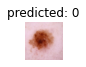

Actual: 0, predicted: 0


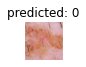

Actual: 0, predicted: 0


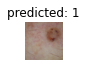

Actual: 0, predicted: 1


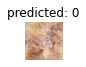

Actual: 0, predicted: 0


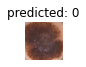

Actual: 0, predicted: 0


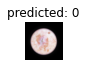

Actual: 0, predicted: 0


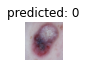

Actual: 0, predicted: 0


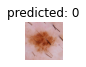

Actual: 0, predicted: 0


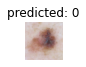

Actual: 0, predicted: 0


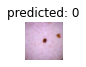

Actual: 0, predicted: 0


In [ ]:
visualize_model(swin, val_loader, DEVICE, num_images=10)

## Test Time Augmentation

In [ ]:
best_model = make_swin_v2_b(False, DEVICE)

In [ ]:
best_model.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce_best.pth'))
best_model.eval()

In [ ]:
tta_transforms = A.Compose(
                            [   
                                A.SmallestMaxSize(max_size=260),
                                A.RandomResizedCrop(height=256, width=256, p = 0.5, scale=(0.4, 1.0), ratio=(0.75, 4/3)),
                                A.Affine(scale=(0.8, 1.2), rotate=(0.0, 90.0), shear=(0.0, 20.0), mode=1, p=0.5),
                                A.Flip(p=0.5),
                                A.ColorJitter(brightness=[0.7, 1.3], contrast=[0.7, 1.3], saturation=[0.9, 1.1], hue=0.05, p=0.5),
                            ]
                        )

In [ ]:
val_df = pd.read_csv(val_csv_path).drop("Unnamed: 0", axis = 1)

In [ ]:
preds = np.zeros((len(val_df), 10))
labels = []

In [ ]:
for i, row in val_df.iterrows():
  img_id = '/' + row['image_id'] # obtain image file name start 
  
  img_path = val_img_folder + img_id[0:4] + img_id + '.jpg' # file path of the original image 
  image = Image.open(img_path)  # open the original image as RGB

  label = row['label'] # get the image's correct class
  labels.append(label)
  image_np = np.array(image) # albumentations only works with np arrays so convert from PIL 

  for j in range(10):
    augmentations = tta_transforms(image=image_np) # apply the transform 
    image = Image.fromarray(augmentations["image"]) # convert back to PIL to use torchvision transforms
    image = img_transforms(image).unsqueeze(0).to(DEVICE)
    outputs = best_model(image)
    _, pred = torch.max(outputs, 1)
    preds[i, j] = pred
  print(f'Image {i} done')

In [ ]:
labels_pred = np.array([Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds])

In [ ]:
preds_ls = labels_pred.tolist()

In [ ]:
test_kappa = cohen_kappa_score(labels, preds_ls)
test_acc = accuracy_score(labels, preds_ls)
print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

Test Acc: 0.9732, kappa: 0.9518


## Best Single Model

In [ ]:
swin_best = make_swin_v2_b(False, DEVICE)
swin_best.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
since = time.time()

swin_best.eval()

running_labels = []
running_preds = []
outputs_all = []
# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs = swin_best(inputs)
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
        probas = F.softmax(outputs, dim=1)
        outputs_all.append(probas.cpu().numpy())
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:53<00:00,  2.66s/it]

Test Acc: 0.9740, kappa: 0.9533
Testing complete in 0m 53s


Confusion matrix, without normalization
[[664   7   7]
 [  8 487   3]
 [  6   2  86]]


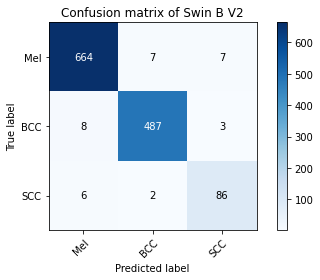

In [ ]:
plot_confusion_matrix(running_labels, running_preds, ['Mel', 'BCC', 'SCC'],
                          normalize=False,
                          title='Confusion matrix of Swin B V2',
                          cmap=plt.cm.Blues)

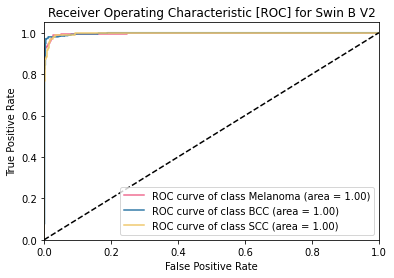

{0: 0.9957595870206489, 1: 0.99637279688703, 2: 0.9965534085974815}

In [ ]:
probas = np.vstack(outputs_all)

plot_roc(running_labels, probas, True, 'Swin B V2')

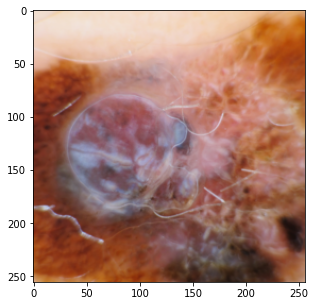

Actual: 0, predicted: 0


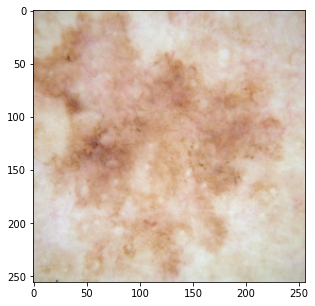

Actual: 0, predicted: 0


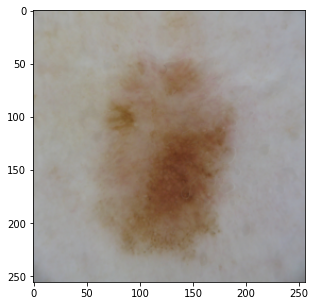

Actual: 0, predicted: 0


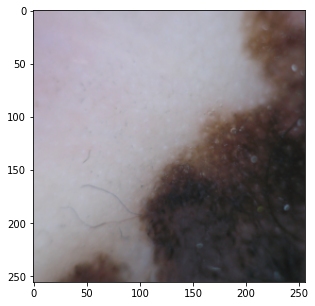

Actual: 0, predicted: 0


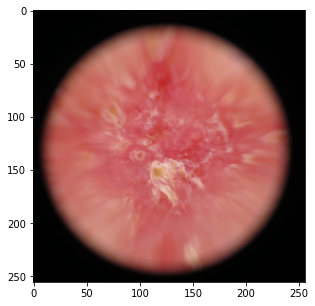

Actual: 1, predicted: 1


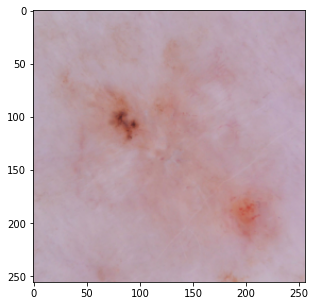

Actual: 1, predicted: 1


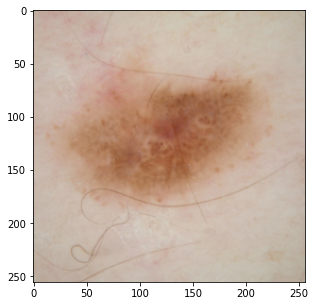

Actual: 0, predicted: 0


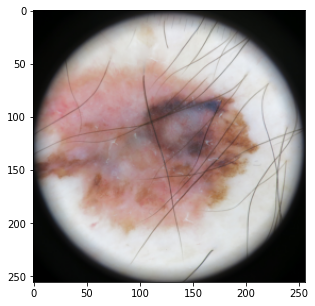

Actual: 0, predicted: 0


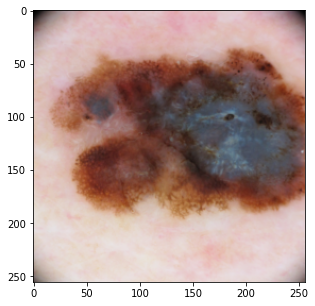

Actual: 0, predicted: 0


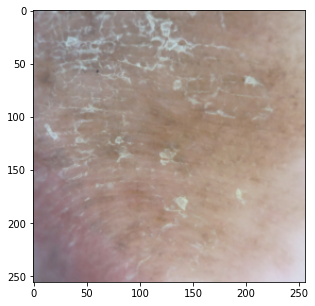

Actual: 0, predicted: 0


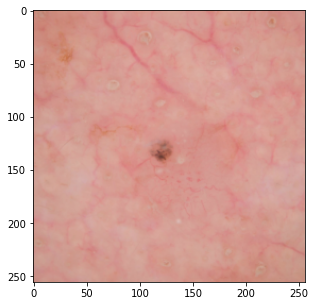

Actual: 1, predicted: 1


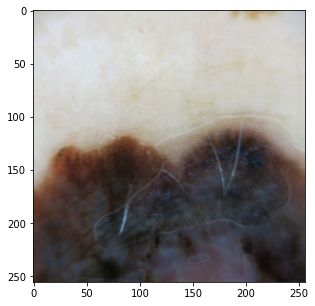

Actual: 0, predicted: 0


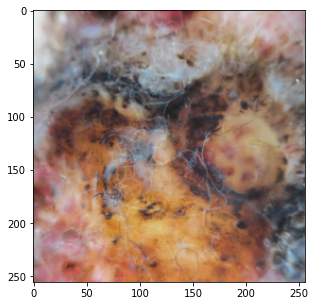

Actual: 0, predicted: 0


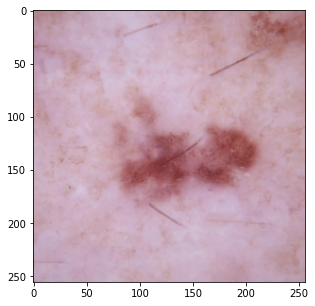

Actual: 2, predicted: 2


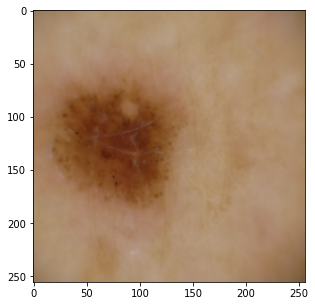

Actual: 0, predicted: 0


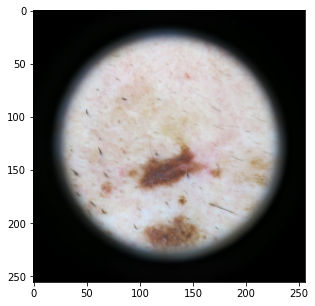

Actual: 0, predicted: 0


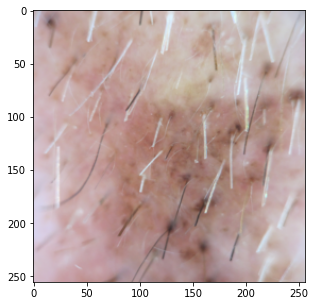

Actual: 0, predicted: 0


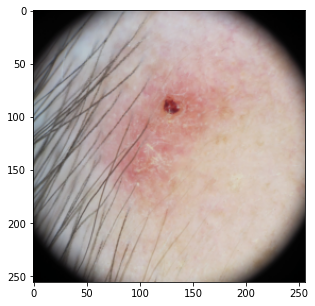

Actual: 1, predicted: 1


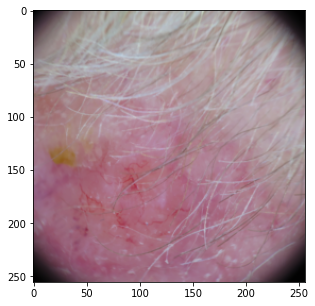

Actual: 1, predicted: 1


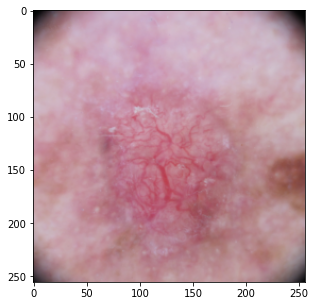

Actual: 1, predicted: 1


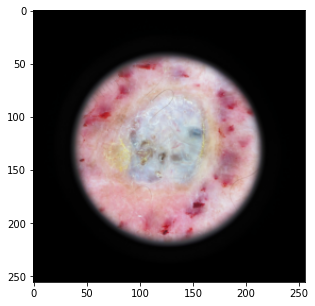

Actual: 1, predicted: 0


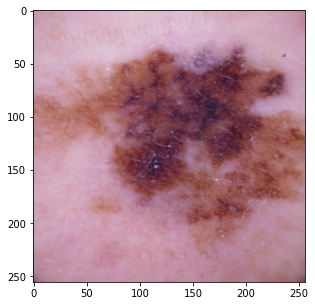

Actual: 0, predicted: 0


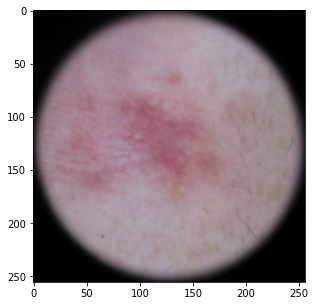

Actual: 1, predicted: 1


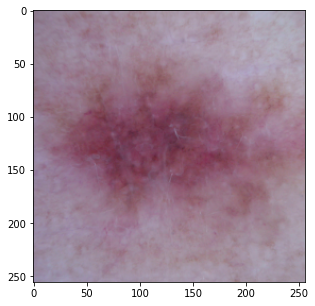

Actual: 0, predicted: 0


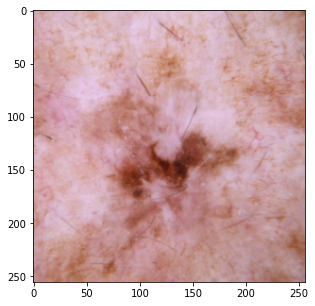

Actual: 2, predicted: 2


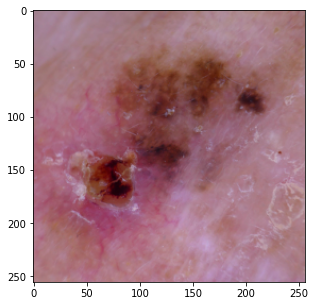

Actual: 0, predicted: 0


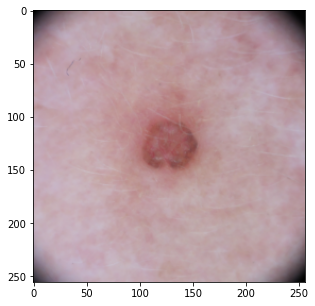

Actual: 1, predicted: 1


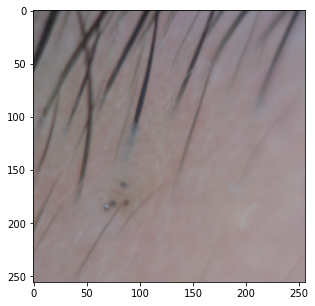

Actual: 1, predicted: 1


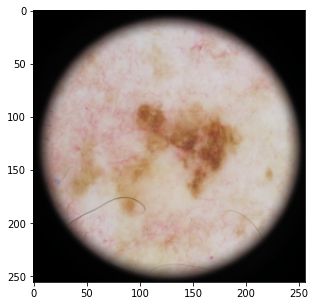

Actual: 0, predicted: 0


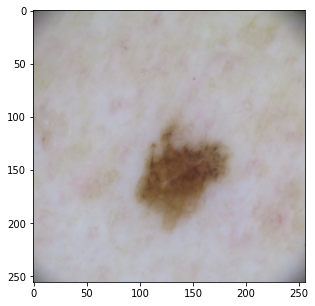

Actual: 0, predicted: 0


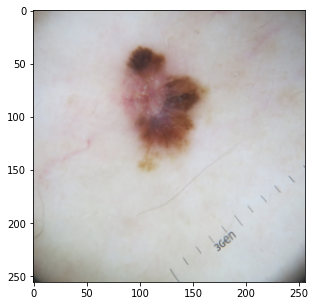

Actual: 0, predicted: 0


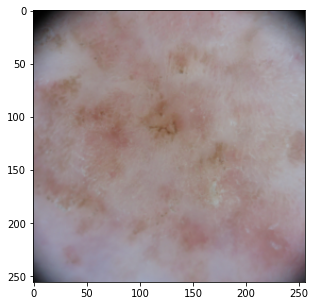

Actual: 2, predicted: 2


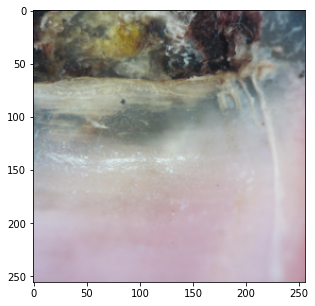

Actual: 0, predicted: 0


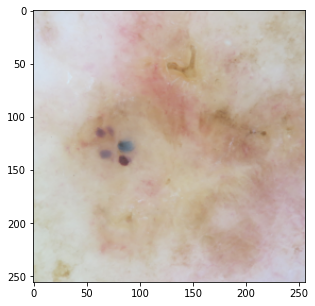

Actual: 1, predicted: 1


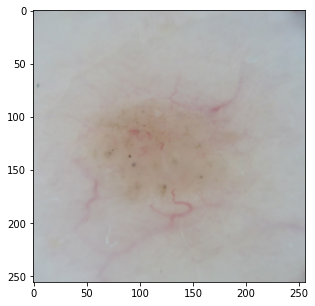

Actual: 1, predicted: 1


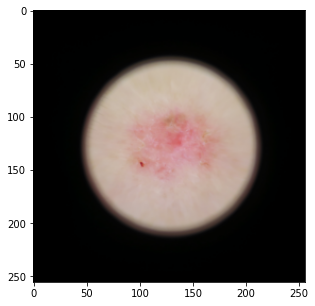

Actual: 1, predicted: 1


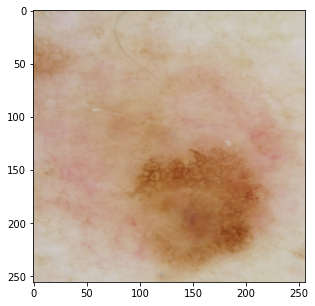

Actual: 0, predicted: 0


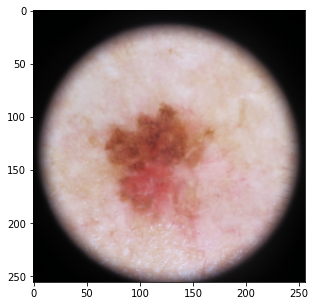

Actual: 0, predicted: 0


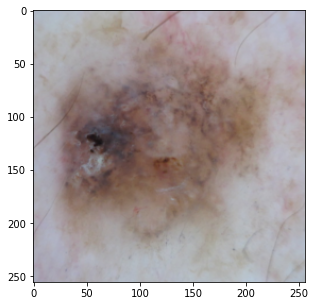

Actual: 0, predicted: 0


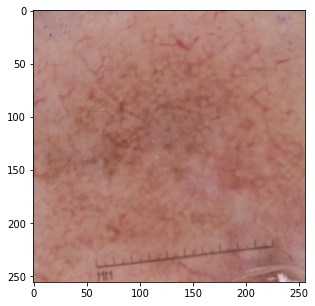

Actual: 0, predicted: 0


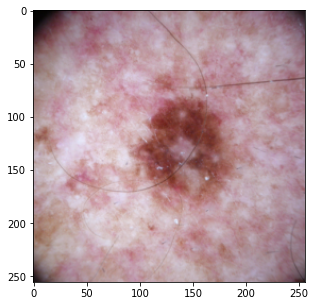

Actual: 0, predicted: 0


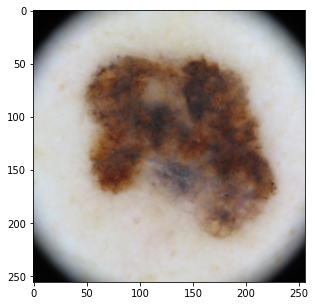

Actual: 0, predicted: 0


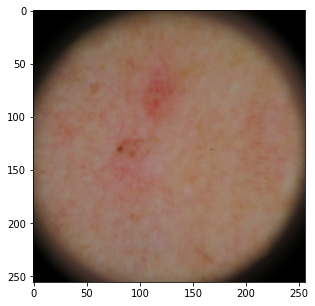

Actual: 1, predicted: 1


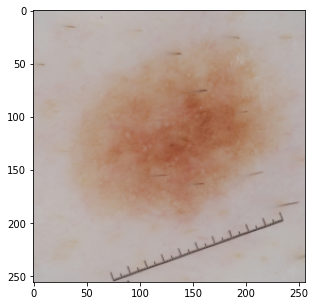

Actual: 0, predicted: 0


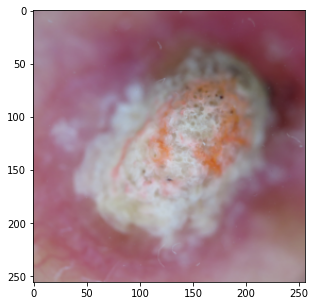

Actual: 2, predicted: 2


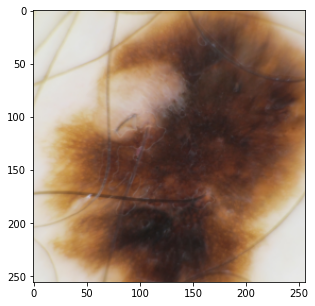

Actual: 0, predicted: 0


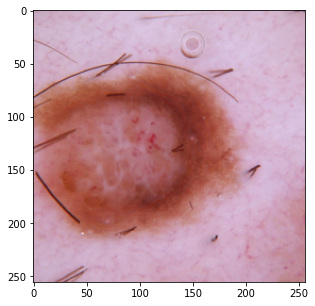

Actual: 0, predicted: 0


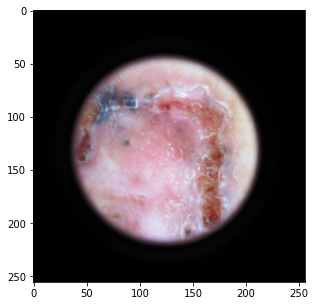

Actual: 1, predicted: 1


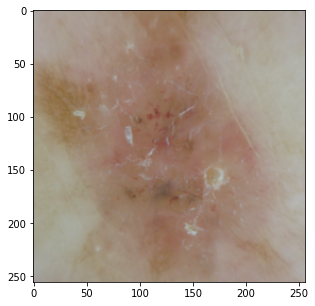

Actual: 1, predicted: 1


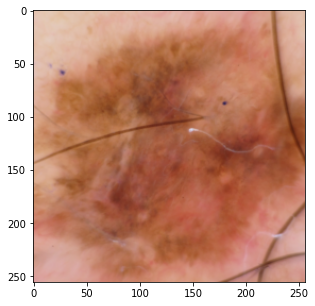

Actual: 0, predicted: 0


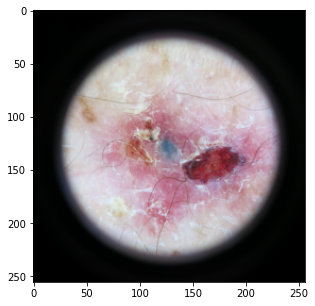

Actual: 1, predicted: 1


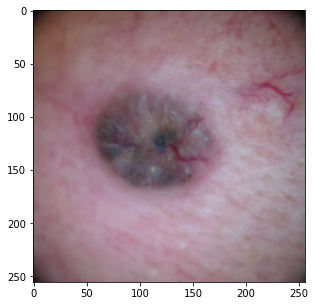

Actual: 1, predicted: 1


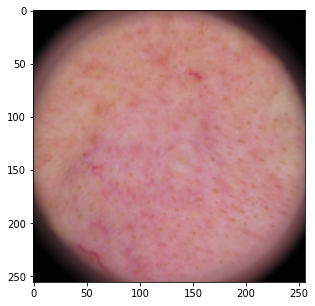

Actual: 1, predicted: 1


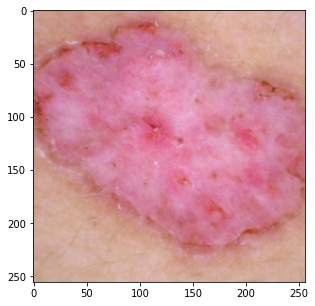

Actual: 1, predicted: 1


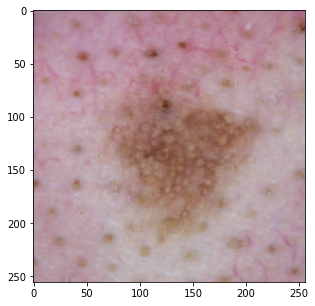

Actual: 0, predicted: 0


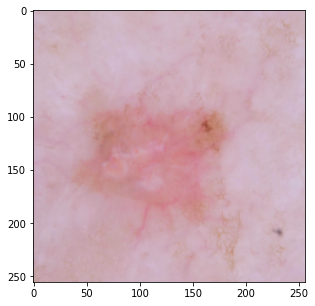

Actual: 2, predicted: 2


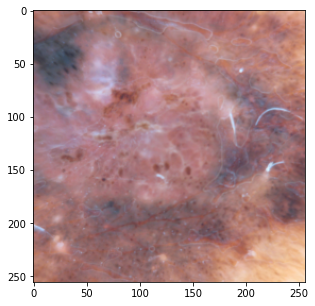

Actual: 0, predicted: 0


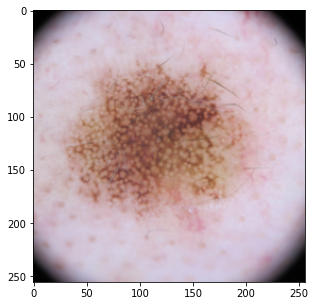

Actual: 0, predicted: 0


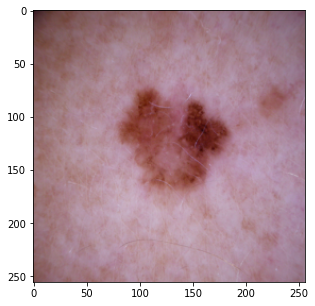

Actual: 0, predicted: 0


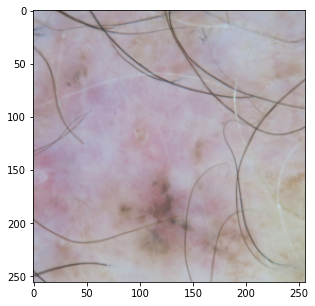

Actual: 1, predicted: 1


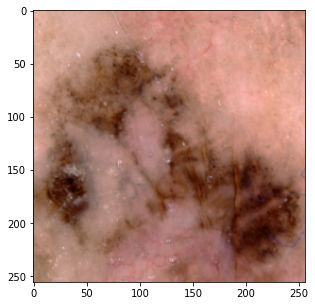

Actual: 0, predicted: 0


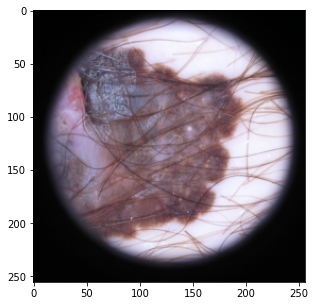

Actual: 0, predicted: 0


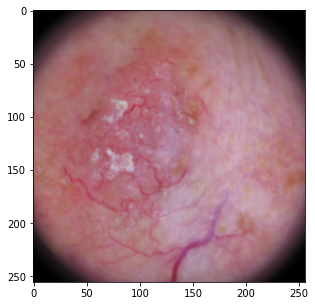

Actual: 1, predicted: 1


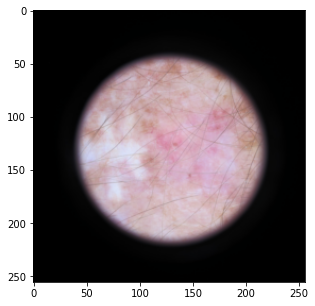

Actual: 1, predicted: 1


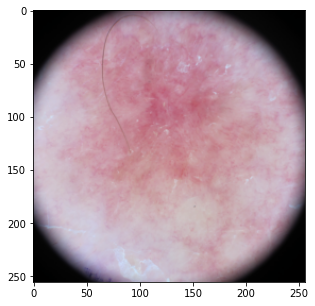

Actual: 1, predicted: 1


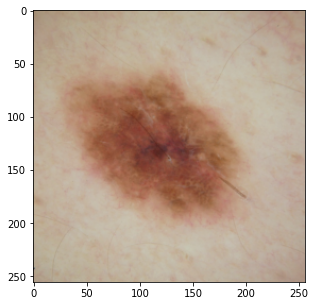

Actual: 0, predicted: 0


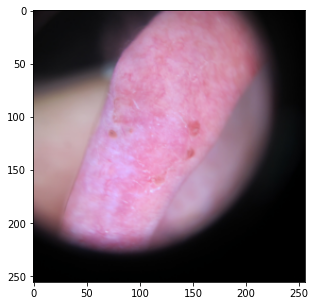

Actual: 1, predicted: 1


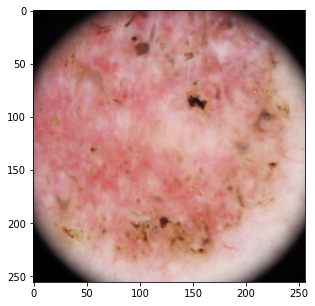

Actual: 1, predicted: 1


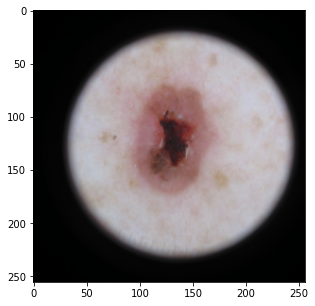

Actual: 1, predicted: 1


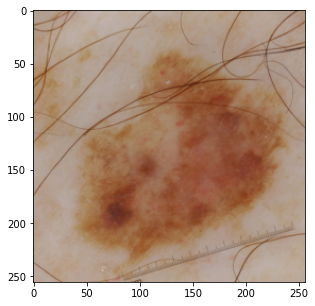

Actual: 0, predicted: 0


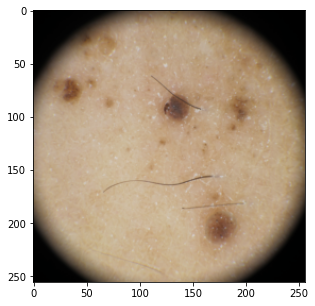

Actual: 1, predicted: 1


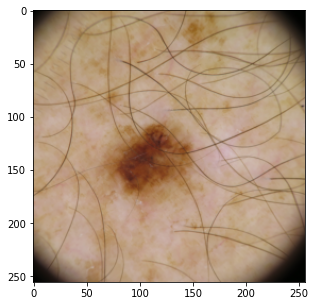

Actual: 0, predicted: 0


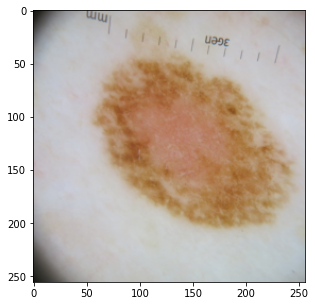

Actual: 0, predicted: 0


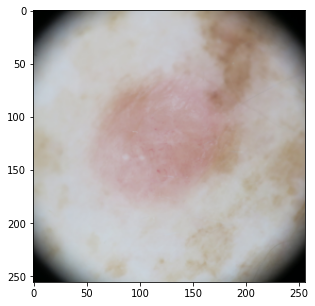

Actual: 0, predicted: 2


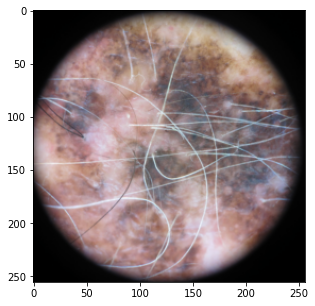

Actual: 0, predicted: 0


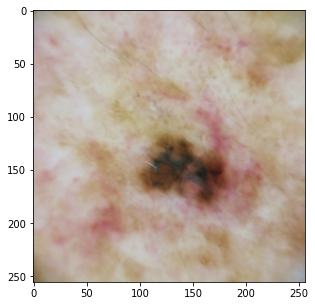

Actual: 0, predicted: 0


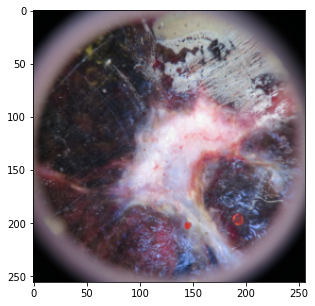

Actual: 0, predicted: 0


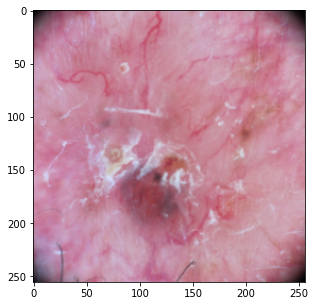

Actual: 1, predicted: 1


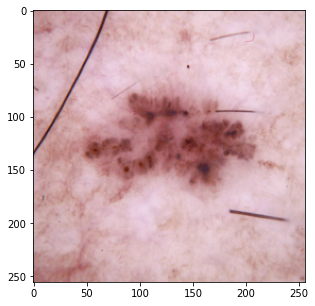

Actual: 1, predicted: 1


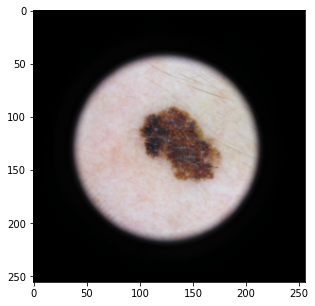

Actual: 0, predicted: 0


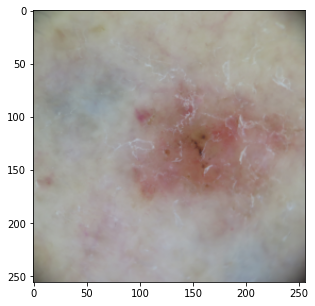

Actual: 1, predicted: 1


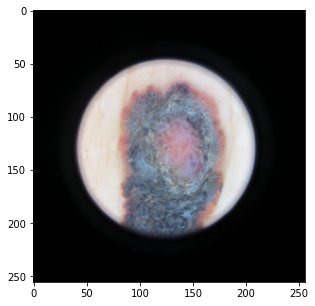

Actual: 0, predicted: 0


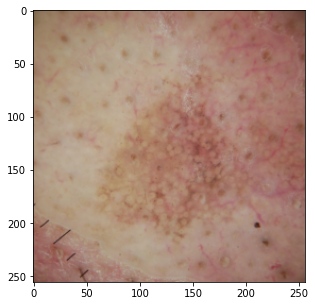

Actual: 0, predicted: 0


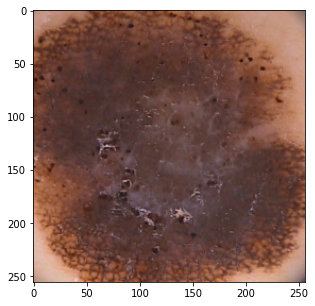

Actual: 0, predicted: 0


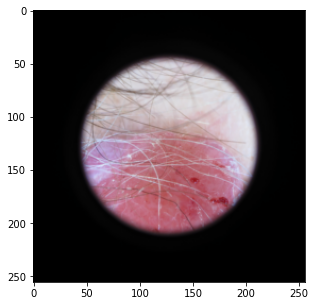

Actual: 0, predicted: 2


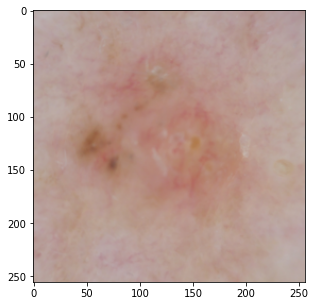

Actual: 1, predicted: 1


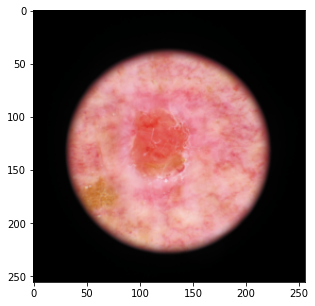

Actual: 1, predicted: 1


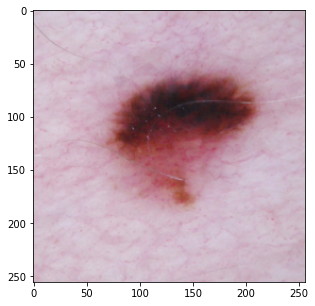

Actual: 0, predicted: 0


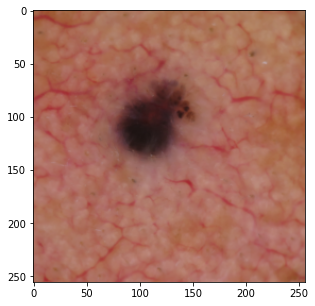

Actual: 1, predicted: 1


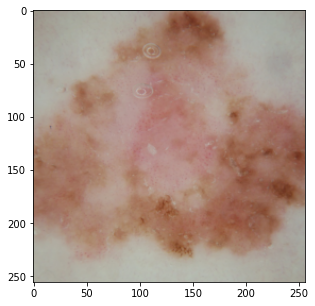

Actual: 0, predicted: 0


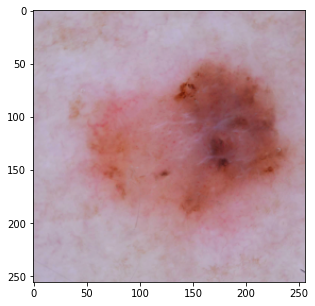

Actual: 0, predicted: 0


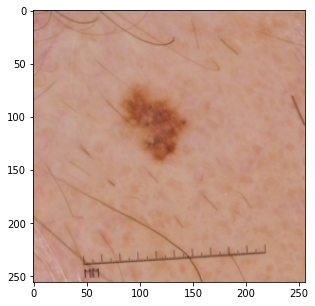

Actual: 0, predicted: 0


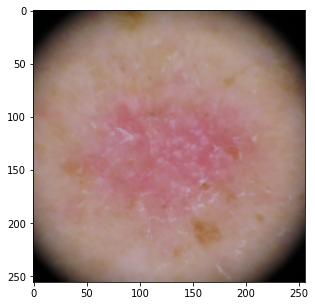

Actual: 1, predicted: 1


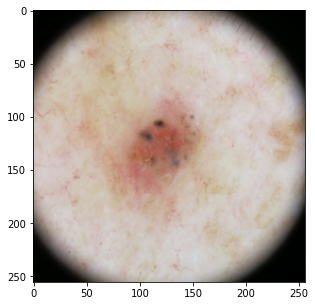

Actual: 1, predicted: 1


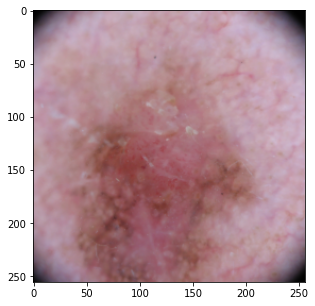

Actual: 0, predicted: 0


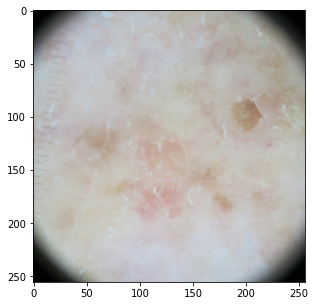

Actual: 2, predicted: 2


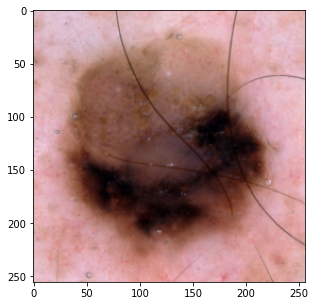

Actual: 0, predicted: 0


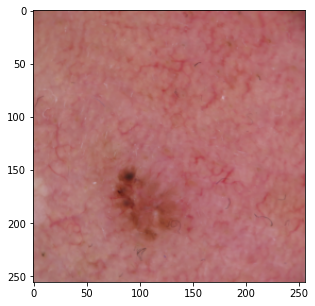

Actual: 1, predicted: 1


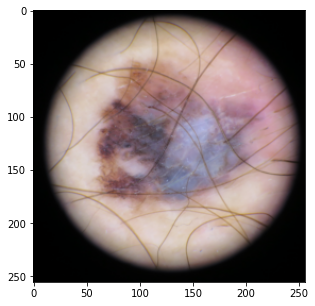

Actual: 0, predicted: 0


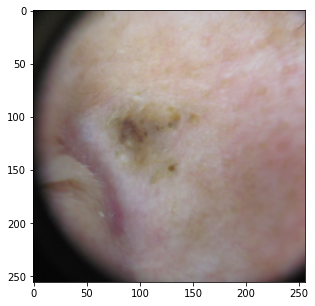

Actual: 1, predicted: 1


In [ ]:
visualize_model(swin_best, val_loader_shuff, DEVICE, num_images=100)

## Ensembles 

In [ ]:
swin_1 = make_swin_s(False, DEVICE)
swin_1.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_ce_best.pth'))

<All keys matched successfully>

In [ ]:
swin_2 = make_swin_v2(False, DEVICE)
swin_2.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_v2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
swin_3 = make_swin_v2_b(False, DEVICE)
swin_3.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce_best.pth'))

<All keys matched successfully>

In [ ]:
swin_4 = make_swin(False, DEVICE)
swin_4.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_ce_best.pth'))

<All keys matched successfully>

In [ ]:
efficientnet = make_efficientnet(False, DEVICE)
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce_sampling_best.pth'))

<All keys matched successfully>

In [ ]:
resnet = make_resnet(False, DEVICE)
resnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/resnet_best.pth'))

<All keys matched successfully>

### Soft

#### Swin 1 + 2 + 3 + 4

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
swin_4.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs_4 = swin_4(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3 + outputs_4) / 4.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [01:06<00:00,  3.35s/it]

Test Acc: 0.9764, kappa: 0.9575
Testing complete in 1m 7s


#### Swin 1 + 2 + 3

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:52<00:00,  2.64s/it]

Test Acc: 0.9780, kappa: 0.9603
Testing complete in 0m 53s


#### Swin 2 + 3 

In [ ]:
since = time.time()

swin_2.eval()
swin_3.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_2 + outputs_3) / 2.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:41<00:00,  2.07s/it]

Test Acc: 0.9756, kappa: 0.9561
Testing complete in 0m 41s


#### Swin 2 + 3 + EfficientNet

In [ ]:
since = time.time()

swin_3.eval()
swin_2.eval()
efficientnet.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = efficientnet(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:41<00:00,  2.06s/it]

Test Acc: 0.9787, kappa: 0.9618
Testing complete in 0m 41s


#### Swin 1 + 2 + 3 + EfficientNet

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
efficientnet.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs_4 = efficientnet(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3 + outputs_4) / 4.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:58<00:00,  2.92s/it]

Test Acc: 0.9772, kappa: 0.9589
Testing complete in 0m 58s


#### Swin 2 + 3 + ResNet

In [ ]:
since = time.time()

swin_3.eval()
swin_2.eval()
resnet.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = resnet(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:51<00:00,  2.56s/it]

Test Acc: 0.9764, kappa: 0.9575
Testing complete in 0m 51s


#### Swin 1 + 2 + 3 + ResNet

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
resnet.eval()

running_labels = []
running_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs_4 = resnet(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3 + outputs_4) / 4.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:57<00:00,  2.89s/it]

Test Acc: 0.9780, kappa: 0.9603
Testing complete in 0m 58s


### Hard

#### Swin 1 + 2 + 3 + 4

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
swin_4.eval()

running_labels = []
swin_1_preds = []
swin_2_preds = []
swin_3_preds = []
swin_4_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        _, preds = torch.max(outputs_1, 1)
        swin_1_preds = swin_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()

        outputs_4 = swin_4(inputs)
        _, preds = torch.max(outputs_4, 1)
        swin_4_preds = swin_4_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([swin_1_preds, swin_2_preds, swin_3_preds, swin_4_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [01:03<00:00,  3.16s/it]

Test Acc: 0.9764, kappa: 0.9576
Testing complete in 1m 3s


#### Swin 1 + 2 + 3

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()

running_labels = []
swin_1_preds = []
swin_2_preds = []
swin_3_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        _, preds = torch.max(outputs_1, 1)
        swin_1_preds = swin_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([swin_1_preds, swin_2_preds, swin_3_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:54<00:00,  2.73s/it]

Test Acc: 0.9756, kappa: 0.9561
Testing complete in 0m 55s


#### Swin 2 + 3 

In [ ]:
since = time.time()

swin_2.eval()
swin_3.eval()

running_labels = []
swin_2_preds = []
swin_3_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([swin_2_preds, swin_3_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:42<00:00,  2.12s/it]

Test Acc: 0.9740, kappa: 0.9535
Testing complete in 0m 43s


#### Swin 2 + 3 + EfficientNet

In [ ]:
since = time.time()

efficientnet.eval()
swin_2.eval()
swin_3.eval()

running_labels = []
efficientnet_1_preds = []
swin_2_preds = []
swin_3_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = efficientnet(inputs)
        _, preds = torch.max(outputs_1, 1)
        efficientnet_1_preds = efficientnet_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([efficientnet_1_preds, swin_2_preds, swin_3_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:43<00:00,  2.18s/it]

Test Acc: 0.9748, kappa: 0.9548
Testing complete in 0m 44s


####Swin 1 + 2 + 3 + EfficientNet

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
efficientnet.eval()

running_labels = []
swin_1_preds = []
swin_2_preds = []
swin_3_preds = []
efficientnet_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        _, preds = torch.max(outputs_1, 1)
        swin_1_preds = swin_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()

        outputs_4 = efficientnet(inputs)
        _, preds = torch.max(outputs_4, 1)
        efficientnet_preds = efficientnet_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([swin_1_preds, swin_2_preds, swin_3_preds, efficientnet_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:57<00:00,  2.86s/it]

Test Acc: 0.9732, kappa: 0.9520
Testing complete in 0m 57s


#### Swin 2 + 3 + ResNet

In [ ]:
since = time.time()

resnet.eval()
swin_2.eval()
swin_3.eval()

running_labels = []
resnet_1_preds = []
swin_2_preds = []
swin_3_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = resnet(inputs)
        _, preds = torch.max(outputs_1, 1)
        resnet_1_preds = resnet_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([resnet_1_preds, swin_2_preds, swin_3_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [00:59<00:00,  2.96s/it]

Test Acc: 0.9764, kappa: 0.9575
Testing complete in 0m 59s


####Swin 1 + 2 + 3 + ResNet

In [ ]:
since = time.time()

swin_1.eval()
swin_2.eval()
swin_3.eval()
resnet.eval()

running_labels = []
swin_1_preds = []
swin_2_preds = []
swin_3_preds = []
resnet_preds = []

# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = swin_1(inputs)
        _, preds = torch.max(outputs_1, 1)
        swin_1_preds = swin_1_preds + preds.int().cpu().tolist()

        outputs_2 = swin_2(inputs)
        _, preds = torch.max(outputs_2, 1)
        swin_2_preds = swin_2_preds + preds.int().cpu().tolist()

        outputs_3 = swin_3(inputs)
        _, preds = torch.max(outputs_3, 1)
        swin_3_preds = swin_3_preds + preds.int().cpu().tolist()

        outputs_4 = resnet(inputs)
        _, preds = torch.max(outputs_4, 1)
        resnet_preds = resnet_preds + preds.int().cpu().tolist()
        
        running_labels = running_labels + labels.int().cpu().tolist()
        
    preds = np.transpose(np.array([swin_1_preds, swin_2_preds, swin_3_preds, resnet_preds]))
    running_preds = [Counter(sorted(row, reverse=True)).most_common(1)[0][0] for row in preds]
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [01:06<00:00,  3.30s/it]

Test Acc: 0.9748, kappa: 0.9547
Testing complete in 1m 6s


# Best Pipeline

## Visualization

In [ ]:
swin_2 = make_swin_v2(False, DEVICE)
swin_2.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_s_v2_ce_best.pth'))

swin_3 = make_swin_v2_b(False, DEVICE)
swin_3.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/swin_b_v2_ce_best.pth'))

efficientnet = make_efficientnet(False, DEVICE)
efficientnet.load_state_dict(torch.load('/content/drive/MyDrive/CAD_DL_TB/checkpoints/efficientnet_ce_sampling_best.pth'))

<All keys matched successfully>

In [ ]:
since = time.time()

swin_3.eval()
swin_2.eval()
efficientnet.eval()

running_labels = []
running_preds = []
outputs_all = []
# Iterate over data.
with torch.no_grad():
    for batch in tqdm(val_loader):
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = efficientnet(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
        _, preds = torch.max(outputs, 1)
        
        running_labels = running_labels + labels.int().cpu().tolist()
        running_preds = running_preds + preds.int().cpu().tolist()
        probas = F.softmax(outputs, dim=1)
        outputs_all.append(probas.cpu().numpy())
  
    test_kappa = cohen_kappa_score(running_labels, running_preds)
    test_acc = accuracy_score(running_labels, running_preds)
    print(f'Test Acc: {test_acc:.4f}, kappa: {test_kappa:.4f}')

    time_elapsed = time.time() - since
    print(f'Testing complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

100%|██████████| 20/20 [03:58<00:00, 11.90s/it]

Test Acc: 0.9787, kappa: 0.9618
Testing complete in 3m 58s


Confusion matrix, without normalization
[[667   5   6]
 [  7 489   2]
 [  4   3  87]]


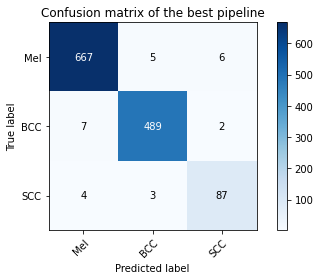

In [ ]:
plot_confusion_matrix(running_labels, running_preds, ['Mel', 'BCC', 'SCC'],
                          normalize=False,
                          title='Confusion matrix of the best pipeline',
                          cmap=plt.cm.Blues)

In [ ]:
probas = np.vstack(outputs_all)

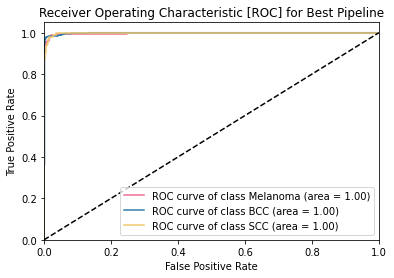

{0: 0.9967711073905764, 1: 0.998034885656616, 2: 0.9983355044145317}

In [ ]:
plot_roc(running_labels, probas, True, 'Best Pipeline')

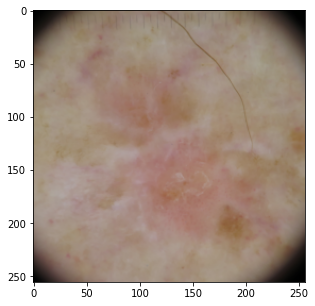

Actual: 2, predicted: 2


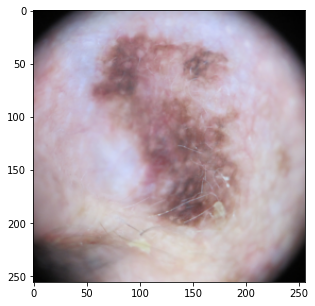

Actual: 0, predicted: 0


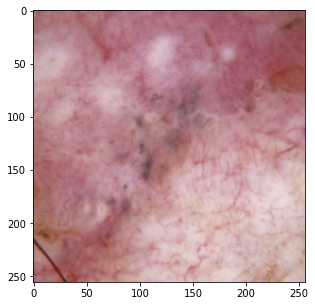

Actual: 1, predicted: 1


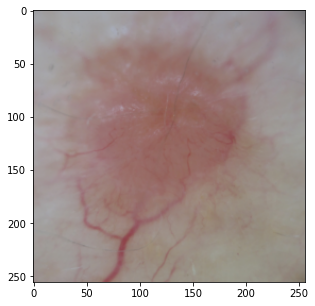

Actual: 1, predicted: 1


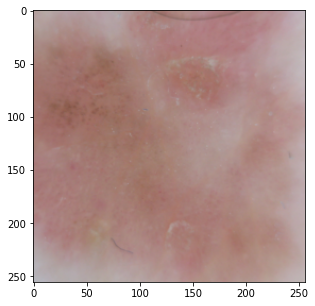

Actual: 2, predicted: 2


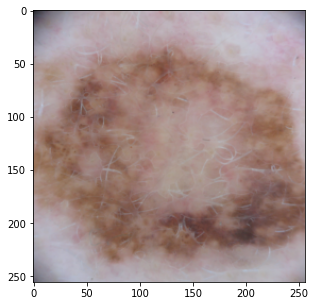

Actual: 0, predicted: 0


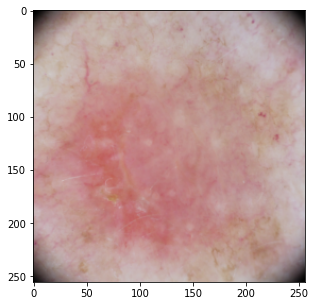

Actual: 1, predicted: 1


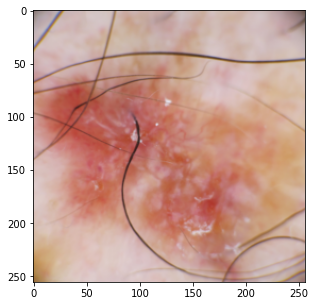

Actual: 1, predicted: 1


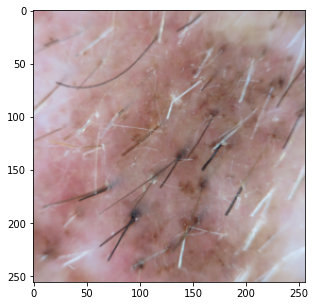

Actual: 0, predicted: 0


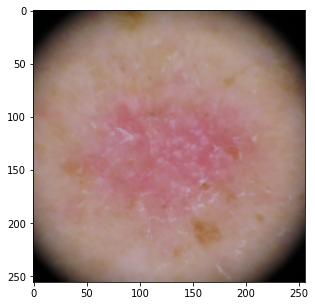

Actual: 1, predicted: 1


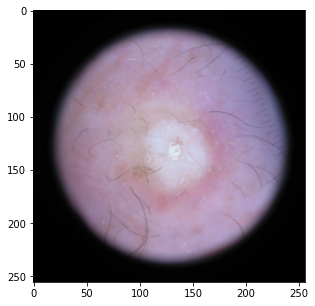

Actual: 2, predicted: 2


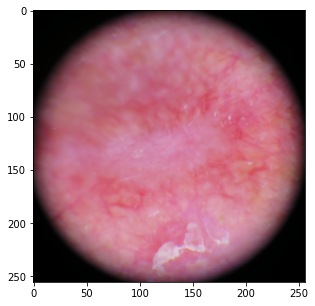

Actual: 1, predicted: 1


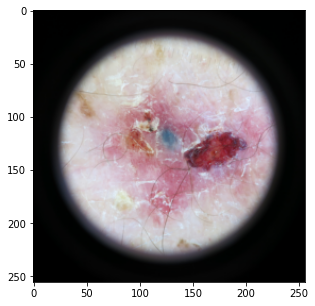

Actual: 1, predicted: 1


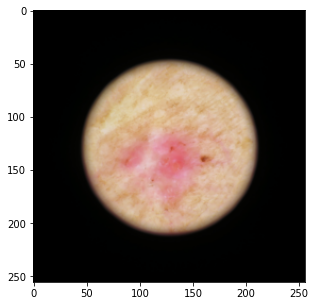

Actual: 1, predicted: 1


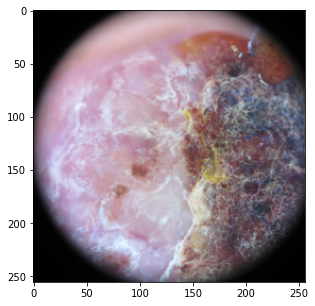

Actual: 0, predicted: 0


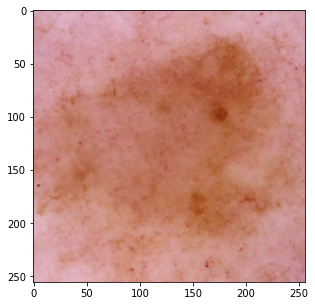

Actual: 0, predicted: 0


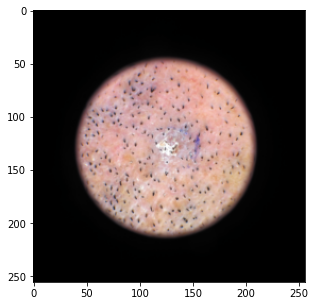

Actual: 1, predicted: 1


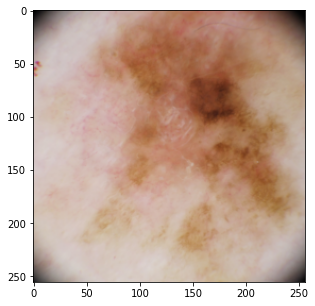

Actual: 0, predicted: 0


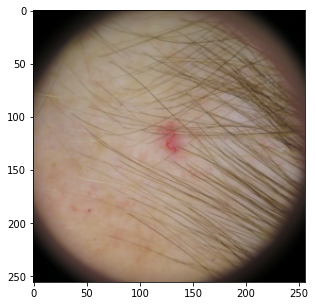

Actual: 1, predicted: 1


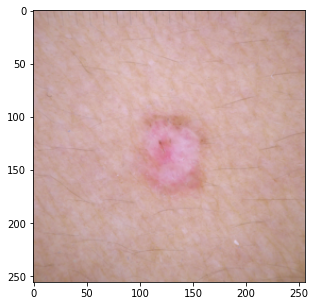

Actual: 1, predicted: 1


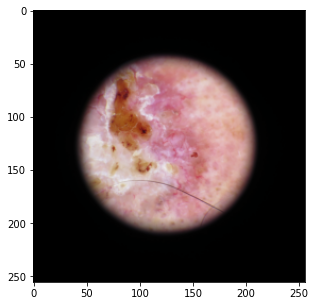

Actual: 1, predicted: 1


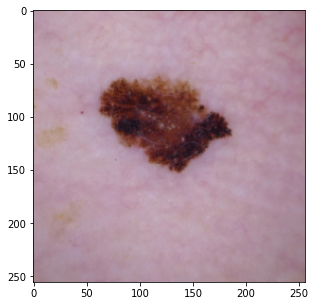

Actual: 0, predicted: 0


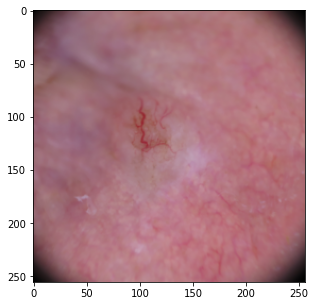

Actual: 1, predicted: 1


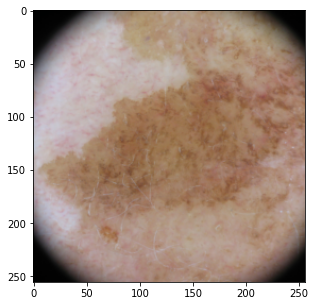

Actual: 0, predicted: 0


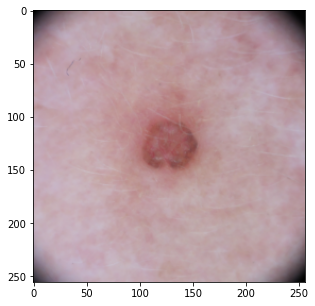

Actual: 1, predicted: 1


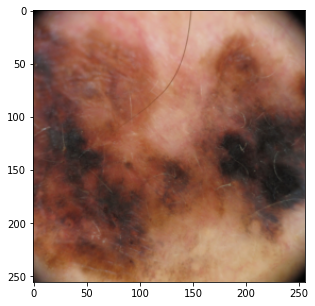

Actual: 0, predicted: 0


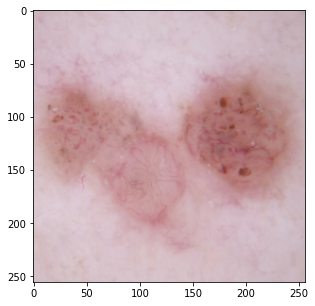

Actual: 1, predicted: 1


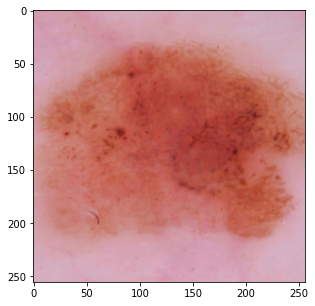

Actual: 0, predicted: 0


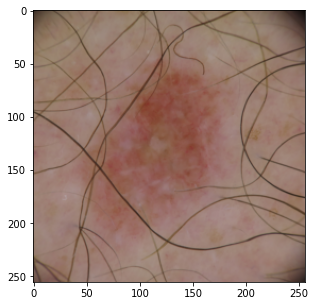

Actual: 0, predicted: 0


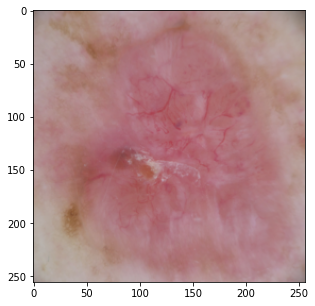

Actual: 1, predicted: 1


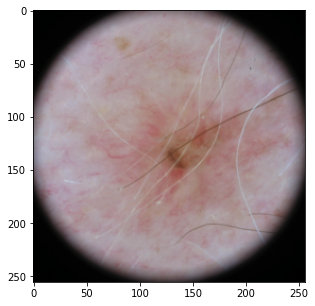

Actual: 1, predicted: 1


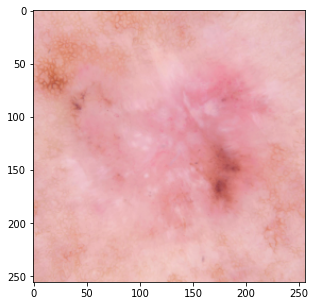

Actual: 1, predicted: 1


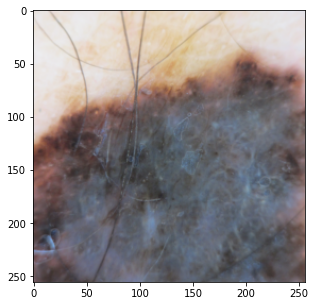

Actual: 0, predicted: 0


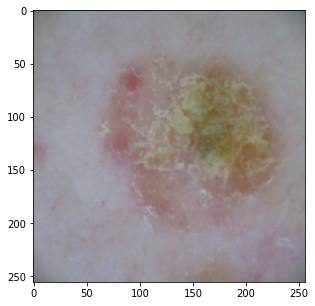

Actual: 2, predicted: 2


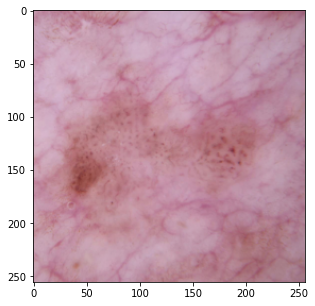

Actual: 2, predicted: 2


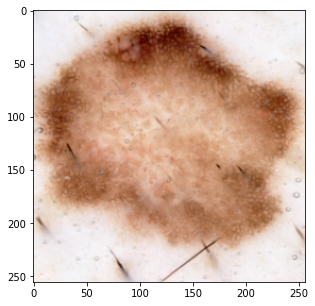

Actual: 0, predicted: 0


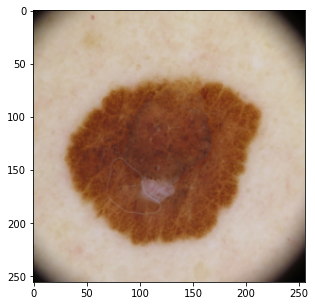

Actual: 0, predicted: 0


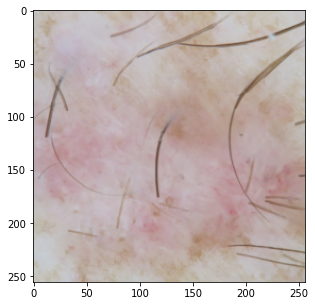

Actual: 1, predicted: 1


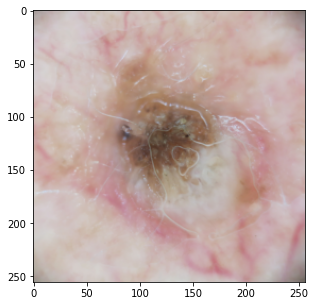

Actual: 2, predicted: 2


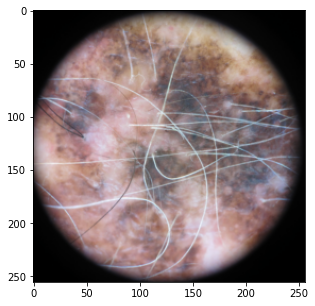

Actual: 0, predicted: 0


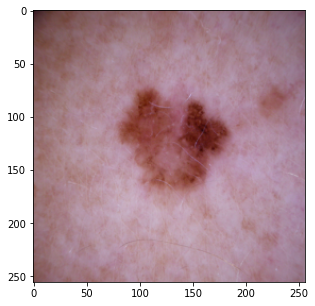

Actual: 0, predicted: 0


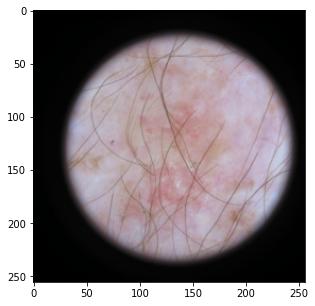

Actual: 1, predicted: 1


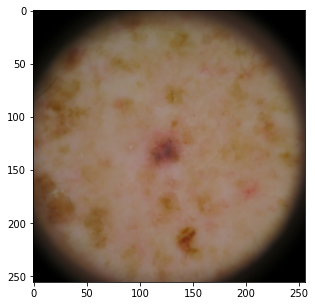

Actual: 1, predicted: 1


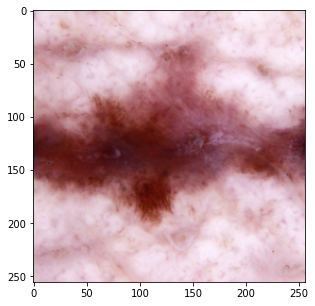

Actual: 0, predicted: 0


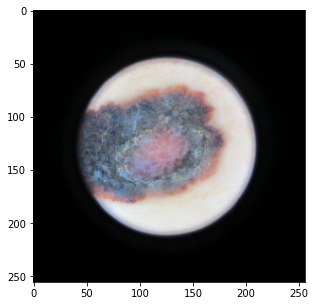

Actual: 0, predicted: 0


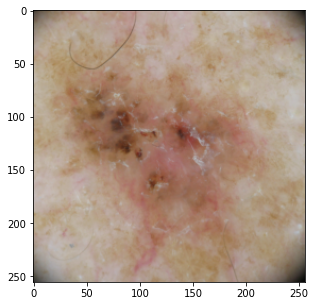

Actual: 1, predicted: 1


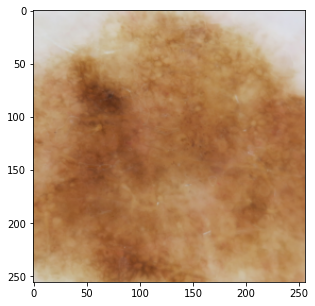

Actual: 0, predicted: 0


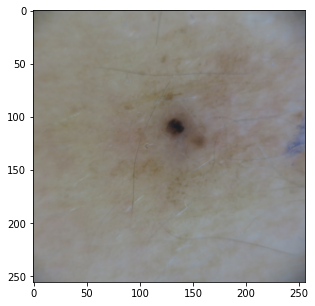

Actual: 1, predicted: 1


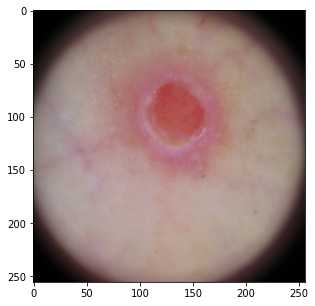

Actual: 1, predicted: 1


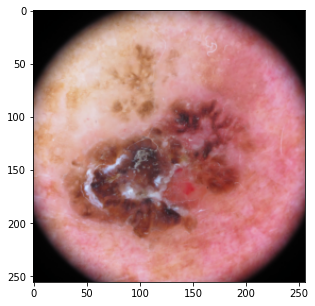

Actual: 2, predicted: 0


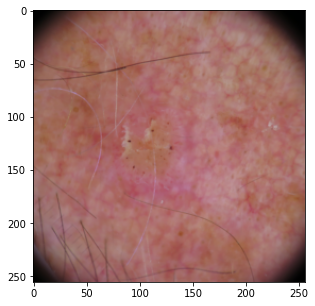

Actual: 0, predicted: 2


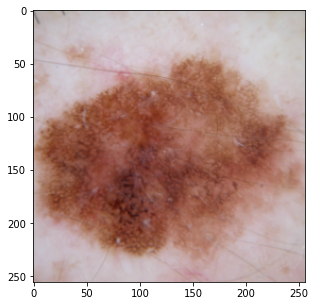

Actual: 0, predicted: 0


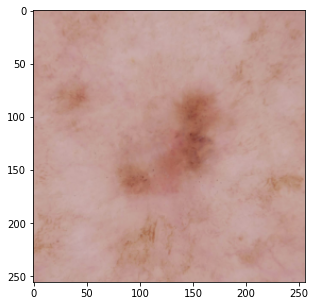

Actual: 2, predicted: 2


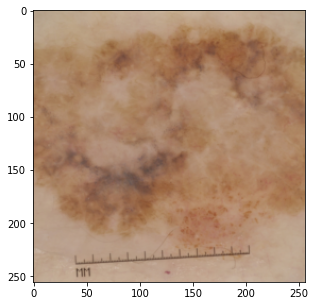

Actual: 0, predicted: 0


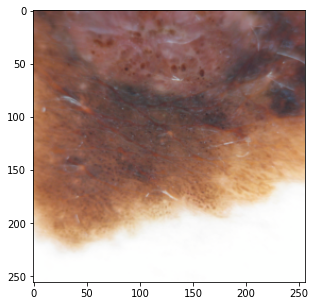

Actual: 0, predicted: 0


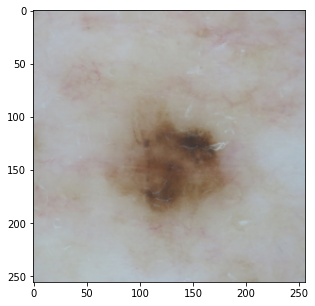

Actual: 0, predicted: 0


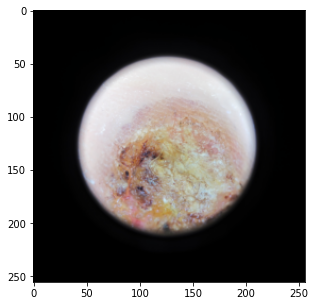

Actual: 0, predicted: 0


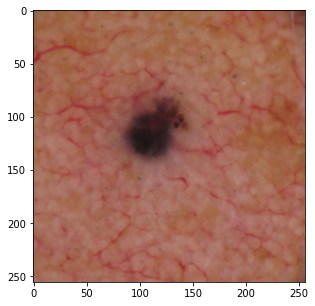

Actual: 1, predicted: 1


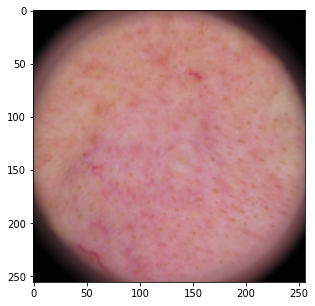

Actual: 1, predicted: 1


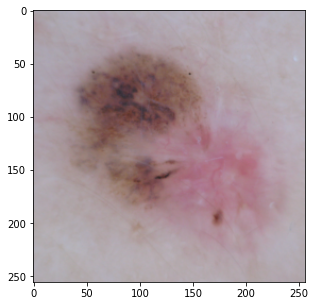

Actual: 0, predicted: 0


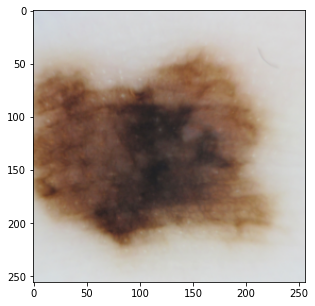

Actual: 0, predicted: 0


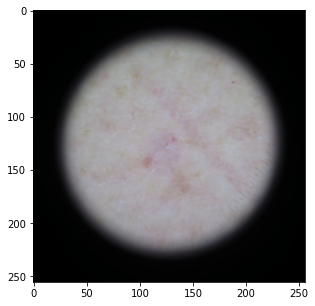

Actual: 1, predicted: 1


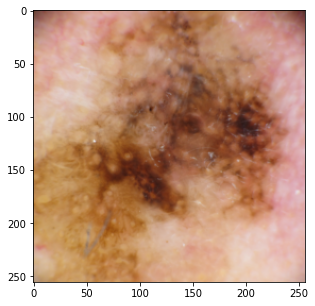

Actual: 0, predicted: 0


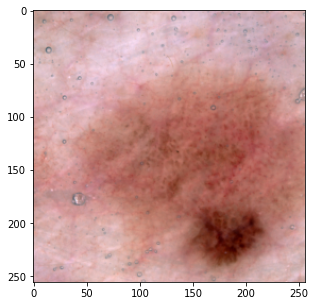

Actual: 0, predicted: 0


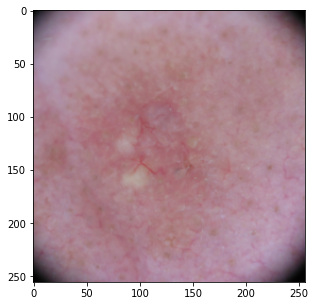

Actual: 1, predicted: 1


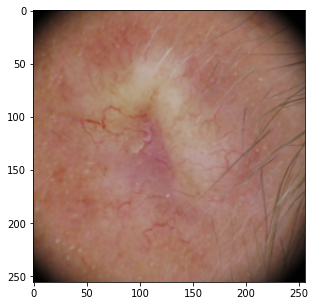

Actual: 1, predicted: 1


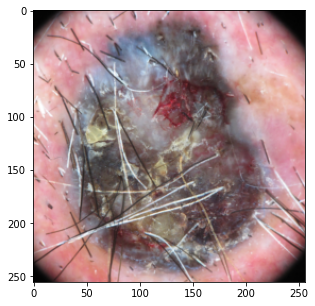

Actual: 0, predicted: 0


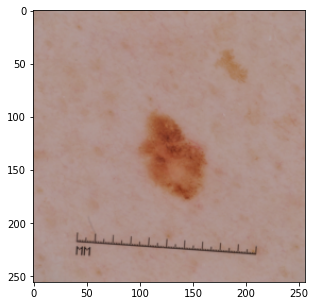

Actual: 0, predicted: 0


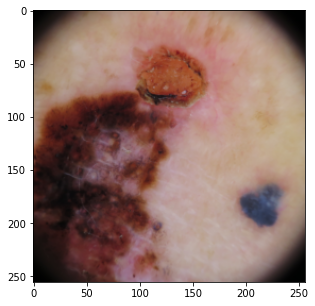

Actual: 0, predicted: 0


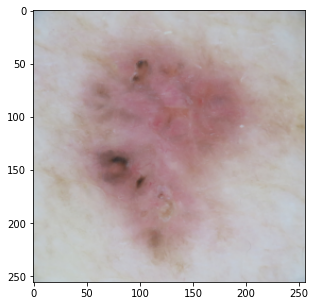

Actual: 1, predicted: 1


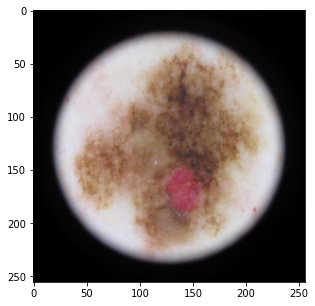

Actual: 0, predicted: 0


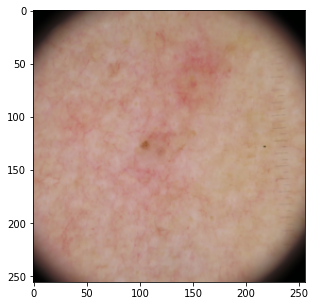

Actual: 1, predicted: 1


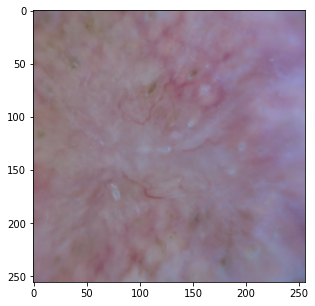

Actual: 1, predicted: 1


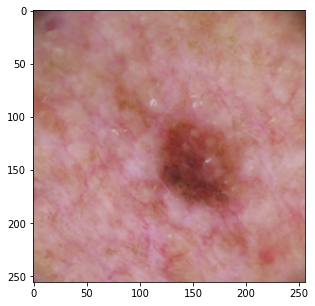

Actual: 0, predicted: 0


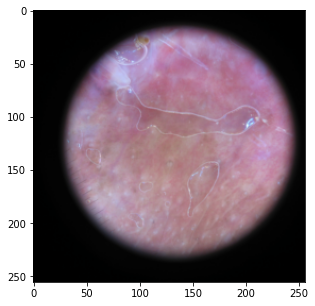

Actual: 0, predicted: 0


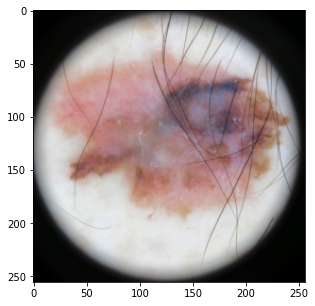

Actual: 0, predicted: 0


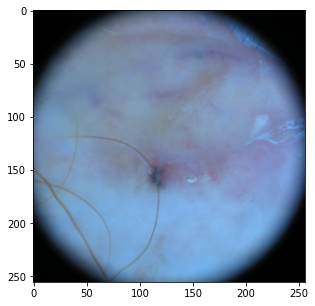

Actual: 0, predicted: 0


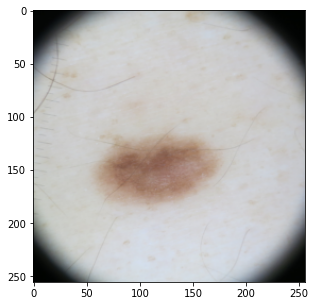

Actual: 0, predicted: 0


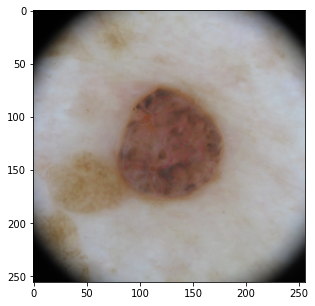

Actual: 1, predicted: 1


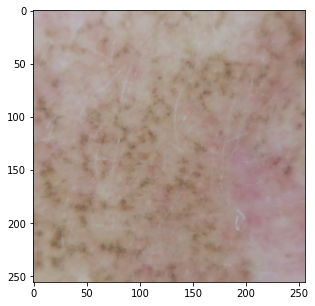

Actual: 0, predicted: 0


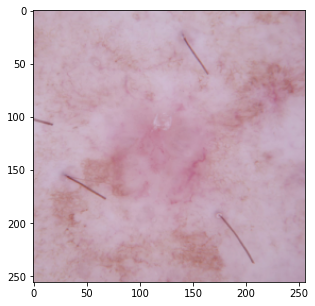

Actual: 1, predicted: 1


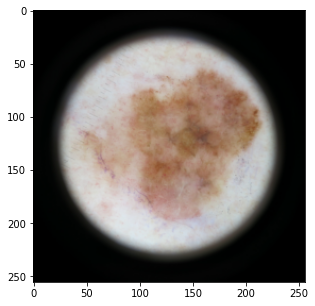

Actual: 0, predicted: 0


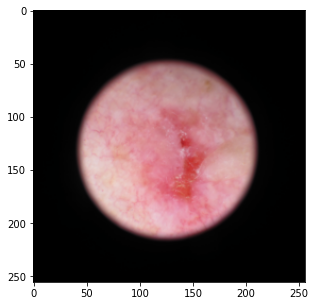

Actual: 1, predicted: 1


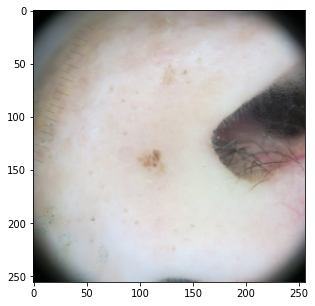

Actual: 1, predicted: 1


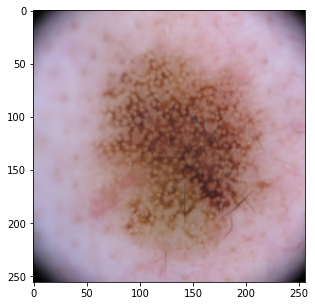

Actual: 0, predicted: 0


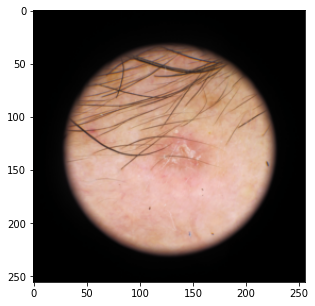

Actual: 1, predicted: 1


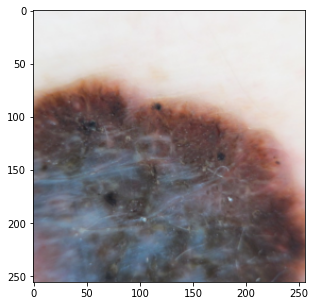

Actual: 0, predicted: 0


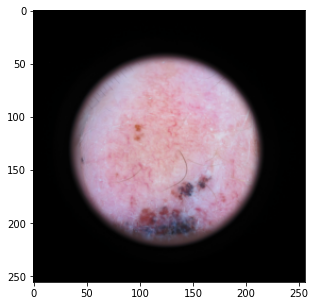

Actual: 0, predicted: 0


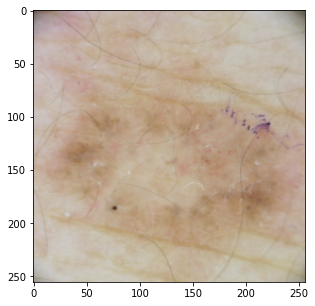

Actual: 1, predicted: 1


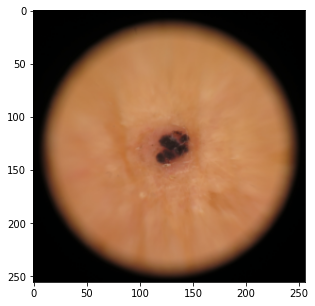

Actual: 1, predicted: 1


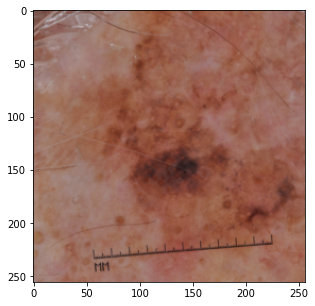

Actual: 0, predicted: 0


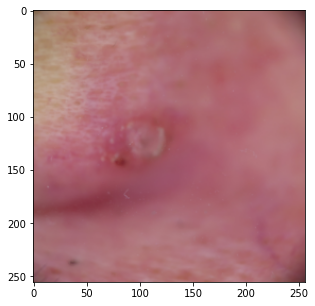

Actual: 1, predicted: 1


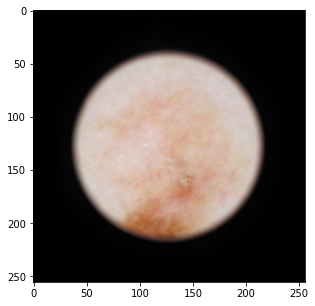

Actual: 0, predicted: 0


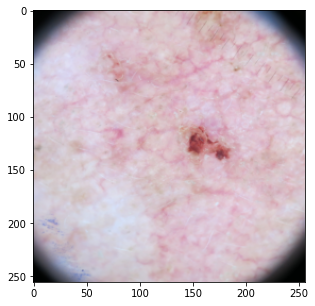

Actual: 1, predicted: 1


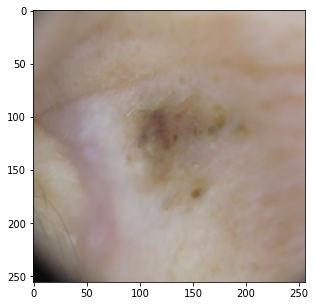

Actual: 1, predicted: 1


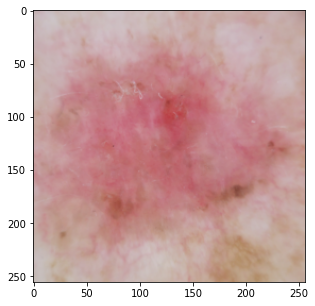

Actual: 1, predicted: 1


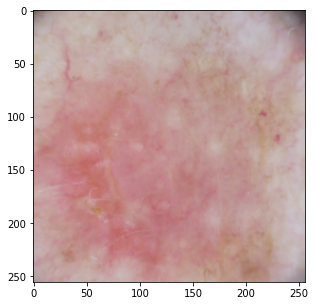

Actual: 1, predicted: 1


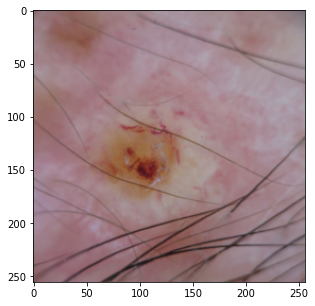

Actual: 1, predicted: 1


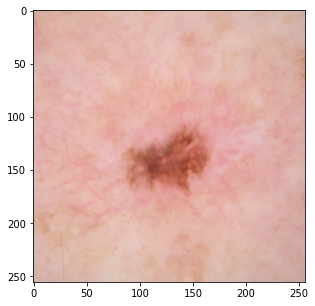

Actual: 0, predicted: 0


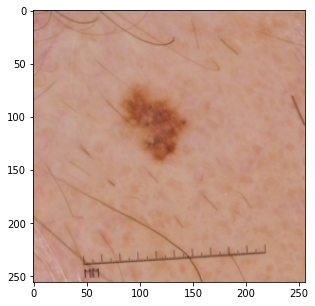

Actual: 0, predicted: 0


In [ ]:
num_images = 100

swin_3.eval()
swin_2.eval()
efficientnet.eval()
images_so_far = 0
with torch.no_grad():
    for batch in val_loader_shuff:
        inputs = batch["image"].to(DEVICE)
        labels = batch["label"].to(DEVICE)

        outputs_1 = efficientnet(inputs)
        outputs_2 = swin_2(inputs)
        outputs_3 = swin_3(inputs)
        outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
        _, preds = torch.max(outputs, 1)

        for j in range(inputs.size()[0]):
            images_so_far += 1
            fig = plt.figure(figsize=(5,5))

            imshow(inputs.cpu().data[j])
            print(f'Actual: {labels[j]}, predicted: {preds[j]}')
            plt.show()

            if images_so_far == num_images:
                break
        if images_so_far == num_images:
                break

## Test inference

In [ ]:
test_df = pd.read_csv(test_csv_path)
test_ids = []
test_preds = []
for i, row in test_df.iterrows():
  img_id = '/' + row['image_id'] # obtain image file name start 
  
  img_path = test_img_folder + img_id + '.jpg' # file path of the original image 
  image = Image.open(img_path)  # open the original image as RGB
  image = img_transforms(image).unsqueeze(0).to(DEVICE)

  outputs_1 = efficientnet(image)
  outputs_2 = swin_2(image)
  outputs_3 = swin_3(image)
  outputs = (outputs_1 + outputs_2 + outputs_3) / 3.0
  _, preds = torch.max(outputs, 1)
  test_preds = test_preds + preds.int().cpu().tolist()
  test_ids.append(img_id)
  print(f"Image {row['image_id']} done")

In [ ]:
test_dict = {'img_id': test_ids, 'prediction': test_preds}
test_inf_df = pd.DataFrame(test_dict)
test_inf_df.to_csv('/content/drive/MyDrive/CAD_Dataset/Challenge2/test_results_ch2_dl.csv')